# Sentiment Classification & How To "Frame Problems" for a Neural Network
Sentiment Analysis lecture for Deep Learning Nanodegree on Udacity . How to predict from text if its a positive or a negative reviews using neural networks.
Teacher Andrew Trask

- **Twitter**: @iamtrask
- **Blog**: http://iamtrask.github.io

### What You Should Already Know

- neural networks, forward and back-propagation
- stochastic gradient descent
- mean squared error
- and train/test splits

### Tutorial Outline:

- Intro: The Importance of "Framing a Problem" (this lesson)

- [Curate a Dataset](#lesson_1)
- [Developing a "Predictive Theory"](#lesson_2)
- [**PROJECT 1**: Quick Theory Validation](#project_1)


- [Transforming Text to Numbers](#lesson_3)
- [**PROJECT 2**: Creating the Input/Output Data](#project_2)


- Putting it all together in a Neural Network (video only - nothing in notebook)
- [**PROJECT 3**: Building our Neural Network](#project_3)


- [Understanding Neural Noise](#lesson_4)
- [**PROJECT 4**: Making Learning Faster by Reducing Noise](#project_4)


- [Analyzing Inefficiencies in our Network](#lesson_5)
- [**PROJECT 5**: Making our Network Train and Run Faster](#project_5)


- [Further Noise Reduction](#lesson_6)
- [**PROJECT 6**: Reducing Noise by Strategically Reducing the Vocabulary](#project_6)


- [Analysis: What's going on in the weights?](#lesson_7)

# Lesson: Curate a Dataset<a id='lesson_1'></a>


In [1]:
def pretty_print_review_and_label(i):
    print(labels[i] + "\t:\t" + reviews[i][:80] + "...")

g = open('reviews.txt','r') # What we know!
reviews = list(map(lambda x:x[:-1],g.readlines()))
g.close()

g = open('labels.txt','r') # What we WANT to know!
labels = list(map(lambda x:x[:-1].upper(),g.readlines()))
g.close()

**Note:** The data in `reviews.txt` we're using has already been preprocessed a bit and contains only lower case characters. If we were working from raw data, where we didn't know it was all lower case, we would want to add a step here to convert it. That's so we treat different variations of the same word, like `The`, `the`, and `THE`, all the same way.

## Get an idea of how the data looks like

In [2]:
len(reviews)

25000

In [3]:
reviews[0]

'bromwell high is a cartoon comedy . it ran at the same time as some other programs about school life  such as  teachers  . my   years in the teaching profession lead me to believe that bromwell high  s satire is much closer to reality than is  teachers  . the scramble to survive financially  the insightful students who can see right through their pathetic teachers  pomp  the pettiness of the whole situation  all remind me of the schools i knew and their students . when i saw the episode in which a student repeatedly tried to burn down the school  i immediately recalled . . . . . . . . . at . . . . . . . . . . high . a classic line inspector i  m here to sack one of your teachers . student welcome to bromwell high . i expect that many adults of my age think that bromwell high is far fetched . what a pity that it isn  t   '

In [4]:
labels[0]

'POSITIVE'

In [5]:
pretty_print_review_and_label(2)

POSITIVE	:	homelessness  or houselessness as george carlin stated  has been an issue for ye...


# Lesson: Develop a Predictive Theory<a id='lesson_2'></a>

In [6]:
print("labels.txt \t : \t reviews.txt\n")
pretty_print_review_and_label(2137)
pretty_print_review_and_label(12816)
pretty_print_review_and_label(6267)
pretty_print_review_and_label(21934)
pretty_print_review_and_label(5297)
pretty_print_review_and_label(4998)

labels.txt 	 : 	 reviews.txt

NEGATIVE	:	this movie is terrible but it has some good effects .  ...
POSITIVE	:	adrian pasdar is excellent is this film . he makes a fascinating woman .  ...
NEGATIVE	:	comment this movie is impossible . is terrible  very improbable  bad interpretat...
POSITIVE	:	excellent episode movie ala pulp fiction .  days   suicides . it doesnt get more...
NEGATIVE	:	if you haven  t seen this  it  s terrible . it is pure trash . i saw this about ...
POSITIVE	:	this schiffer guy is a real genius  the movie is of excellent quality and both e...


# Project 1: Quick Theory Validation<a id='project_1'></a>

You'll find the [Counter](https://docs.python.org/2/library/collections.html#collections.Counter) class to be useful in this exercise, as well as the [numpy](https://docs.scipy.org/doc/numpy/reference/) library.

In [7]:
from collections import Counter
import numpy as np

We'll create three `Counter` objects, one for words from postive reviews, one for words from negative reviews, and one for all the words.

In [8]:
# Create three Counter objects to store positive, negative and total counts
positive_counts = Counter()
negative_counts = Counter()
total_counts = Counter()

**TODO:** Examine all the reviews. For each word in a positive review, increase the count for that word in both your positive counter and the total words counter; likewise, for each word in a negative review, increase the count for that word in both your negative counter and the total words counter.

**Note:** Throughout these projects, you should use `split(' ')` to divide a piece of text (such as a review) into individual words. If you use `split()` instead, you'll get slightly different results than what the videos and solutions show.

In [9]:
# TODO: Loop over all the words in all the reviews and increment the counts in the appropriate counter objects
for index,label in enumerate(labels):
    words = reviews[index].split(' ')
    if label == 'POSITIVE':
        for word in words:
            positive_counts[word]+=1
            total_counts[word]+=1
    else:
        for word in words:
            negative_counts[word]+=1
            total_counts[word]+=1

Run the following two cells to list the words used in positive reviews and negative reviews, respectively, ordered from most to least commonly used. 

In [10]:
# Examine the counts of the most common words in positive reviews
positive_counts.most_common()

[('', 550468),
 ('the', 173324),
 ('.', 159654),
 ('and', 89722),
 ('a', 83688),
 ('of', 76855),
 ('to', 66746),
 ('is', 57245),
 ('in', 50215),
 ('br', 49235),
 ('it', 48025),
 ('i', 40743),
 ('that', 35630),
 ('this', 35080),
 ('s', 33815),
 ('as', 26308),
 ('with', 23247),
 ('for', 22416),
 ('was', 21917),
 ('film', 20937),
 ('but', 20822),
 ('movie', 19074),
 ('his', 17227),
 ('on', 17008),
 ('you', 16681),
 ('he', 16282),
 ('are', 14807),
 ('not', 14272),
 ('t', 13720),
 ('one', 13655),
 ('have', 12587),
 ('be', 12416),
 ('by', 11997),
 ('all', 11942),
 ('who', 11464),
 ('an', 11294),
 ('at', 11234),
 ('from', 10767),
 ('her', 10474),
 ('they', 9895),
 ('has', 9186),
 ('so', 9154),
 ('like', 9038),
 ('about', 8313),
 ('very', 8305),
 ('out', 8134),
 ('there', 8057),
 ('she', 7779),
 ('what', 7737),
 ('or', 7732),
 ('good', 7720),
 ('more', 7521),
 ('when', 7456),
 ('some', 7441),
 ('if', 7285),
 ('just', 7152),
 ('can', 7001),
 ('story', 6780),
 ('time', 6515),
 ('my', 6488),
 ('g

In [11]:
# Examine the counts of the most common words in negative reviews
negative_counts.most_common()

[('', 561462),
 ('.', 167538),
 ('the', 163389),
 ('a', 79321),
 ('and', 74385),
 ('of', 69009),
 ('to', 68974),
 ('br', 52637),
 ('is', 50083),
 ('it', 48327),
 ('i', 46880),
 ('in', 43753),
 ('this', 40920),
 ('that', 37615),
 ('s', 31546),
 ('was', 26291),
 ('movie', 24965),
 ('for', 21927),
 ('but', 21781),
 ('with', 20878),
 ('as', 20625),
 ('t', 20361),
 ('film', 19218),
 ('you', 17549),
 ('on', 17192),
 ('not', 16354),
 ('have', 15144),
 ('are', 14623),
 ('be', 14541),
 ('he', 13856),
 ('one', 13134),
 ('they', 13011),
 ('at', 12279),
 ('his', 12147),
 ('all', 12036),
 ('so', 11463),
 ('like', 11238),
 ('there', 10775),
 ('just', 10619),
 ('by', 10549),
 ('or', 10272),
 ('an', 10266),
 ('who', 9969),
 ('from', 9731),
 ('if', 9518),
 ('about', 9061),
 ('out', 8979),
 ('what', 8422),
 ('some', 8306),
 ('no', 8143),
 ('her', 7947),
 ('even', 7687),
 ('can', 7653),
 ('has', 7604),
 ('good', 7423),
 ('bad', 7401),
 ('would', 7036),
 ('up', 6970),
 ('only', 6781),
 ('more', 6730),
 ('

As you can see, common words like "the" appear very often in both positive and negative reviews. Instead of finding the most common words in positive or negative reviews, what you really want are the words found in positive reviews more often than in negative reviews, and vice versa. To accomplish this, you'll need to calculate the **ratios** of word usage between positive and negative reviews.

**TODO:** Check all the words you've seen and calculate the ratio of postive to negative uses and store that ratio in `pos_neg_ratios`. 
>Hint: the positive-to-negative ratio for a given word can be calculated with `positive_counts[word] / float(negative_counts[word]+1)`. Notice the `+1` in the denominator – that ensures we don't divide by zero for words that are only seen in positive reviews.

In [12]:
# Create Counter object to store positive/negative ratios
pos_neg_ratios = Counter()

#  Calculate the ratios of positive and negative uses of the most common words
#       Consider words to be "common" if they've been used at least 100 times
#  If a word is common, calculate its "positive" ratio

for word,count in total_counts.most_common():
    if count >= 100:
        positive_count = positive_counts[word]
        negative_count = negative_counts[word] +1 #(+1 to avoid division by zero)
        
        word_positive_ratio = positive_count / negative_count
        
        pos_neg_ratios[word] = word_positive_ratio

Examine the ratios you've calculated for a few words:

In [13]:
print("Pos-to-neg ratio for 'the' = {}".format(pos_neg_ratios["the"]))
print("Pos-to-neg ratio for 'amazing' = {}".format(pos_neg_ratios["amazing"]))
print("Pos-to-neg ratio for 'terrible' = {}".format(pos_neg_ratios["terrible"]))

Pos-to-neg ratio for 'the' = 1.0607993145235326
Pos-to-neg ratio for 'amazing' = 4.022813688212928
Pos-to-neg ratio for 'terrible' = 0.17744252873563218


Looking closely at the values you just calculated, we see the following:

* Words that you would expect to see more often in positive reviews – like "amazing" – have a ratio greater than 1. The more skewed a word is toward postive, the farther from 1 its positive-to-negative ratio  will be.
* Words that you would expect to see more often in negative reviews – like "terrible" – have positive values that are less than 1. The more skewed a word is toward negative, the closer to zero its positive-to-negative ratio will be.
* Neutral words, which don't really convey any sentiment because you would expect to see them in all sorts of reviews – like "the" – have values very close to 1. A perfectly neutral word – one that was used in exactly the same number of positive reviews as negative reviews – would be almost exactly 1. The `+1` we suggested you add to the denominator slightly biases words toward negative, but it won't matter because it will be a tiny bias and later we'll be ignoring words that are too close to neutral anyway.

Ok, the ratios tell us which words are used more often in postive or negative reviews, but the specific values we've calculated are a bit difficult to work with. A very positive word like "amazing" has a value above 4, whereas a very negative word like "terrible" has a value around 0.18. Those values aren't easy to compare for a couple of reasons:

* Right now, 1 is considered neutral, but the absolute value of the postive-to-negative rations of very postive words is larger than the absolute value of the ratios for the very negative words. So there is no way to directly compare two numbers and see if one word conveys the same magnitude of positive sentiment as another word conveys negative sentiment. So we should center all the values around netural so the absolute value fro neutral of the postive-to-negative ratio for a word would indicate how much sentiment (positive or negative) that word conveys.
* When comparing absolute values it's easier to do that around zero than one. 

To fix these issues, we'll convert all of our ratios to new values using logarithms.

**TODO:** Go through all the ratios you calculated and convert their values using the following formulas:
> * For any postive words, convert the ratio using `np.log(ratio)`
> * For any negative words, convert the ratio using `-np.log(1/(ratio + 0.01))`

That second equation may look strange, but what it's doing is dividing one by a very small number, which will produce a larger positive number. Then, it takes the `log` of that, which produces numbers similar to the ones for the postive words. Finally, we negate the values by adding that minus sign up front. In the end, extremely positive and extremely negative words will have positive-to-negative ratios with similar magnitudes but oppositite signs.

In [14]:
# TODO: Convert ratios to logs
# Note to myself: i think for negative words a simple -1 * (ratio)**-1 would do but...

for word in pos_neg_ratios:
    ratio = pos_neg_ratios[word]
    
    if ratio > 1:
        new_ratio  = np.log(ratio)
    else:
        new_ratio = -np.log(1/(ratio +0.001))
    
    pos_neg_ratios[word] = new_ratio

Examine the new ratios you've calculated for the same words from before:

In [15]:
print("Pos-to-neg ratio for 'the' = {}".format(pos_neg_ratios["the"]))
print("Pos-to-neg ratio for 'amazing' = {}".format(pos_neg_ratios["amazing"]))
print("Pos-to-neg ratio for 'terrible' = {}".format(pos_neg_ratios["terrible"]))

Pos-to-neg ratio for 'the' = 0.05902269426102881
Pos-to-neg ratio for 'amazing' = 1.3919815802404802
Pos-to-neg ratio for 'terrible' = -1.723488697472832


If everything worked, now you should see neutral words with values close to zero. In this case, "the" is near zero but slightly positive, so it was probably used in more positive reviews than negative reviews. But look at "amazing"'s ratio - it's above `1`, showing it is clearly a word with positive sentiment. And "terrible" has a similar score, but in the opposite direction, so it's below `-1`. It's now clear that both of these words are associated with specific, opposing sentiments.

Now run the following cells to see more ratios. 

The first cell displays all the words, ordered by how associated they are with postive reviews. (Your notebook will most likely truncate the output so you won't actually see *all* the words in the list.)

The second cell displays the 30 words most associated with negative reviews by reversing the order of the first list and then looking at the first 30 words. (If you want the second cell to display all the words, ordered by how associated they are with negative reviews, you could just write `reversed(pos_neg_ratios.most_common())`.)

You should continue to see values similar to the earlier ones we checked – neutral words will be close to `0`, words will get more positive as their ratios approach and go above `1`, and words will get more negative as their ratios approach and go below `-1`. That's why we decided to use the logs instead of the raw ratios.

In [16]:
# words most frequently seen in a review with a "POSITIVE" label
pos_neg_ratios.most_common()

[('edie', 4.6913478822291435),
 ('paulie', 4.0775374439057197),
 ('felix', 3.1527360223636558),
 ('polanski', 2.8233610476132043),
 ('matthau', 2.8067217286092401),
 ('victoria', 2.6810215287142909),
 ('mildred', 2.6026896854443837),
 ('gandhi', 2.5389738710582761),
 ('flawless', 2.451005098112319),
 ('superbly', 2.2600254785752498),
 ('perfection', 2.1594842493533721),
 ('astaire', 2.1400661634962708),
 ('captures', 2.0386195471595809),
 ('voight', 2.0301704926730531),
 ('wonderfully', 2.0218960560332353),
 ('powell', 1.9783454248084671),
 ('brosnan', 1.9547990964725592),
 ('lily', 1.9203768470501485),
 ('bakshi', 1.9029851043382795),
 ('lincoln', 1.9014583864844796),
 ('refreshing', 1.8551812956655511),
 ('breathtaking', 1.8481124057791867),
 ('bourne', 1.8478489358790986),
 ('lemmon', 1.8458266904983307),
 ('delightful', 1.8002701588959635),
 ('flynn', 1.7996646487351682),
 ('andrews', 1.7764919970972666),
 ('homer', 1.7692866133759964),
 ('beautifully', 1.7626953362841438),
 ('socc

In [17]:
# words most frequently seen in a review with a "NEGATIVE" label
list(reversed(pos_neg_ratios.most_common()))[0:30]

# Note: 
#       If you explore the documentation for the Counter class, 
#       you will see you could also find the 30 least common
#       words like this: pos_neg_ratios.most_common()[:-31:-1]

[('boll', -4.8352824066183944),
 ('uwe', -4.5278461025535481),
 ('seagal', -3.606606956743819),
 ('unwatchable', -3.2324287912729042),
 ('stinker', -3.1843768086123894),
 ('mst', -2.9313391118177949),
 ('incoherent', -2.9182102225854769),
 ('unfunny', -2.6775828263201769),
 ('waste', -2.6057506568316997),
 ('blah', -2.5574420885289504),
 ('horrid', -2.4729780789227265),
 ('pointless', -2.443723518768643),
 ('atrocious', -2.4146593168481547),
 ('redeeming', -2.3576171050548607),
 ('prom', -2.3503097872423502),
 ('drivel', -2.3366365809470899),
 ('lousy', -2.2975727999267512),
 ('worst', -2.2771908066767406),
 ('laughable', -2.2547849053935245),
 ('awful', -2.2179631752505466),
 ('poorly', -2.2115829815780015),
 ('wasting', -2.1955788734265296),
 ('remotely', -2.1882648359647474),
 ('existent', -2.0714733720306593),
 ('boredom', -1.987774353154012),
 ('miserably', -1.9851235895077681),
 ('sucks', -1.9798005773223373),
 ('uninspired', -1.9760572894714397),
 ('lame', -1.9745380983043672),


# End of Project 1. 
## Watch the next video to see Andrew's solution, then continue on to the next lesson.

# Transforming Text into Numbers<a id='lesson_3'></a>
The cells here include code Andrew shows in the next video. We've included it so you can run the code along with the video without having to type in everything.

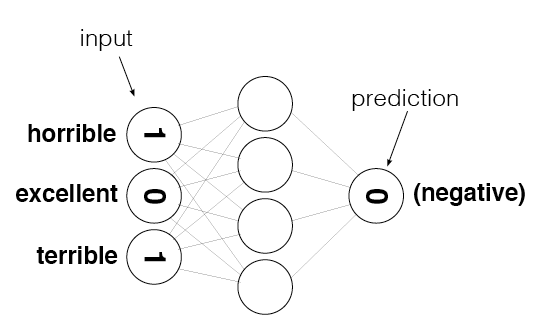

In [18]:
from IPython.display import Image

review = "This was a horrible, terrible movie."

Image(filename='sentiment_network.png')

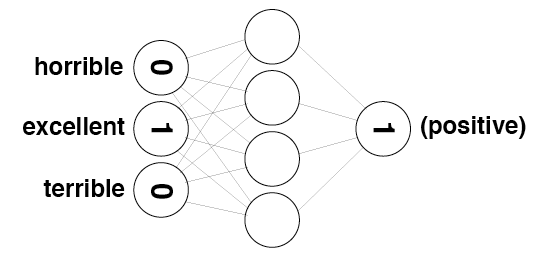

In [19]:
review = "The movie was excellent"

Image(filename='sentiment_network_pos.png')

# Project 2: Creating the Input/Output Data<a id='project_2'></a>

**TODO:** Create a [set](https://docs.python.org/3/tutorial/datastructures.html#sets) named `vocab` that contains every word in the vocabulary.

In [20]:
# TODO: Create set named "vocab" containing all of the words from all of the reviews

#All the words are already in the total_counts Counter , i dont need to go to every review
vocab = set(total_counts.keys())

Run the following cell to check your vocabulary size. If everything worked correctly, it should print **74074**

In [21]:
vocab_size = len(vocab)
print(vocab_size)

74074


Take a look at the following image. It represents the layers of the neural network you'll be building throughout this notebook. `layer_0` is the input layer, `layer_1` is a hidden layer, and `layer_2` is the output layer.

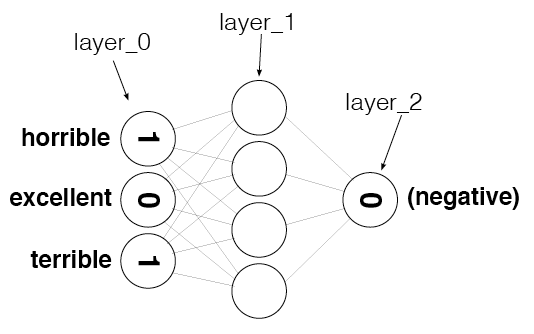

In [22]:
from IPython.display import Image
Image(filename='sentiment_network_2.png')

**TODO:** Create a numpy array called `layer_0` and initialize it to all zeros. You will find the [zeros](https://docs.scipy.org/doc/numpy/reference/generated/numpy.zeros.html) function particularly helpful here. Be sure you create `layer_0` as a 2-dimensional matrix with 1 row and `vocab_size` columns. 

In [23]:
# TODO: Create layer_0 matrix with dimensions 1 by vocab_size, initially filled with zeros
layer_0 = np.array(np.zeros((1,vocab_size)))

Run the following cell. It should display `(1, 74074)`

In [24]:
layer_0.shape

(1, 74074)

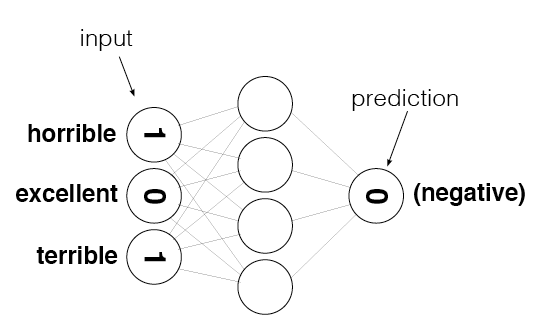

In [25]:
from IPython.display import Image
Image(filename='sentiment_network.png')

`layer_0` contains one entry for every word in the vocabulary, as shown in the above image. We need to make sure we know the index of each word, so run the following cell to create a lookup table that stores the index of every word.

In [26]:
# Create a dictionary of words in the vocabulary mapped to index positions
# (to be used in layer_0)
word2index = {}
for i,word in enumerate(vocab):
    word2index[word] = i
    
# display the map of words to indices
word2index

{'': 0,
 'michinokuc': 1,
 'tiltes': 2,
 'scale': 3,
 'shakedown': 4,
 'feign': 5,
 'lemondrop': 6,
 'comiccon': 7,
 'speeders': 8,
 'cayman': 9,
 'dond': 10,
 'pardesi': 11,
 'sedated': 12,
 'streetwise': 13,
 'ophuls': 14,
 'kimi': 15,
 'volcanic': 16,
 'payaso': 17,
 'propably': 18,
 'condescended': 19,
 'roubaix': 20,
 'kitchen': 21,
 'petronijevic': 22,
 'cremation': 23,
 'fieriest': 24,
 'royaly': 25,
 'hillsides': 26,
 'valeria': 27,
 'mainstream': 28,
 'andreu': 29,
 'practicality': 30,
 'alfonso': 31,
 'foresees': 32,
 'wrestle': 33,
 'teodoro': 34,
 'apart': 35,
 'imagination': 36,
 'customs': 37,
 'cronenberg': 38,
 'kose': 39,
 'mispronunciation': 40,
 'rejectable': 41,
 'superstitious': 42,
 'hersholt': 43,
 'compone': 44,
 'doogie': 45,
 'playwright': 46,
 'loo': 47,
 'lagoon': 48,
 'frye': 49,
 'carjacking': 50,
 'severe': 51,
 'overnighter': 52,
 'emergence': 53,
 'whimsy': 54,
 'neglectful': 55,
 'magnesium': 56,
 'streetwalker': 57,
 'misleads': 58,
 'lackeys': 59,
 '

**TODO:**  Complete the implementation of `update_input_layer`. It should count 
          how many times each word is used in the given review, and then store
          those counts at the appropriate indices inside `layer_0`.

In [27]:
def update_input_layer(review):
    """ Modify the global layer_0 to represent the vector form of review.
    The element at a given index of layer_0 should represent
    how many times the given word occurs in the review.
    Args:
        review(string) - the string of the review
    Returns:
        None
    """
    global layer_0
    # clear out previous state by resetting the layer to be all 0s
    layer_0 *= 0
    
    # TODO: count how many times each word is used in the given review and store the results in layer_0
    counter = Counter(review.split(' '))
    for word in counter:
        word_index = word2index[word]
        layer_0[0,word_index] = counter[word]

Run the following cell to test updating the input layer with the first review. The indices assigned may not be the same as in the solution, but hopefully you'll see some non-zero values in `layer_0`.  

In [28]:
update_input_layer(reviews[0])
layer_0

array([[ 18.,   0.,   0., ...,   0.,   0.,   0.]])

**TODO:** Complete the implementation of `get_target_for_labels`. It should return `0` or `1`, 
          depending on whether the given label is `NEGATIVE` or `POSITIVE`, respectively.

In [29]:
def get_target_for_label(label):
    """Convert a label to `0` or `1`.
    Args:
        label(string) - Either "POSITIVE" or "NEGATIVE".
    Returns:
        `0` or `1`.
    """
    # TODO: Your code here
    return 0 if label == 'NEGATIVE' else 1

Run the following two cells. They should print out`'POSITIVE'` and `1`, respectively.

In [30]:
labels[0]

'POSITIVE'

In [31]:
get_target_for_label(labels[0])

1

Run the following two cells. They should print out `'NEGATIVE'` and `0`, respectively.

In [32]:
labels[1]

'NEGATIVE'

In [33]:
get_target_for_label(labels[1])

0

# End of Project 2. 
## Watch the next video to see Andrew's solution, then continue on to the next lesson.

# Project 3: Building a Neural Network<a id='project_3'></a>

**TODO:** We've included the framework of a class called `SentimentNetork`. Implement all of the items marked `TODO` in the code. These include doing the following:
- Create a basic neural network much like the networks you've seen in earlier lessons and in Project 1, with an input layer, a hidden layer, and an output layer. 
- Do **not** add a non-linearity in the hidden layer. That is, do not use an activation function when calculating the hidden layer outputs.
- Re-use the code from earlier in this notebook to create the training data (see `TODO`s in the code)
- Implement the `pre_process_data` function to create the vocabulary for our training data generating functions
- Ensure `train` trains over the entire corpus

In [34]:
import time
import sys
import numpy as np

# Encapsulate our neural network in a class
class SentimentNetwork:
    def __init__(self, reviews, labels, hidden_nodes = 10, learning_rate = 0.1):
        """Create a SentimenNetwork with the given settings
        Args:
            reviews(list) - List of reviews used for training
            labels(list) - List of POSITIVE/NEGATIVE labels associated with the given reviews
            hidden_nodes(int) - Number of nodes to create in the hidden layer
            learning_rate(float) - Learning rate to use while training
        
        """
        # Assign a seed to our random number generator to ensure we get
        # reproducable results during development 
        np.random.seed(1)

        # process the reviews and their associated labels so that everything
        # is ready for training
        self.pre_process_data(reviews, labels)
        
        # Build the network to have the number of hidden nodes and the learning rate that
        # were passed into this initializer. Make the same number of input nodes as
        # there are vocabulary words and create a single output node.
        self.init_network(len(self.review_vocab),hidden_nodes, 1, learning_rate)

    def pre_process_data(self, reviews, labels):
        
        review_vocab = set()
        # TODO: populate review_vocab with all of the words in the given reviews
        #       Remember to split reviews into individual words 
        #       using "split(' ')" instead of "split()".
        
        for review in reviews:
            words = review.split(' ')
            for word in words:
                review_vocab.add(word)
        # Convert the vocabulary set to a list so we can access words via indices
        self.review_vocab = list(review_vocab)
        
        label_vocab = set()
        # TODO: populate label_vocab with all of the words in the given labels.
        #       There is no need to split the labels because each one is a single word.
        
        for label in labels:
            label_vocab.add(label)
        # Convert the label vocabulary set to a list so we can access labels via indices
        self.label_vocab = list(label_vocab)
        
        # Store the sizes of the review and label vocabularies.
        self.review_vocab_size = len(self.review_vocab)
        self.label_vocab_size = len(self.label_vocab)
        
        # Create a dictionary of words in the vocabulary mapped to index positions
        self.word2index = {}
        # TODO: populate self.word2index with indices for all the words in self.review_vocab
        #       like you saw earlier in the notebook
        for index,word in enumerate(self.review_vocab):
            self.word2index[word] = index
        # Create a dictionary of labels mapped to index positions
        self.label2index = {}
        # TODO: do the same thing you did for self.word2index and self.review_vocab, 
        #       but for self.label2index and self.label_vocab instead
        for index,label in enumerate(self.label_vocab):
            self.label2index[label] = index
            
        
    def init_network(self, input_nodes, hidden_nodes, output_nodes, learning_rate):
        # Store the number of nodes in input, hidden, and output layers.
        self.input_nodes = input_nodes
        self.hidden_nodes = hidden_nodes
        self.output_nodes = output_nodes

        # Store the learning rate
        self.learning_rate = learning_rate

        # Initialize weights
        
        # TODO: initialize self.weights_0_1 as a matrix of zeros. These are the weights between
        #       the input layer and the hidden layer.
        self.weights_0_1 = np.zeros((input_nodes,hidden_nodes))
        
        # TODO: initialize self.weights_1_2 as a matrix of random values. 
        #       These are the weights between the hidden layer and the output layer.
        self.weights_1_2 = np.random.normal(0.0, self.output_nodes**-0.5, 
                                                (self.hidden_nodes, self.output_nodes))
        
        # TODO: Create the input layer, a two-dimensional matrix with shape 
        #       1 x input_nodes, with all values initialized to zero
        self.layer_0 = np.zeros((1,input_nodes))
    
        
    def update_input_layer(self,review):
        # TODO: You can copy most of the code you wrote for update_input_layer 
        #       earlier in this notebook. 
        #
        #       However, MAKE SURE YOU CHANGE ALL VARIABLES TO REFERENCE
        #       THE VERSIONS STORED IN THIS OBJECT, NOT THE GLOBAL OBJECTS.
        #       For example, replace "layer_0 *= 0" with "self.layer_0 *= 0"
        self.layer_0*=0
        counter = Counter(review.split(' '))
        for word in counter:
            if word in self.word2index.keys():
                word_count = counter[word]
                word_index = self.word2index[word]
                self.layer_0[0,word_index] = word_count
                
    def get_target_for_label(self,label):
        # TODO: Copy the code you wrote for get_target_for_label 
        #       earlier in this notebook. 
        return 0 if label == 'NEGATIVE' else 1
        
    def sigmoid(self,x):
        # TODO: Return the result of calculating the sigmoid activation function
        #       shown in the lectures
        return 1 / ( 1 + np.exp(-x))
    
    def sigmoid_output_2_derivative(self,output):
        # TODO: Return the derivative of the sigmoid activation function, 
        #       where "output" is the original output from the sigmoid fucntion 
        return output * (1 - output)

    def train(self, training_reviews, training_labels):
        
        # make sure out we have a matching number of reviews and labels
        assert(len(training_reviews) == len(training_labels))
        
        # Keep track of correct predictions to display accuracy during training 
        correct_so_far = 0
        
        # Remember when we started for printing time statistics
        start = time.time()

        # loop through all the given reviews and run a forward and backward pass,
        # updating weights for every item
        for i in range(len(training_reviews)):
            
            # TODO: Get the next review and its correct label
            review = training_reviews[i]
            label = training_labels[i]
            # TODO: Implement the forward pass through the network. 
            #       That means use the given review to update the input layer, 
            #       then calculate values for the hidden layer,
            #       and finally calculate the output layer.
            # 
            #       Do not use an activation function for the hidden layer,
            #       but use the sigmoid activation function for the output layer.
            self.update_input_layer(review)
            hidden_layer_output = np.dot(self.layer_0,self.weights_0_1)
            output_layer_logits = np.dot(hidden_layer_output,self.weights_1_2)
            output_layer_predictions = self.sigmoid(output_layer_logits)
            #print("output layer",output_layer_predictions.shape)
            # TODO: Implement the back propagation pass here. 
            #       That means calculate the error for the forward pass's prediction
            #       and update the weights in the network according to their
            #       contributions toward the error, as calculated via the
            #       gradient descent and back propagation algorithms you 
            #       learned in class.
            error = output_layer_predictions - self.get_target_for_label(label)
            #print("error",error.shape)
            #calculate the error terms of each layer
            output_error_term = error*self.sigmoid_output_2_derivative(output_layer_predictions)
            #print("output error term",output_error_term.shape)
            hidden_error_term = self.weights_1_2*output_error_term
            #print("hidden error term",hidden_error_term.shape)
            #print("hidden layer output",hidden_layer_output.shape)
            #calculate the delta on the weights of each layer
            delta_weights_h_o =  output_error_term * hidden_layer_output
            delta_weights_i_h = hidden_error_term * self.layer_0
            #print("calculated",(self.learning_rate*delta_weights_h_o).shape)
            #print("weights",self.weights_1_2.shape)
            self.weights_1_2-= (self.learning_rate*delta_weights_h_o).T
            self.weights_0_1-= (self.learning_rate*delta_weights_i_h).T
            # TODO: Keep track of correct predictions. To determine if the prediction was
            #       correct, check that the absolute value of the output error 
            #       is less than 0.5. If so, add one to the correct_so_far count.
            #Note to myself: strange way to calc correctness hmmm
            if  np.abs(error) < 0.5:
                correct_so_far+=1
            
            # For debug purposes, print out our prediction accuracy and speed 
            # throughout the training process. 

            elapsed_time = float(time.time() - start)
            reviews_per_second = i / elapsed_time if elapsed_time > 0 else 0
            
            sys.stdout.write("\rProgress:" + str(100 * i/float(len(training_reviews)))[:4] \
                             + "% Speed(reviews/sec):" + str(reviews_per_second)[0:5] \
                             + " #Correct:" + str(correct_so_far) + " #Trained:" + str(i+1) \
                             + " Training Accuracy:" + str(correct_so_far * 100 / float(i+1))[:4] + "%")
            if(i % 2500 == 0):
                print("")
    
    def test(self, testing_reviews, testing_labels):
        """
        Attempts to predict the labels for the given testing_reviews,
        and uses the test_labels to calculate the accuracy of those predictions.
        """
        
        # keep track of how many correct predictions we make
        correct = 0

        # we'll time how many predictions per second we make
        start = time.time()

        # Loop through each of the given reviews and call run to predict
        # its label. 
        for i in range(len(testing_reviews)):
            pred = self.run(testing_reviews[i])
            if(pred == testing_labels[i]):
                correct += 1
            
            # For debug purposes, print out our prediction accuracy and speed 
            # throughout the prediction process. 

            elapsed_time = float(time.time() - start)
            reviews_per_second = i / elapsed_time if elapsed_time > 0 else 0
            
            sys.stdout.write("\rProgress:" + str(100 * i/float(len(testing_reviews)))[:4] \
                             + "% Speed(reviews/sec):" + str(reviews_per_second)[0:5] \
                             + " #Correct:" + str(correct) + " #Tested:" + str(i+1) \
                             + " Testing Accuracy:" + str(correct * 100 / float(i+1))[:4] + "%")
    
    def run(self, review):
        """
        Returns a POSITIVE or NEGATIVE prediction for the given review.
        """
        # TODO: Run a forward pass through the network, like you did in the
        #       "train" function. That means use the given review to 
        #       update the input layer, then calculate values for the hidden layer,
        #       and finally calculate the output layer.
        #
        #       Note: The review passed into this function for prediction 
        #             might come from anywhere, so you should convert it 
        #             to lower case prior to using it.
        review = review.lower()
        self.update_input_layer(review)
        hidden_output = np.dot(self.layer_0,self.weights_0_1)
        output_logits = np.dot(hidden_output,self.weights_1_2)
        output = self.sigmoid(output_logits)
        # TODO: The output layer should now contain a prediction. 
        #       Return `POSITIVE` for predictions greater-than-or-equal-to `0.5`, 
        #       and `NEGATIVE` otherwise.
        return "POSITIVE" if output >= 0.5 else "NEGATIVE"


Run the following cell to create a `SentimentNetwork` that will train on all but the last 1000 reviews (we're saving those for testing). Here we use a learning rate of `0.1`.

In [35]:
mlp = SentimentNetwork(reviews[:-1000],labels[:-1000], learning_rate=0.1)

Run the following cell to test the network's performance against the last 1000 reviews (the ones we held out from our training set). 

**We have not trained the model yet, so the results should be about 50% as it will just be guessing and there are only two possible values to choose from.**

In [36]:
mlp.test(reviews[-1000:],labels[-1000:])

Progress:26.6% Speed(reviews/sec):1227. #Correct:134 #Tested:267 Testing Accuracy:50.1%

Progress:52.4% Speed(reviews/sec):1254. #Correct:263 #Tested:525 Testing Accuracy:50.0%

Progress:80.0% Speed(reviews/sec):1292. #Correct:401 #Tested:801 Testing Accuracy:50.0%

Progress:99.9% Speed(reviews/sec):1316. #Correct:500 #Tested:1000 Testing Accuracy:50.0%

Run the following cell to actually train the network. During training, it will display the model's accuracy repeatedly as it trains so you can see how well it's doing.

In [37]:
mlp.train(reviews[:-1000],labels[:-1000])

Progress:0.0% Speed(reviews/sec):0.0 #Correct:0 #Trained:1 Training Accuracy:0.0%
Progress:10.4% Speed(reviews/sec):286.1 #Correct:1250 #Trained:2501 Training Accuracy:49.9%
Progress:20.8% Speed(reviews/sec):287.9 #Correct:2500 #Trained:5001 Training Accuracy:49.9%
Progress:31.2% Speed(reviews/sec):287.7 #Correct:3750 #Trained:7501 Training Accuracy:49.9%
Progress:41.6% Speed(reviews/sec):289.9 #Correct:5000 #Trained:10001 Training Accuracy:49.9%
Progress:52.0% Speed(reviews/sec):289.0 #Correct:6250 #Trained:12501 Training Accuracy:49.9%
Progress:62.5% Speed(reviews/sec):288.8 #Correct:7500 #Trained:15001 Training Accuracy:49.9%
Progress:72.9% Speed(reviews/sec):288.6 #Correct:8750 #Trained:17501 Training Accuracy:49.9%
Progress:83.3% Speed(reviews/sec):288.6 #Correct:10000 #Trained:20001 Training Accuracy:49.9%
Progress:93.7% Speed(reviews/sec):289.3 #Correct:11250 #Trained:22501 Training Accuracy:49.9%
Progress:99.9% Speed(reviews/sec):288.1 #Correct:11999 #Trained:24000 Training Acc

That most likely didn't train very well. Part of the reason may be because the learning rate is too high. Run the following cell to recreate the network with a smaller learning rate, `0.01`, and then train the new network.

In [38]:
mlp = SentimentNetwork(reviews[:-1000],labels[:-1000], learning_rate=0.01)
mlp.train(reviews[:-1000],labels[:-1000])

Progress:0.0% Speed(reviews/sec):0.0 #Correct:0 #Trained:1 Training Accuracy:0.0%
Progress:10.4% Speed(reviews/sec):290.1 #Correct:1247 #Trained:2501 Training Accuracy:49.8%
Progress:20.8% Speed(reviews/sec):286.1 #Correct:2497 #Trained:5001 Training Accuracy:49.9%
Progress:31.2% Speed(reviews/sec):285.3 #Correct:3747 #Trained:7501 Training Accuracy:49.9%
Progress:41.6% Speed(reviews/sec):286.9 #Correct:4997 #Trained:10001 Training Accuracy:49.9%
Progress:52.0% Speed(reviews/sec):285.7 #Correct:6247 #Trained:12501 Training Accuracy:49.9%
Progress:62.5% Speed(reviews/sec):284.8 #Correct:7490 #Trained:15001 Training Accuracy:49.9%
Progress:72.9% Speed(reviews/sec):283.3 #Correct:8736 #Trained:17501 Training Accuracy:49.9%
Progress:83.3% Speed(reviews/sec):282.3 #Correct:9986 #Trained:20001 Training Accuracy:49.9%
Progress:93.7% Speed(reviews/sec):282.9 #Correct:11236 #Trained:22501 Training Accuracy:49.9%
Progress:99.9% Speed(reviews/sec):281.6 #Correct:11985 #Trained:24000 Training Accu

That probably wasn't much different. Run the following cell to recreate the network one more time with an even smaller learning rate, `0.001`, and then train the new network.

In [39]:
mlp = SentimentNetwork(reviews[:-1000],labels[:-1000], learning_rate=0.001)
mlp.train(reviews[:-1000],labels[:-1000])

Progress:0.0% Speed(reviews/sec):0.0 #Correct:0 #Trained:1 Training Accuracy:0.0%
Progress:10.4% Speed(reviews/sec):286.1 #Correct:1276 #Trained:2501 Training Accuracy:51.0%
Progress:20.8% Speed(reviews/sec):282.0 #Correct:2608 #Trained:5001 Training Accuracy:52.1%
Progress:31.2% Speed(reviews/sec):281.5 #Correct:4029 #Trained:7501 Training Accuracy:53.7%
Progress:41.6% Speed(reviews/sec):279.1 #Correct:5593 #Trained:10001 Training Accuracy:55.9%
Progress:52.0% Speed(reviews/sec):271.2 #Correct:7197 #Trained:12501 Training Accuracy:57.5%
Progress:62.5% Speed(reviews/sec):271.6 #Correct:8761 #Trained:15001 Training Accuracy:58.4%
Progress:72.9% Speed(reviews/sec):269.2 #Correct:10368 #Trained:17501 Training Accuracy:59.2%
Progress:83.3% Speed(reviews/sec):266.6 #Correct:12052 #Trained:20001 Training Accuracy:60.2%
Progress:93.7% Speed(reviews/sec):267.4 #Correct:13770 #Trained:22501 Training Accuracy:61.1%
Progress:99.9% Speed(reviews/sec):267.8 #Correct:14817 #Trained:24000 Training Ac

With a learning rate of `0.001`, the network should finall have started to improve during training. It's still not very good, but it shows that this solution has potential. We will improve it in the next lesson.

In [40]:
mlp = SentimentNetwork(reviews[:-1000],labels[:-1000], learning_rate=0.0003)
mlp.train(reviews[:-1000],labels[:-1000])

Progress:0.0% Speed(reviews/sec):0.0 #Correct:0 #Trained:1 Training Accuracy:0.0%
Progress:10.4% Speed(reviews/sec):271.6 #Correct:1336 #Trained:2501 Training Accuracy:53.4%
Progress:20.8% Speed(reviews/sec):260.4 #Correct:2855 #Trained:5001 Training Accuracy:57.0%
Progress:31.2% Speed(reviews/sec):264.7 #Correct:4489 #Trained:7501 Training Accuracy:59.8%
Progress:41.6% Speed(reviews/sec):266.5 #Correct:6217 #Trained:10001 Training Accuracy:62.1%
Progress:52.0% Speed(reviews/sec):268.4 #Correct:7982 #Trained:12501 Training Accuracy:63.8%
Progress:62.5% Speed(reviews/sec):270.6 #Correct:9729 #Trained:15001 Training Accuracy:64.8%
Progress:72.9% Speed(reviews/sec):273.5 #Correct:11463 #Trained:17501 Training Accuracy:65.4%
Progress:83.3% Speed(reviews/sec):274.5 #Correct:13317 #Trained:20001 Training Accuracy:66.5%
Progress:93.7% Speed(reviews/sec):272.1 #Correct:15177 #Trained:22501 Training Accuracy:67.4%
Progress:99.9% Speed(reviews/sec):271.3 #Correct:16315 #Trained:24000 Training Ac

# End of Project 3. 
## Watch the next video to see Andrew's solution, then continue on to the next lesson.

# Understanding Neural Noise<a id='lesson_4'></a>

The following cells include includes the code Andrew shows in the next video. We've included it here so you can run the cells along with the video without having to type in everything.

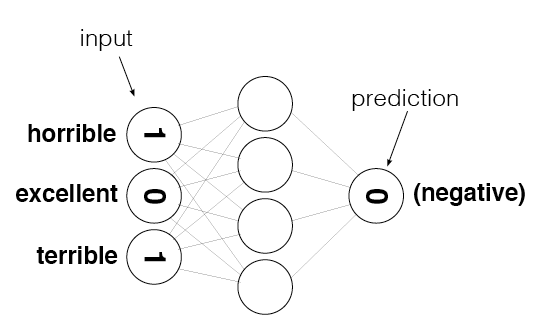

In [41]:
from IPython.display import Image
Image(filename='sentiment_network.png')

In [42]:
def update_input_layer(review):
    
    global layer_0
    
    # clear out previous state, reset the layer to be all 0s
    layer_0 *= 0
    for word in review.split(" "):
        layer_0[0][word2index[word]] += 1

update_input_layer(reviews[0])

In [43]:
layer_0

array([[ 18.,   0.,   0., ...,   0.,   0.,   0.]])

In [44]:
review_counter = Counter()

In [45]:
for word in reviews[0].split(" "):
    review_counter[word] += 1

In [46]:
review_counter.most_common()

[('.', 27),
 ('', 18),
 ('the', 9),
 ('to', 6),
 ('high', 5),
 ('i', 5),
 ('bromwell', 4),
 ('is', 4),
 ('a', 4),
 ('teachers', 4),
 ('that', 4),
 ('of', 4),
 ('it', 2),
 ('at', 2),
 ('as', 2),
 ('school', 2),
 ('my', 2),
 ('in', 2),
 ('me', 2),
 ('students', 2),
 ('their', 2),
 ('student', 2),
 ('cartoon', 1),
 ('comedy', 1),
 ('ran', 1),
 ('same', 1),
 ('time', 1),
 ('some', 1),
 ('other', 1),
 ('programs', 1),
 ('about', 1),
 ('life', 1),
 ('such', 1),
 ('years', 1),
 ('teaching', 1),
 ('profession', 1),
 ('lead', 1),
 ('believe', 1),
 ('s', 1),
 ('satire', 1),
 ('much', 1),
 ('closer', 1),
 ('reality', 1),
 ('than', 1),
 ('scramble', 1),
 ('survive', 1),
 ('financially', 1),
 ('insightful', 1),
 ('who', 1),
 ('can', 1),
 ('see', 1),
 ('right', 1),
 ('through', 1),
 ('pathetic', 1),
 ('pomp', 1),
 ('pettiness', 1),
 ('whole', 1),
 ('situation', 1),
 ('all', 1),
 ('remind', 1),
 ('schools', 1),
 ('knew', 1),
 ('and', 1),
 ('when', 1),
 ('saw', 1),
 ('episode', 1),
 ('which', 1),
 ('r

# Project 4: Reducing Noise in Our Input Data<a id='project_4'></a>

**TODO:** Attempt to reduce the noise in the input data like Andrew did in the previous video. Specifically, do the following:
* Copy the `SentimentNetwork` class you created earlier into the following cell.
* Modify `update_input_layer` so it does not count how many times each word is used, but rather just stores whether or not a word was used. 

In [47]:
# TODO: -Copy the SentimentNetwork class from Projet 3 lesson
#       -Modify it to reduce noise, like in the video 
import time
import sys
import numpy as np

# Encapsulate our neural network in a class
class SentimentNetwork:
    def __init__(self, reviews, labels, hidden_nodes = 10, learning_rate = 0.1):
        """Create a SentimenNetwork with the given settings
        Args:
            reviews(list) - List of reviews used for training
            labels(list) - List of POSITIVE/NEGATIVE labels associated with the given reviews
            hidden_nodes(int) - Number of nodes to create in the hidden layer
            learning_rate(float) - Learning rate to use while training
        
        """
        # Assign a seed to our random number generator to ensure we get
        # reproducable results during development 
        np.random.seed(1)

        # process the reviews and their associated labels so that everything
        # is ready for training
        self.pre_process_data(reviews, labels)
        
        # Build the network to have the number of hidden nodes and the learning rate that
        # were passed into this initializer. Make the same number of input nodes as
        # there are vocabulary words and create a single output node.
        self.init_network(len(self.review_vocab),hidden_nodes, 1, learning_rate)

    def pre_process_data(self, reviews, labels):
        
        review_vocab = set()
        # TODO: populate review_vocab with all of the words in the given reviews
        #       Remember to split reviews into individual words 
        #       using "split(' ')" instead of "split()".
        
        for review in reviews:
            words = review.split(' ')
            for word in words:
                review_vocab.add(word)
        # Convert the vocabulary set to a list so we can access words via indices
        self.review_vocab = list(review_vocab)
        
        label_vocab = set()
        # TODO: populate label_vocab with all of the words in the given labels.
        #       There is no need to split the labels because each one is a single word.
        
        for label in labels:
            label_vocab.add(label)
        # Convert the label vocabulary set to a list so we can access labels via indices
        self.label_vocab = list(label_vocab)
        
        # Store the sizes of the review and label vocabularies.
        self.review_vocab_size = len(self.review_vocab)
        self.label_vocab_size = len(self.label_vocab)
        
        # Create a dictionary of words in the vocabulary mapped to index positions
        self.word2index = {}
        # TODO: populate self.word2index with indices for all the words in self.review_vocab
        #       like you saw earlier in the notebook
        for index,word in enumerate(self.review_vocab):
            self.word2index[word] = index
        # Create a dictionary of labels mapped to index positions
        self.label2index = {}
        # TODO: do the same thing you did for self.word2index and self.review_vocab, 
        #       but for self.label2index and self.label_vocab instead
        for index,label in enumerate(self.label_vocab):
            self.label2index[label] = index
            
        
    def init_network(self, input_nodes, hidden_nodes, output_nodes, learning_rate):
        # Store the number of nodes in input, hidden, and output layers.
        self.input_nodes = input_nodes
        self.hidden_nodes = hidden_nodes
        self.output_nodes = output_nodes

        # Store the learning rate
        self.learning_rate = learning_rate

        # Initialize weights
        
        # TODO: initialize self.weights_0_1 as a matrix of zeros. These are the weights between
        #       the input layer and the hidden layer.
        self.weights_0_1 = np.zeros((input_nodes,hidden_nodes))
        
        # TODO: initialize self.weights_1_2 as a matrix of random values. 
        #       These are the weights between the hidden layer and the output layer.
        self.weights_1_2 = np.random.normal(0.0, self.output_nodes**-0.5, 
                                                (self.hidden_nodes, self.output_nodes))
        
        # TODO: Create the input layer, a two-dimensional matrix with shape 
        #       1 x input_nodes, with all values initialized to zero
        self.layer_0 = np.zeros((1,input_nodes))
    
        
    def update_input_layer(self,review):
        # TODO: You can copy most of the code you wrote for update_input_layer 
        #       earlier in this notebook. 
        #
        #       However, MAKE SURE YOU CHANGE ALL VARIABLES TO REFERENCE
        #       THE VERSIONS STORED IN THIS OBJECT, NOT THE GLOBAL OBJECTS.
        #       For example, replace "layer_0 *= 0" with "self.layer_0 *= 0"
        self.layer_0*=0
        for word in review.split(' '):
            if word in self.word2index.keys():
                word_index = self.word2index[word]
                self.layer_0[0,word_index] = 1
                
    def get_target_for_label(self,label):
        # TODO: Copy the code you wrote for get_target_for_label 
        #       earlier in this notebook. 
        return 0 if label == 'NEGATIVE' else 1
        
    def sigmoid(self,x):
        # TODO: Return the result of calculating the sigmoid activation function
        #       shown in the lectures
        return 1 / ( 1 + np.exp(-x))
    
    def sigmoid_output_2_derivative(self,output):
        # TODO: Return the derivative of the sigmoid activation function, 
        #       where "output" is the original output from the sigmoid fucntion 
        return output * (1 - output)

    def train(self, training_reviews, training_labels):
        
        # make sure out we have a matching number of reviews and labels
        assert(len(training_reviews) == len(training_labels))
        
        # Keep track of correct predictions to display accuracy during training 
        correct_so_far = 0
        
        # Remember when we started for printing time statistics
        start = time.time()

        # loop through all the given reviews and run a forward and backward pass,
        # updating weights for every item
        for i in range(len(training_reviews)):
            
            # TODO: Get the next review and its correct label
            review = training_reviews[i]
            label = training_labels[i]
            # TODO: Implement the forward pass through the network. 
            #       That means use the given review to update the input layer, 
            #       then calculate values for the hidden layer,
            #       and finally calculate the output layer.
            # 
            #       Do not use an activation function for the hidden layer,
            #       but use the sigmoid activation function for the output layer.
            self.update_input_layer(review)
            hidden_layer_output = np.dot(self.layer_0,self.weights_0_1)
            output_layer_logits = np.dot(hidden_layer_output,self.weights_1_2)
            output_layer_predictions = self.sigmoid(output_layer_logits)
            #print("output layer",output_layer_predictions.shape)
            # TODO: Implement the back propagation pass here. 
            #       That means calculate the error for the forward pass's prediction
            #       and update the weights in the network according to their
            #       contributions toward the error, as calculated via the
            #       gradient descent and back propagation algorithms you 
            #       learned in class.
            error = output_layer_predictions - self.get_target_for_label(label)
            #print("error",error.shape)
            #calculate the error terms of each layer
            output_error_term = error*self.sigmoid_output_2_derivative(output_layer_predictions)
            #print("output error term",output_error_term.shape)
            hidden_error_term = self.weights_1_2*output_error_term
            #print("hidden error term",hidden_error_term.shape)
            #print("hidden layer output",hidden_layer_output.shape)
            #calculate the delta on the weights of each layer
            delta_weights_h_o =  output_error_term * hidden_layer_output
            delta_weights_i_h = hidden_error_term * self.layer_0
            #print("calculated",(self.learning_rate*delta_weights_h_o).shape)
            #print("weights",self.weights_1_2.shape)
            self.weights_1_2-= (self.learning_rate*delta_weights_h_o).T
            self.weights_0_1-= (self.learning_rate*delta_weights_i_h).T
            # TODO: Keep track of correct predictions. To determine if the prediction was
            #       correct, check that the absolute value of the output error 
            #       is less than 0.5. If so, add one to the correct_so_far count.
            #Note to myself: strange way to calc correctness hmmm
            if  np.abs(error) < 0.5:
                correct_so_far+=1
            
            # For debug purposes, print out our prediction accuracy and speed 
            # throughout the training process. 

            elapsed_time = float(time.time() - start)
            reviews_per_second = i / elapsed_time if elapsed_time > 0 else 0
            
            sys.stdout.write("\rProgress:" + str(100 * i/float(len(training_reviews)))[:4] \
                             + "% Speed(reviews/sec):" + str(reviews_per_second)[0:5] \
                             + " #Correct:" + str(correct_so_far) + " #Trained:" + str(i+1) \
                             + " Training Accuracy:" + str(correct_so_far * 100 / float(i+1))[:4] + "%")
            if(i % 2500 == 0):
                print("")
    
    def test(self, testing_reviews, testing_labels):
        """
        Attempts to predict the labels for the given testing_reviews,
        and uses the test_labels to calculate the accuracy of those predictions.
        """
        
        # keep track of how many correct predictions we make
        correct = 0

        # we'll time how many predictions per second we make
        start = time.time()

        # Loop through each of the given reviews and call run to predict
        # its label. 
        for i in range(len(testing_reviews)):
            pred = self.run(testing_reviews[i])
            if(pred == testing_labels[i]):
                correct += 1
            
            # For debug purposes, print out our prediction accuracy and speed 
            # throughout the prediction process. 

            elapsed_time = float(time.time() - start)
            reviews_per_second = i / elapsed_time if elapsed_time > 0 else 0
            
            sys.stdout.write("\rProgress:" + str(100 * i/float(len(testing_reviews)))[:4] \
                             + "% Speed(reviews/sec):" + str(reviews_per_second)[0:5] \
                             + " #Correct:" + str(correct) + " #Tested:" + str(i+1) \
                             + " Testing Accuracy:" + str(correct * 100 / float(i+1))[:4] + "%")
    
    def run(self, review):
        """
        Returns a POSITIVE or NEGATIVE prediction for the given review.
        """
        # TODO: Run a forward pass through the network, like you did in the
        #       "train" function. That means use the given review to 
        #       update the input layer, then calculate values for the hidden layer,
        #       and finally calculate the output layer.
        #
        #       Note: The review passed into this function for prediction 
        #             might come from anywhere, so you should convert it 
        #             to lower case prior to using it.
        review = review.lower()
        self.update_input_layer(review)
        hidden_output = np.dot(self.layer_0,self.weights_0_1)
        output_logits = np.dot(hidden_output,self.weights_1_2)
        output = self.sigmoid(output_logits)
        # TODO: The output layer should now contain a prediction. 
        #       Return `POSITIVE` for predictions greater-than-or-equal-to `0.5`, 
        #       and `NEGATIVE` otherwise.
        return "POSITIVE" if output >= 0.5 else "NEGATIVE"

Run the following cell to recreate the network and train it. Notice we've gone back to the higher learning rate of `0.1`.

In [48]:
mlp = SentimentNetwork(reviews[:-1000],labels[:-1000], learning_rate=0.1)
mlp.train(reviews[:-1000],labels[:-1000])

Progress:0.0% Speed(reviews/sec):0.0 #Correct:0 #Trained:1 Training Accuracy:0.0%
Progress:10.4% Speed(reviews/sec):277.4 #Correct:1788 #Trained:2501 Training Accuracy:71.4%
Progress:20.8% Speed(reviews/sec):271.7 #Correct:3790 #Trained:5001 Training Accuracy:75.7%
Progress:31.2% Speed(reviews/sec):272.6 #Correct:5874 #Trained:7501 Training Accuracy:78.3%
Progress:41.6% Speed(reviews/sec):271.7 #Correct:8018 #Trained:10001 Training Accuracy:80.1%
Progress:52.0% Speed(reviews/sec):267.3 #Correct:10156 #Trained:12501 Training Accuracy:81.2%
Progress:62.5% Speed(reviews/sec):265.9 #Correct:12293 #Trained:15001 Training Accuracy:81.9%
Progress:72.9% Speed(reviews/sec):264.0 #Correct:14403 #Trained:17501 Training Accuracy:82.2%
Progress:83.3% Speed(reviews/sec):264.6 #Correct:16582 #Trained:20001 Training Accuracy:82.9%
Progress:93.7% Speed(reviews/sec):266.2 #Correct:18762 #Trained:22501 Training Accuracy:83.3%
Progress:99.9% Speed(reviews/sec):267.5 #Correct:20083 #Trained:24000 Training 

That should have trained much better than the earlier attempts. It's still not wonderful, but it should have improved dramatically. Run the following cell to test your model with 1000 predictions.

In [49]:
mlp.test(reviews[-1000:],labels[-1000:])

Progress:99.9% Speed(reviews/sec):1228. #Correct:858 #Tested:1000 Testing Accuracy:85.8%

# End of Project 4. 
## Andrew's solution was actually in the previous video, so rewatch that video if you had any problems with that project. Then continue on to the next lesson.
# Analyzing Inefficiencies in our Network<a id='lesson_5'></a>
The following cells include the code Andrew shows in the next video. We've included it here so you can run the cells along with the video without having to type in everything.

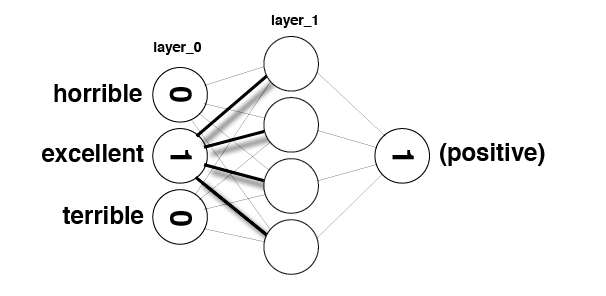

In [50]:
Image(filename='sentiment_network_sparse.png')

In [51]:
layer_0 = np.zeros(10)

In [52]:
layer_0

array([ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.])

In [53]:
layer_0[4] = 1
layer_0[9] = 1

In [54]:
layer_0

array([ 0.,  0.,  0.,  0.,  1.,  0.,  0.,  0.,  0.,  1.])

In [55]:
weights_0_1 = np.random.randn(10,5)

In [56]:
layer_0.dot(weights_0_1)

array([-0.10503756,  0.44222989,  0.24392938, -0.55961832,  0.21389503])

In [57]:
indices = [4,9]

In [58]:
layer_1 = np.zeros(5)

In [59]:
for index in indices:
    layer_1 += (1 * weights_0_1[index])

In [60]:
layer_1

array([-0.10503756,  0.44222989,  0.24392938, -0.55961832,  0.21389503])

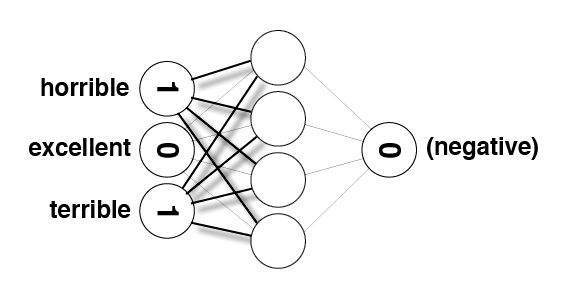

In [61]:
Image(filename='sentiment_network_sparse_2.png')

In [62]:
layer_1 = np.zeros(5)

In [63]:
for index in indices:
    layer_1 += (weights_0_1[index])

In [64]:
layer_1

array([-0.10503756,  0.44222989,  0.24392938, -0.55961832,  0.21389503])

# Project 5: Making our Network More Efficient<a id='project_5'></a>
**TODO:** Make the `SentimentNetwork` class more efficient by eliminating unnecessary multiplications and additions that occur during forward and backward propagation. To do that, you can do the following:
* Copy the `SentimentNetwork` class from the previous project into the following cell.
* Remove the `update_input_layer` function - you will not need it in this version.
* Modify `init_network`:
>* You no longer need a separate input layer, so remove any mention of `self.layer_0`
>* You will be dealing with the old hidden layer more directly, so create `self.layer_1`, a two-dimensional matrix with shape 1 x hidden_nodes, with all values initialized to zero
* Modify `train`:
>* Change the name of the input parameter `training_reviews` to `training_reviews_raw`. This will help with the next step.
>* At the beginning of the function, you'll want to preprocess your reviews to convert them to a list of indices (from `word2index`) that are actually used in the review. This is equivalent to what you saw in the video when Andrew set specific indices to 1. Your code should create a local `list` variable named `training_reviews` that should contain a `list` for each review in `training_reviews_raw`. Those lists should contain the indices for words found in the review.
>* Remove call to `update_input_layer`
>* Use `self`'s  `layer_1` instead of a local `layer_1` object.
>* In the forward pass, replace the code that updates `layer_1` with new logic that only adds the weights for the indices used in the review.
>* When updating `weights_0_1`, only update the individual weights that were used in the forward pass.
* Modify `run`:
>* Remove call to `update_input_layer` 
>* Use `self`'s  `layer_1` instead of a local `layer_1` object.
>* Much like you did in `train`, you will need to pre-process the `review` so you can work with word indices, then update `layer_1` by adding weights for the indices used in the review.

In [75]:
# TODO: -Copy the SentimentNetwork class from Project 4 lesson
#       -Modify it according to the above instructions 
#       -Modify it to reduce noise, like in the video 
import time
import sys
import numpy as np

# Encapsulate our neural network in a class
class SentimentNetwork:
    def __init__(self, reviews, labels, hidden_nodes = 10, learning_rate = 0.1):
        """Create a SentimenNetwork with the given settings
        Args:
            reviews(list) - List of reviews used for training
            labels(list) - List of POSITIVE/NEGATIVE labels associated with the given reviews
            hidden_nodes(int) - Number of nodes to create in the hidden layer
            learning_rate(float) - Learning rate to use while training
        
        """
        # Assign a seed to our random number generator to ensure we get
        # reproducable results during development 
        np.random.seed(1)

        # process the reviews and their associated labels so that everything
        # is ready for training
        self.pre_process_data(reviews, labels)
        
        # Build the network to have the number of hidden nodes and the learning rate that
        # were passed into this initializer. Make the same number of input nodes as
        # there are vocabulary words and create a single output node.
        self.init_network(len(self.review_vocab),hidden_nodes, 1, learning_rate)

    def pre_process_data(self, reviews, labels):
        
        review_vocab = set()
        # TODO: populate review_vocab with all of the words in the given reviews
        #       Remember to split reviews into individual words 
        #       using "split(' ')" instead of "split()".
        
        for review in reviews:
            words = review.split(' ')
            for word in words:
                review_vocab.add(word)
        # Convert the vocabulary set to a list so we can access words via indices
        self.review_vocab = list(review_vocab)
        
        label_vocab = set()
        # TODO: populate label_vocab with all of the words in the given labels.
        #       There is no need to split the labels because each one is a single word.
        
        for label in labels:
            label_vocab.add(label)
        # Convert the label vocabulary set to a list so we can access labels via indices
        self.label_vocab = list(label_vocab)
        
        # Store the sizes of the review and label vocabularies.
        self.review_vocab_size = len(self.review_vocab)
        self.label_vocab_size = len(self.label_vocab)
        
        # Create a dictionary of words in the vocabulary mapped to index positions
        self.word2index = {}
        # TODO: populate self.word2index with indices for all the words in self.review_vocab
        #       like you saw earlier in the notebook
        for index,word in enumerate(self.review_vocab):
            self.word2index[word] = index
        # Create a dictionary of labels mapped to index positions
        self.label2index = {}
        # TODO: do the same thing you did for self.word2index and self.review_vocab, 
        #       but for self.label2index and self.label_vocab instead
        for index,label in enumerate(self.label_vocab):
            self.label2index[label] = index
            
        
    def init_network(self, input_nodes, hidden_nodes, output_nodes, learning_rate):
        # Store the number of nodes in input, hidden, and output layers.
        self.input_nodes = input_nodes
        self.hidden_nodes = hidden_nodes
        self.output_nodes = output_nodes

        # Store the learning rate
        self.learning_rate = learning_rate

        # Initialize weights
        
        # TODO: initialize self.weights_0_1 as a matrix of zeros. These are the weights between
        #       the input layer and the hidden layer.
        self.weights_0_1 = np.zeros((input_nodes,hidden_nodes))
        
        # TODO: initialize self.weights_1_2 as a matrix of random values. 
        #       These are the weights between the hidden layer and the output layer.
        self.weights_1_2 = np.random.normal(0.0, self.output_nodes**-0.5, 
                                                (self.hidden_nodes, self.output_nodes))
        
        # TODO: Create the input layer, a two-dimensional matrix with shape 
        #       1 x input_nodes, with all values initialized to zero
        self.layer_1 = np.zeros((1,hidden_nodes))
    
                
    def get_target_for_label(self,label):
        # TODO: Copy the code you wrote for get_target_for_label 
        #       earlier in this notebook. 
        return 0 if label == 'NEGATIVE' else 1
        
    def sigmoid(self,x):
        # TODO: Return the result of calculating the sigmoid activation function
        #       shown in the lectures
        return 1 / ( 1 + np.exp(-x))
    
    def sigmoid_output_2_derivative(self,output):
        # TODO: Return the derivative of the sigmoid activation function, 
        #       where "output" is the original output from the sigmoid fucntion 
        return output * (1 - output)

    def train(self, training_reviews_raw, training_labels):
        
        # make sure out we have a matching number of reviews and labels
        assert(len(training_reviews_raw) == len(training_labels))
        #create a list of lists, each inner list contains the word2index index for a review
        training_reviews = list()
        

        for review in training_reviews_raw:
            review_indices = set()
            words = review.split(' ')
            for word in words:
                if word in self.word2index:
                    review_indices.add(self.word2index[word])
            training_reviews.append(list(review_indices))
        # Keep track of correct predictions to display accuracy during training 
        correct_so_far = 0
        
        # Remember when we started for printing time statistics
        start = time.time()

        # loop through all the given reviews and run a forward and backward pass,
        # updating weights for every item
        for i in range(len(training_reviews)):
            
            # TODO: Get the next review and its correct label
            review = training_reviews[i]
            label = training_labels[i]
            # TODO: Implement the forward pass through the network. 
            #       That means use the given review to update the input layer, 
            #       then calculate values for the hidden layer,
            #       and finally calculate the output layer.
            # 
            #       Do not use an activation function for the hidden layer,
            #       but use the sigmoid activation function for the output layer.
            
            #TODO:update hidden layer so self.layer_1 is used and its calculated optimally
            self.layer_1 *= 0
            self.layer_1 = sum(self.weights_0_1[review])
            
            output_layer_logits = np.dot(self.layer_1,self.weights_1_2)
            output_layer_predictions = self.sigmoid(output_layer_logits)
            #print("output layer",output_layer_predictions.shape)
            # TODO: Implement the back propagation pass here. (only update used weights)
            #       That means calculate the error for the forward pass's prediction
            #       and update the weights in the network according to their
            #       contributions toward the error, as calculated via the
            #       gradient descent and back propagation algorithms you 
            #       learned in class.
            error = output_layer_predictions - self.get_target_for_label(label)
            output_error_term = error*self.sigmoid_output_2_derivative(output_layer_predictions)
            hidden_error_term = self.weights_1_2*output_error_term
            
            delta_weights_h_o =  output_error_term * self.layer_1
            #TODO:Only update weights with input  = 1
            delta_weights_i_h = hidden_error_term#*layer0 #
            self.weights_1_2-= (self.learning_rate*delta_weights_h_o).reshape(self.weights_1_2.shape)
            self.weights_0_1[review]-= (self.learning_rate*delta_weights_i_h).T
            # Keep track of correct predictions.
            if(output_layer_predictions >= 0.5 and label == 'POSITIVE'):
                correct_so_far += 1
            elif(output_layer_predictions < 0.5 and label == 'NEGATIVE'):
                correct_so_far += 1
            
            # For debug purposes, print out our prediction accuracy and speed 
            # throughout the training process. 

            elapsed_time = float(time.time() - start)
            reviews_per_second = i / elapsed_time if elapsed_time > 0 else 0
            
            sys.stdout.write("\rProgress:" + str(100 * i/float(len(training_reviews)))[:4] \
                             + "% Speed(reviews/sec):" + str(reviews_per_second)[0:5] \
                             + " #Correct:" + str(correct_so_far) + " #Trained:" + str(i+1) \
                             + " Training Accuracy:" + str(correct_so_far * 100 / float(i+1))[:4] + "%")
            if(i % 2500 == 0):
                print("")
    
    def test(self, testing_reviews, testing_labels):
        """
        Attempts to predict the labels for the given testing_reviews,
        and uses the test_labels to calculate the accuracy of those predictions.
        """
        
        # keep track of how many correct predictions we make
        correct = 0

        # we'll time how many predictions per second we make
        start = time.time()

        # Loop through each of the given reviews and call run to predict
        # its label. 
        for i in range(len(testing_reviews)):
            pred = self.run(testing_reviews[i])
            if(pred == testing_labels[i]):
                correct += 1
            
            # For debug purposes, print out our prediction accuracy and speed 
            # throughout the prediction process. 

            elapsed_time = float(time.time() - start)
            reviews_per_second = i / elapsed_time if elapsed_time > 0 else 0
            
            sys.stdout.write("\rProgress:" + str(100 * i/float(len(testing_reviews)))[:4] \
                             + "% Speed(reviews/sec):" + str(reviews_per_second)[0:5] \
                             + " #Correct:" + str(correct) + " #Tested:" + str(i+1) \
                             + " Testing Accuracy:" + str(correct * 100 / float(i+1))[:4] + "%")
    
    def run(self, review):
        """
        Returns a POSITIVE or NEGATIVE prediction for the given review.
        """
        # TODO: Run a forward pass through the network, like you did in the
        #       "train" function. That means use the given review to 
        #       update the input layer, then calculate values for the hidden layer,
        #       and finally calculate the output layer.
        #
        #       Note: The review passed into this function for prediction 
        #             might come from anywhere, so you should convert it 
        #             to lower case prior to using it.
        review = review.lower()
        review_indices = set()
        
        words = review.split(' ')
        for word in words:
            if word in self.word2index:
                review_indices.add(self.word2index[word])
            
            
        hidden_output = sum(self.weights_0_1[list(review_indices)])
        output_logits = np.dot(hidden_output,self.weights_1_2)
        output = self.sigmoid(output_logits)
        # TODO: The output layer should now contain a prediction. 
        #       Return `POSITIVE` for predictions greater-than-or-equal-to `0.5`, 
        #       and `NEGATIVE` otherwise.
        return "POSITIVE" if output >= 0.5 else "NEGATIVE"

Run the following cell to recreate the network and train it once again.

In [76]:
mlp = SentimentNetwork(reviews[:-1000],labels[:-1000], learning_rate=0.1)
mlp.train(reviews[:-1000],labels[:-1000])

Progress:0.0% Speed(reviews/sec):0.0 #Correct:1 #Trained:1 Training Accuracy:100.%


Progress:6.85% Speed(reviews/sec):4093. #Correct:1136 #Trained:1645 Training Accuracy:69.0%

Progress:10.4% Speed(reviews/sec):4138. #Correct:1807 #Trained:2498 Training Accuracy:72.3%

Progress:10.4% Speed(reviews/sec):4126. #Correct:1809 #Trained:2501 Training Accuracy:72.3%


Progress:17.5% Speed(reviews/sec):4168. #Correct:3157 #Trained:4212 Training Accuracy:74.9%

Progress:20.8% Speed(reviews/sec):4140. #Correct:3779 #Trained:5001 Training Accuracy:75.5%


Progress:24.5% Speed(reviews/sec):4164. #Correct:4512 #Trained:5885 Training Accuracy:76.6%

Progress:27.9% Speed(reviews/sec):4148. #Correct:5183 #Trained:6697 Training Accuracy:77.3%

Progress:31.2% Speed(reviews/sec):4142. #Correct:5861 #Trained:7501 Training Accuracy:78.1%


Progress:34.9% Speed(reviews/sec):4163. #Correct:6619 #Trained:8398 Training Accuracy:78.8%

Progress:38.4% Speed(reviews/sec):4161. #Correct:7348 #Trained:9232 Training Accuracy:79.5%

Progress:41.6% Speed(reviews/sec):4152. #Correct:8003 #Trained:10001 Training Accuracy:80.0%


Progress:45.2% Speed(reviews/sec):4143. #Correct:8733 #Trained:10864 Training Accuracy:80.3%

Progress:48.7% Speed(reviews/sec):4147. #Correct:9450 #Trained:11711 Training Accuracy:80.6%

Progress:52.0% Speed(reviews/sec):4150. #Correct:10133 #Trained:12501 Training Accuracy:81.0%


Progress:55.8% Speed(reviews/sec):4156. #Correct:10912 #Trained:13413 Training Accuracy:81.3%

Progress:59.3% Speed(reviews/sec):4154. #Correct:11626 #Trained:14246 Training Accuracy:81.6%

Progress:62.3% Speed(reviews/sec):4121. #Correct:12235 #Trained:14966 Training Accuracy:81.7%

Progress:62.5% Speed(reviews/sec):4118. #Correct:12261 #Trained:15001 Training Accuracy:81.7%


Progress:69.1% Speed(reviews/sec):4111. #Correct:13586 #Trained:16587 Training Accuracy:81.9%

Progress:72.5% Speed(reviews/sec):4109. #Correct:14283 #Trained:17407 Training Accuracy:82.0%

Progress:72.9% Speed(reviews/sec):4084. #Correct:14368 #Trained:17501 Training Accuracy:82.0%


Progress:76.5% Speed(reviews/sec):3959. #Correct:15117 #Trained:18378 Training Accuracy:82.2%

Progress:79.3% Speed(reviews/sec):3929. #Correct:15714 #Trained:19043 Training Accuracy:82.5%

Progress:82.2% Speed(reviews/sec):3913. #Correct:16337 #Trained:19752 Training Accuracy:82.7%

Progress:83.3% Speed(reviews/sec):3913. #Correct:16552 #Trained:20001 Training Accuracy:82.7%


Progress:89.2% Speed(reviews/sec):3931. #Correct:17811 #Trained:21430 Training Accuracy:83.1%

Progress:92.7% Speed(reviews/sec):3937. #Correct:18535 #Trained:22257 Training Accuracy:83.2%

Progress:93.7% Speed(reviews/sec):3935. #Correct:18746 #Trained:22501 Training Accuracy:83.3%


Progress:99.5% Speed(reviews/sec):3946. #Correct:19978 #Trained:23904 Training Accuracy:83.5%

Progress:99.9% Speed(reviews/sec):3945. #Correct:20070 #Trained:24000 Training Accuracy:83.6%

That should have trained much better than the earlier attempts. Run the following cell to test your model with 1000 predictions.

In [77]:
mlp.test(reviews[-1000:],labels[-1000:])

Progress:65.1% Speed(reviews/sec):3237. #Correct:559 #Tested:652 Testing Accuracy:85.7%

Progress:99.9% Speed(reviews/sec):3292. #Correct:851 #Tested:1000 Testing Accuracy:85.1%

# End of Project 5. 
## Watch the next video to see Andrew's solution, then continue on to the next lesson.
# Further Noise Reduction<a id='lesson_6'></a>

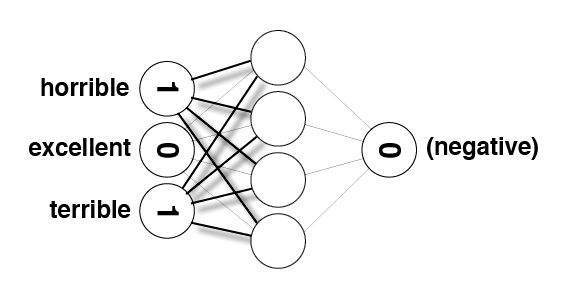

In [78]:
Image(filename='sentiment_network_sparse_2.png')

In [79]:
# words most frequently seen in a review with a "POSITIVE" label
pos_neg_ratios.most_common()

[('edie', 4.6913478822291435),
 ('paulie', 4.0775374439057197),
 ('felix', 3.1527360223636558),
 ('polanski', 2.8233610476132043),
 ('matthau', 2.8067217286092401),
 ('victoria', 2.6810215287142909),
 ('mildred', 2.6026896854443837),
 ('gandhi', 2.5389738710582761),
 ('flawless', 2.451005098112319),
 ('superbly', 2.2600254785752498),
 ('perfection', 2.1594842493533721),
 ('astaire', 2.1400661634962708),
 ('captures', 2.0386195471595809),
 ('voight', 2.0301704926730531),
 ('wonderfully', 2.0218960560332353),
 ('powell', 1.9783454248084671),
 ('brosnan', 1.9547990964725592),
 ('lily', 1.9203768470501485),
 ('bakshi', 1.9029851043382795),
 ('lincoln', 1.9014583864844796),
 ('refreshing', 1.8551812956655511),
 ('breathtaking', 1.8481124057791867),
 ('bourne', 1.8478489358790986),
 ('lemmon', 1.8458266904983307),
 ('delightful', 1.8002701588959635),
 ('flynn', 1.7996646487351682),
 ('andrews', 1.7764919970972666),
 ('homer', 1.7692866133759964),
 ('beautifully', 1.7626953362841438),
 ('socc

In [80]:
# words most frequently seen in a review with a "NEGATIVE" label
list(reversed(pos_neg_ratios.most_common()))[0:30]

[('boll', -4.8352824066183944),
 ('uwe', -4.5278461025535481),
 ('seagal', -3.606606956743819),
 ('unwatchable', -3.2324287912729042),
 ('stinker', -3.1843768086123894),
 ('mst', -2.9313391118177949),
 ('incoherent', -2.9182102225854769),
 ('unfunny', -2.6775828263201769),
 ('waste', -2.6057506568316997),
 ('blah', -2.5574420885289504),
 ('horrid', -2.4729780789227265),
 ('pointless', -2.443723518768643),
 ('atrocious', -2.4146593168481547),
 ('redeeming', -2.3576171050548607),
 ('prom', -2.3503097872423502),
 ('drivel', -2.3366365809470899),
 ('lousy', -2.2975727999267512),
 ('worst', -2.2771908066767406),
 ('laughable', -2.2547849053935245),
 ('awful', -2.2179631752505466),
 ('poorly', -2.2115829815780015),
 ('wasting', -2.1955788734265296),
 ('remotely', -2.1882648359647474),
 ('existent', -2.0714733720306593),
 ('boredom', -1.987774353154012),
 ('miserably', -1.9851235895077681),
 ('sucks', -1.9798005773223373),
 ('uninspired', -1.9760572894714397),
 ('lame', -1.9745380983043672),


In [81]:
from bokeh.models import ColumnDataSource, LabelSet
from bokeh.plotting import figure, show, output_file
from bokeh.io import output_notebook
output_notebook()

Loading BokehJS ...

In [82]:
hist, edges = np.histogram(list(map(lambda x:x[1],pos_neg_ratios.most_common())), density=True, bins=100, normed=True)

p = figure(tools="pan,wheel_zoom,reset,save",
           toolbar_location="above",
           title="Word Positive/Negative Affinity Distribution")
p.quad(top=hist, bottom=0, left=edges[:-1], right=edges[1:], line_color="#555555")
show(p)

In [83]:
frequency_frequency = Counter()

for word, cnt in total_counts.most_common():
    frequency_frequency[cnt] += 1

In [84]:
hist, edges = np.histogram(list(map(lambda x:x[1],frequency_frequency.most_common())), density=True, bins=100, normed=True)

p = figure(tools="pan,wheel_zoom,reset,save",
           toolbar_location="above",
           title="The frequency distribution of the words in our corpus")
p.quad(top=hist, bottom=0, left=edges[:-1], right=edges[1:], line_color="#555555")
show(p)

# Project 6: Reducing Noise by Strategically Reducing the Vocabulary<a id='project_6'></a>

**TODO:** Improve `SentimentNetwork`'s performance by reducing more noise in the vocabulary. Specifically, do the following:
* Copy the `SentimentNetwork` class from the previous project into the following cell.
* Modify `pre_process_data`:
>* Add two additional parameters: `min_count` and `polarity_cutoff`
>* Calculate the positive-to-negative ratios of words used in the reviews. (You can use code you've written elsewhere in the notebook, but we are moving it into the class like we did with other helper code earlier.)
>* Andrew's solution only calculates a postive-to-negative ratio for words that occur at least 50 times. This keeps the network from attributing too much sentiment to rarer words. You can choose to add this to your solution if you would like.  
>* Change so words are only added to the vocabulary if they occur in the vocabulary more than `min_count` times.
>* Change so words are only added to the vocabulary if the absolute value of their postive-to-negative ratio is at least `polarity_cutoff`
* Modify `__init__`:
>* Add the same two parameters (`min_count` and `polarity_cutoff`) and use them when you call `pre_process_data`

In [109]:
# TODO: -Copy the SentimentNetwork class from Project 5 lesson
#       -Modify it according to the above instructions 
# TODO: -Copy the SentimentNetwork class from Project 4 lesson
#       -Modify it according to the above instructions 
#       -Modify it to reduce noise, like in the video 
import time
import sys
import numpy as np

# Encapsulate our neural network in a class
class SentimentNetwork:
    def __init__(self, reviews, labels, hidden_nodes = 10, learning_rate = 0.1,min_count=50,polarity_cutoff=1):
        """Create a SentimenNetwork with the given settings
        Args:
            reviews(list) - List of reviews used for training
            labels(list) - List of POSITIVE/NEGATIVE labels associated with the given reviews
            hidden_nodes(int) - Number of nodes to create in the hidden layer
            learning_rate(float) - Learning rate to use while training
        
        """
        # Assign a seed to our random number generator to ensure we get
        # reproducable results during development 
        np.random.seed(1)

        # process the reviews and their associated labels so that everything
        # is ready for training
        self.pre_process_data(reviews, labels ,min_count,polarity_cutoff)
        
        # Build the network to have the number of hidden nodes and the learning rate that
        # were passed into this initializer. Make the same number of input nodes as
        # there are vocabulary words and create a single output node.
        self.init_network(len(self.review_vocab),hidden_nodes, 1, learning_rate)

    def pre_process_data(self, reviews, labels,min_count,polarity_cutoff):
        positive_counts = Counter()
        negative_counts = Counter()
        total_counts = Counter()
        pos_neg_ratios = Counter()
        review_vocab = set()
        # TODO: populate review_vocab with all of the words in the given reviews
        #       Remember to split reviews into individual words 
        #       using "split(' ')" instead of "split()".
        
        for index,label in enumerate(labels):
            words = reviews[index].split(' ')
            if label == 'POSITIVE':
                for word in words:
                    positive_counts[word]+=1
                    total_counts[word]+=1
                    #review_vocab.add(word)
            else:
                for word in words:
                    negative_counts[word]+=1
                    total_counts[word]+=1
                    
        for word in total_counts:
            count = total_counts[word]
            positive_count = positive_counts[word]
            negative_count = negative_counts[word] + 1
            word_positive_ratio  =  positive_count/negative_count
            word_positive_ratio = np.log(word_positive_ratio) if word_positive_ratio > 1 else  -np.log(1/(word_positive_ratio + 0.001))
            
            if count >= min_count and abs(word_positive_ratio)>= polarity_cutoff:
                review_vocab.add(word)
        # Convert the vocabulary set to a list so we can access words via indices
        self.review_vocab = list(review_vocab)
        
        label_vocab = set()
        # TODO: populate label_vocab with all of the words in the given labels.
        #       There is no need to split the labels because each one is a single word.
        
        for label in labels:
            label_vocab.add(label)
        # Convert the label vocabulary set to a list so we can access labels via indices
        self.label_vocab = list(label_vocab)
        
        # Store the sizes of the review and label vocabularies.
        self.review_vocab_size = len(self.review_vocab)
        self.label_vocab_size = len(self.label_vocab)
        
        # Create a dictionary of words in the vocabulary mapped to index positions
        self.word2index = {}
        # TODO: populate self.word2index with indices for all the words in self.review_vocab
        #       like you saw earlier in the notebook
        for index,word in enumerate(self.review_vocab):
            self.word2index[word] = index
        # Create a dictionary of labels mapped to index positions
        self.label2index = {}
        # TODO: do the same thing you did for self.word2index and self.review_vocab, 
        #       but for self.label2index and self.label_vocab instead
        for index,label in enumerate(self.label_vocab):
            self.label2index[label] = index
            
        
    def init_network(self, input_nodes, hidden_nodes, output_nodes, learning_rate):
        # Store the number of nodes in input, hidden, and output layers.
        self.input_nodes = input_nodes
        self.hidden_nodes = hidden_nodes
        self.output_nodes = output_nodes

        # Store the learning rate
        self.learning_rate = learning_rate

        # Initialize weights
        
        # TODO: initialize self.weights_0_1 as a matrix of zeros. These are the weights between
        #       the input layer and the hidden layer.
        self.weights_0_1 = np.zeros((input_nodes,hidden_nodes))
        
        # TODO: initialize self.weights_1_2 as a matrix of random values. 
        #       These are the weights between the hidden layer and the output layer.
        self.weights_1_2 = np.random.normal(0.0, self.output_nodes**-0.5, 
                                                (self.hidden_nodes, self.output_nodes))
        
        # TODO: Create the input layer, a two-dimensional matrix with shape 
        #       1 x input_nodes, with all values initialized to zero
        self.layer_1 = np.zeros((1,hidden_nodes))
    
                
    def get_target_for_label(self,label):
        # TODO: Copy the code you wrote for get_target_for_label 
        #       earlier in this notebook. 
        return 0 if label == 'NEGATIVE' else 1
        
    def sigmoid(self,x):
        # TODO: Return the result of calculating the sigmoid activation function
        #       shown in the lectures
        return 1 / ( 1 + np.exp(-x))
    
    def sigmoid_output_2_derivative(self,output):
        # TODO: Return the derivative of the sigmoid activation function, 
        #       where "output" is the original output from the sigmoid fucntion 
        return output * (1 - output)

    def train(self, training_reviews_raw, training_labels):
        
        # make sure out we have a matching number of reviews and labels
        assert(len(training_reviews_raw) == len(training_labels))
        #create a list of lists, each inner list contains the word2index index for a review
        training_reviews = list()
        

        for review in training_reviews_raw:
            review_indices = set()
            words = review.split(' ')
            for word in words:
                if word in self.word2index:
                    review_indices.add(self.word2index[word])
            training_reviews.append(list(review_indices))
        # Keep track of correct predictions to display accuracy during training 
        correct_so_far = 0
        
        # Remember when we started for printing time statistics
        start = time.time()

        # loop through all the given reviews and run a forward and backward pass,
        # updating weights for every item
        for i in range(len(training_reviews)):
            
            # TODO: Get the next review and its correct label
            review = training_reviews[i]
            label = training_labels[i]
            # TODO: Implement the forward pass through the network. 
            #       That means use the given review to update the input layer, 
            #       then calculate values for the hidden layer,
            #       and finally calculate the output layer.
            # 
            #       Do not use an activation function for the hidden layer,
            #       but use the sigmoid activation function for the output layer.
            
            #TODO:update hidden layer so self.layer_1 is used and its calculated optimally
            print("words:",review)
            self.layer_1 *= 0
            self.layer_1 = sum(self.weights_0_1[review])
            
            output_layer_logits = np.dot(self.layer_1,self.weights_1_2)
            output_layer_predictions = self.sigmoid(output_layer_logits)
            #if len(output_layer_predictions) > 1:
            print("logits",output_layer_logits,"layer1",self.layer_1,"weights",self.weights_1_2)
            #print("output layer",output_layer_predictions.shape)
            # TODO: Implement the back propagation pass here. (only update used weights)
            #       That means calculate the error for the forward pass's prediction
            #       and update the weights in the network according to their
            #       contributions toward the error, as calculated via the
            #       gradient descent and back propagation algorithms you 
            #       learned in class.
            error = output_layer_predictions - self.get_target_for_label(label)
            output_error_term = error*self.sigmoid_output_2_derivative(output_layer_predictions)
            hidden_error_term = self.weights_1_2*output_error_term
            
            delta_weights_h_o =  output_error_term * self.layer_1
            #TODO:Only update weights with input  = 1
            delta_weights_i_h = hidden_error_term#*layer0 #
            self.weights_1_2-= (self.learning_rate*delta_weights_h_o).reshape(self.weights_1_2.shape)
            self.weights_0_1[review]-= (self.learning_rate*delta_weights_i_h).T
            # Keep track of correct predictions.
            print(output_layer_predictions)
            if(output_layer_predictions >= 0.5 and label == 'POSITIVE'):
                correct_so_far += 1
            elif(output_layer_predictions < 0.5 and label == 'NEGATIVE'):
                correct_so_far += 1
            
            # For debug purposes, print out our prediction accuracy and speed 
            # throughout the training process. 

            elapsed_time = float(time.time() - start)
            reviews_per_second = i / elapsed_time if elapsed_time > 0 else 0
            
            sys.stdout.write("\rProgress:" + str(100 * i/float(len(training_reviews)))[:4] \
                             + "% Speed(reviews/sec):" + str(reviews_per_second)[0:5] \
                             + " #Correct:" + str(correct_so_far) + " #Trained:" + str(i+1) \
                             + " Training Accuracy:" + str(correct_so_far * 100 / float(i+1))[:4] + "%")
            if(i % 2500 == 0):
                print("")
    
    def test(self, testing_reviews, testing_labels):
        """
        Attempts to predict the labels for the given testing_reviews,
        and uses the test_labels to calculate the accuracy of those predictions.
        """
        
        # keep track of how many correct predictions we make
        correct = 0

        # we'll time how many predictions per second we make
        start = time.time()

        # Loop through each of the given reviews and call run to predict
        # its label. 
        for i in range(len(testing_reviews)):
            pred = self.run(testing_reviews[i])
            if(pred == testing_labels[i]):
                correct += 1
            
            # For debug purposes, print out our prediction accuracy and speed 
            # throughout the prediction process. 

            elapsed_time = float(time.time() - start)
            reviews_per_second = i / elapsed_time if elapsed_time > 0 else 0
            
            sys.stdout.write("\rProgress:" + str(100 * i/float(len(testing_reviews)))[:4] \
                             + "% Speed(reviews/sec):" + str(reviews_per_second)[0:5] \
                             + " #Correct:" + str(correct) + " #Tested:" + str(i+1) \
                             + " Testing Accuracy:" + str(correct * 100 / float(i+1))[:4] + "%")
    
    def run(self, review):
        """
        Returns a POSITIVE or NEGATIVE prediction for the given review.
        """
        # TODO: Run a forward pass through the network, like you did in the
        #       "train" function. That means use the given review to 
        #       update the input layer, then calculate values for the hidden layer,
        #       and finally calculate the output layer.
        #
        #       Note: The review passed into this function for prediction 
        #             might come from anywhere, so you should convert it 
        #             to lower case prior to using it.
        review = review.lower()
        review_indices = set()
        
        words = review.split(' ')
        for word in words:
            if word in self.word2index:
                review_indices.add(self.word2index[word])
            
            
        hidden_output = sum(self.weights_0_1[list(review_indices)])
        output_logits = np.dot(hidden_output,self.weights_1_2)
        output = self.sigmoid(output_logits)
        # TODO: The output layer should now contain a prediction. 
        #       Return `POSITIVE` for predictions greater-than-or-equal-to `0.5`, 
        #       and `NEGATIVE` otherwise.
        return "POSITIVE" if output >= 0.5 else "NEGATIVE"

Run the following cell to train your network with a small polarity cutoff.

In [110]:
mlp = SentimentNetwork(reviews[:-1000],labels[:-1000],min_count=20,polarity_cutoff=0.05,learning_rate=0.01)
mlp.train(reviews[:-1000],labels[:-1000])

words: [9347, 4611, 11781, 6662, 9994, 3343, 5650, 5011, 19, 9107, 2579, 9747, 7574, 11292, 157, 6301, 5280, 8099, 6950, 2092, 12076, 2734, 2607, 9646, 7473, 4786, 3507, 2100, 6452, 3122, 306, 10425, 9529, 59, 63, 8000, 9023, 3266, 7747, 6211, 8899, 11588, 3270, 10694, 5449, 3281, 11731, 979, 1494, 6999, 11480, 6745, 11867, 10461, 10463, 1760, 6625, 6756, 7146, 3563, 4588, 1131, 2286, 10478, 496, 9457, 429, 4857, 10870, 6517, 6265, 4476]
logits [ 0.] layer1 [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.] weights [[ 1.62434536]
 [-0.61175641]
 [-0.52817175]
 [-1.07296862]
 [ 0.86540763]
 [-2.3015387 ]
 [ 1.74481176]
 [-0.7612069 ]
 [ 0.3190391 ]
 [-0.24937038]]
[ 0.5]
Progress:0.0% Speed(reviews/sec):0.0 #Correct:1 #Trained:1 Training Accuracy:100.%
words: [11781, 9864, 5001, 3594, 11405, 5138, 9747, 5011, 1685, 4374, 1559, 9368, 2039, 11035, 5788, 7325, 4515, 10406, 9769, 11435, 9390, 2607, 1710, 8112, 4786, 7730, 2100, 6452, 1851, 59, 10558, 575, 6211, 10439, 3912, 4298, 10699, 8139, 8269, 

Progress:0.19% Speed(reviews/sec):320.7 #Correct:23 #Trained:48 Training Accuracy:47.9%words: [6019, 4611, 5254, 902, 6662, 4361, 5772, 11920, 5264, 9747, 1301, 1559, 7576, 3865, 3995, 6683, 11293, 8862, 7712, 2475, 6315, 2477, 1965, 10033, 4786, 7473, 2612, 6452, 4278, 2100, 10039, 11698, 11835, 12092, 1851, 10558, 192, 6211, 1859, 8899, 3270, 4803, 330, 5707, 11724, 8269, 1996, 7631, 7504, 5071, 6866, 11731, 6999, 3549, 10463, 1760, 9441, 7007, 2403, 6368, 8671, 6625, 10087, 9704, 6627, 11758, 112, 5105, 6512, 3315, 888, 10737, 2807, 9080, 2297, 6266, 1917, 9215]
logits [ 0.16762303] layer1 [ 0.019077   -0.00718473 -0.00620307 -0.0126014   0.01016372 -0.02703025
  0.02049181 -0.00893994  0.00374693 -0.00292871] weights [[ 1.62386795]
 [-0.61157661]
 [-0.52801652]
 [-1.07265326]
 [ 0.86515328]
 [-2.30086225]
 [ 1.74429894]
 [-0.76098317]
 [ 0.31894533]
 [-0.24929708]]
[ 0.54180791]
Progress:0.2% Speed(reviews/sec):319.5 #Correct:24 #Trained:49 Training Accuracy:48.9%words: [6017, 1190

 -0.17413586  0.07597004 -0.03184077  0.02488768] weights [[ 1.62545045]
 [-0.61217261]
 [-0.52853108]
 [-1.07369859]
 [ 0.86599639]
 [-2.3031045 ]
 [ 1.74599881]
 [-0.76172477]
 [ 0.31925615]
 [-0.24954003]]
[ 0.19375089]
Progress:0.42% Speed(reviews/sec):299.9 #Correct:68 #Trained:102 Training Accuracy:66.6%words: [3584, 11268, 11781, 6662, 1033, 9747, 19, 5139, 9239, 10266, 6683, 2588, 8738, 4132, 2598, 5162, 10283, 3628, 6701, 4654, 2607, 7730, 6195, 2100, 8758, 1081, 63, 9792, 7746, 6211, 7237, 10310, 8269, 7249, 2645, 7769, 6745, 11867, 3166, 2147, 3174, 11369, 4715, 10862, 4718, 2672, 4721, 5238, 6265, 6266, 9346, 131, 10374, 8335, 8850, 7316, 9368, 9369, 1692, 4773, 10407, 11432, 6315, 2734, 6832, 11441, 4786, 1718, 4283, 701, 11968, 5313, 3776, 8899, 10432, 10437, 3270, 10439, 9926, 1737, 9409, 11470, 9936, 2265, 2778, 2779, 5854, 2783, 1760, 8932, 6373, 6890, 10986, 7404, 1260, 754, 3315, 11000, 2297, 11519, 5888, 12034, 1286, 5383, 265, 6924, 3342, 2327, 7448, 8472, 6938, 28

logits [-1.24314983] layer1 [-0.14112707  0.05315088  0.04588884  0.09322212 -0.07518871  0.19996327
 -0.15159348  0.0661355  -0.02771889  0.0216659 ] weights [[ 1.62794726]
 [-0.61311295]
 [-0.52934295]
 [-1.07534787]
 [ 0.86732663]
 [-2.30664224]
 [ 1.74868079]
 [-0.76289484]
 [ 0.31974655]
 [-0.24992334]]
[ 0.22388819]
Progress:0.97% Speed(reviews/sec):302.7 #Correct:166 #Trained:234 Training Accuracy:70.9%words: [11777, 4611, 7688, 5640, 3083, 5645, 17, 3602, 9747, 19, 6163, 5139, 2579, 9243, 2588, 31, 4642, 5162, 2607, 7730, 3123, 2100, 3642, 59, 6211, 10310, 7753, 75, 6734, 11854, 6736, 2645, 10838, 6745, 11867, 8802, 11362, 5730, 10350, 2672, 4721, 1650, 6265, 6266, 6269, 5246, 11402, 10378, 9356, 11405, 1175, 6301, 8862, 1186, 5282, 5284, 10920, 6315, 9390, 2734, 4786, 5811, 6839, 8891, 4283, 3776, 5313, 11968, 1734, 10439, 4298, 5323, 7373, 2254, 6866, 7901, 9438, 2783, 1760, 10463, 1759, 12003, 8932, 12016, 3313, 3315, 250, 11015, 265, 5906, 275, 9491, 7448, 4890, 1309, 3869,

Progress:1.53% Speed(reviews/sec):333.3 #Correct:271 #Trained:369 Training Accuracy:73.4%words: [2561, 1027, 4611, 11268, 6662, 5132, 7695, 9747, 5659, 544, 8738, 549, 2607, 7730, 2100, 7224, 1081, 3130, 7230, 9792, 7232, 6211, 8260, 1605, 3576, 1098, 4171, 8269, 2645, 11864, 11867, 6236, 11362, 10859, 1131, 11891, 7801, 6265, 6266, 5246, 3199, 1150, 131, 8841, 5775, 8850, 9369, 5788, 5277, 7841, 1186, 5282, 8869, 5286, 3240, 6315, 2734, 2225, 4786, 3252, 1716, 11968, 9409, 5313, 8899, 705, 10437, 3270, 10438, 1744, 3282, 10964, 3803, 10463, 1760, 3306, 3315, 5364, 10491, 8978, 7443, 2322, 792, 2336, 1316, 7979, 12076, 7473, 6452, 822, 6966, 9528, 12092, 7485, 10558, 10049, 3912, 11597, 11087, 2896, 2898, 11606, 6999, 8024, 6495, 5476, 2918, 4978, 8567, 1913, 11651, 5518, 9615, 11153, 3991, 7066, 10651, 10652, 3492, 6567, 2475, 5549, 9648, 8629, 4023, 1985, 5062, 11206, 4553, 8142, 7631, 7123, 4053, 2006, 9692, 8671, 9184, 993, 6625, 6635, 7148, 496, 5105, 10737, 8184]
logits [-0.31190

logits [-0.67163309] layer1 [-0.0761012   0.02866102  0.02474505  0.05026899 -0.04054468  0.10782796
 -0.08174509  0.03566283 -0.0149471   0.0116831 ] weights [[ 1.63105188]
 [-0.6142822 ]
 [-0.53035244]
 [-1.07739864]
 [ 0.86898068]
 [-2.31104117]
 [ 1.75201565]
 [-0.76434973]
 [ 0.32035633]
 [-0.25039996]]
[ 0.33813126]
Progress:2.10% Speed(reviews/sec):351.3 #Correct:373 #Trained:506 Training Accuracy:73.7%words: [4611, 11268, 6662, 3083, 6156, 1549, 5134, 11790, 5645, 3596, 7186, 9747, 5139, 2579, 6683, 9251, 3628, 6701, 9772, 2607, 10801, 7730, 10289, 2100, 1589, 3638, 59, 9278, 2112, 6211, 2115, 9287, 9803, 8269, 6734, 2638, 2129, 7764, 7252, 2645, 10329, 1113, 11867, 6745, 5730, 2147, 101, 3688, 1131, 10859, 4204, 11886, 112, 1650, 8823, 5239, 6265, 6266, 2173, 1150, 5763, 3204, 7306, 2188, 4748, 7314, 5267, 10899, 5788, 5280, 1186, 1699, 5285, 1190, 6315, 2734, 6832, 4786, 11443, 1721, 4283, 702, 2751, 3776, 5313, 9409, 3270, 10438, 10950, 4812, 6348, 3790, 2769, 9428, 6868, 73

[ 0.57357352]
Progress:2.65% Speed(reviews/sec):362.8 #Correct:473 #Trained:638 Training Accuracy:74.1%words: [2944, 7042, 906, 5139, 1942, 9239, 156, 10665, 6452, 2100, 6839, 12092, 7485, 11199, 10944, 6211, 3270, 9158, 5449, 1228, 2652, 1760, 1121, 1634, 6625, 11362, 6128]
logits [-0.15915713] layer1 [-0.01802688  0.00678923  0.00586162  0.01190774 -0.00960424  0.02554233
 -0.01936381  0.00844783 -0.00354068  0.0027675 ] weights [[ 1.63167141]
 [-0.61451553]
 [-0.53055389]
 [-1.07780787]
 [ 0.86931075]
 [-2.31191898]
 [ 1.75268113]
 [-0.76464006]
 [ 0.32047801]
 [-0.25049507]]
[ 0.4602945]
Progress:2.65% Speed(reviews/sec):362.8 #Correct:473 #Trained:639 Training Accuracy:74.0%words: [1668, 906, 2059, 2572, 8850, 9747, 9365, 1559, 11294, 1698, 11042, 2425, 7211, 9516, 6701, 8494, 6190, 9648, 7473, 4786, 7985, 2100, 6452, 822, 5811, 9529, 9019, 12092, 1851, 5313, 6211, 3270, 2893, 11854, 6734, 2898, 7509, 2006, 7639, 11485, 10463, 1760, 6625, 9184, 1123, 6756, 867, 998, 6503, 2918, 10

 -0.06934541  0.03025324 -0.01267982  0.00991092] weights [[ 1.632216  ]
 [-0.61472063]
 [-0.53073096]
 [-1.0781676 ]
 [ 0.86960089]
 [-2.31269061]
 [ 1.75326611]
 [-0.76489527]
 [ 0.32058497]
 [-0.25057868]]
[ 0.36119953]
Progress:3.18% Speed(reviews/sec):367.6 #Correct:568 #Trained:766 Training Accuracy:74.1%words: [12034, 11651, 11781, 6662, 10504, 10505, 11786, 5772, 5518, 529, 8850, 2579, 9747, 5139, 3991, 279, 6424, 11674, 9121, 3237, 11176, 59, 4264, 4141, 8494, 2607, 8112, 302, 306, 4786, 6452, 7730, 9142, 8119, 952, 9529, 10552, 4283, 12092, 573, 10558, 2879, 6720, 9409, 5313, 6211, 6467, 10053, 3270, 11968, 3776, 5449, 8642, 8269, 11597, 3534, 6866, 1362, 2645, 2006, 6999, 6745, 2265, 11867, 2651, 7473, 1760, 6625, 8036, 11443, 2918, 742, 8823, 10859, 3563, 10987, 11631, 4596, 6517, 2039, 6265]
logits [ 2.00811487] layer1 [ 0.22736509 -0.0856296  -0.07392998 -0.15018703  0.12113402 -0.32215412
  0.24422718 -0.10654869  0.04465698 -0.03490521] weights [[ 1.6322698 ]
 [-0.61474

[ 0.11780564]
Progress:3.77% Speed(reviews/sec):370.0 #Correct:682 #Trained:906 Training Accuracy:75.2%words: [7171, 11781, 4358, 6662, 2443, 5139, 19, 9747, 9494, 6163, 792, 3995, 5277, 7460, 6954, 10667, 12076, 11309, 4779, 8112, 7473, 4786, 6452, 9527, 4283, 12092, 7485, 11968, 7233, 6211, 9924, 3270, 456, 11597, 11854, 7502, 5072, 7631, 3789, 3537, 1744, 7639, 6488, 6745, 3803, 10463, 1760, 1759, 2918, 10986, 3563, 2411, 6768, 10737, 6128, 1267, 10742, 2297, 6266, 10491, 5246]
logits [-0.52349832] layer1 [-0.05922757  0.02230612  0.01925842  0.03912304 -0.03155486  0.08391969
 -0.06362007  0.02775545 -0.01163294  0.00909265] weights [[ 1.63349765]
 [-0.61520332]
 [-0.53114771]
 [-1.07901421]
 [ 0.87028372]
 [-2.31450659]
 [ 1.75464281]
 [-0.76549588]
 [ 0.3208367 ]
 [-0.25077544]]
[ 0.37203457]
Progress:3.77% Speed(reviews/sec):370.0 #Correct:682 #Trained:907 Training Accuracy:75.1%words: [7171, 6662, 10, 9747, 19, 1055, 9251, 5162, 2607, 2100, 3642, 6211, 7754, 8269, 1104, 3154, 3

Progress:4.33% Speed(reviews/sec):375.1 #Correct:796 #Trained:1042 Training Accuracy:76.3%words: [8961, 5891, 9347, 11651, 6022, 906, 5518, 7314, 5139, 9747, 1938, 5526, 3991, 11034, 10011, 2588, 931, 11940, 2725, 4131, 1316, 3240, 6565, 6314, 8875, 5162, 7853, 2734, 6701, 11696, 7473, 4786, 6452, 1589, 2100, 10038, 9529, 59, 12092, 7485, 1215, 11968, 5313, 9794, 6211, 9409, 9157, 3270, 10702, 7631, 9167, 1362, 2387, 2645, 8407, 5465, 1882, 11867, 2778, 219, 10463, 1760, 8544, 3045, 11494, 4456, 6890, 3563, 6128, 1650, 9330, 114, 7541, 3576, 6265, 507, 5246]
logits [ 2.37294382] layer1 [ 0.26827506 -0.101037   -0.08723225 -0.17721029  0.14292975 -0.38011955
  0.28817115 -0.12572008  0.05269214 -0.04118573] weights [[ 1.63468596]
 [-0.61565086]
 [-0.5315341 ]
 [-1.07979915]
 [ 0.87091682]
 [-2.31619031]
 [ 1.75591925]
 [-0.76605275]
 [ 0.3210701 ]
 [-0.25095787]]
[ 0.91474073]
Progress:4.34% Speed(reviews/sec):375.2 #Correct:797 #Trained:1043 Training Accuracy:76.4%words: [5139, 5792, 7

logits [-1.19556852] layer1 [-0.1349481   0.05082378  0.04387969  0.08914058 -0.07189673  0.19120828
 -0.14495627  0.06323989 -0.02650528  0.02071731] weights [[ 1.63732488]
 [-0.61664472]
 [-0.53239217]
 [-1.0815423 ]
 [ 0.87232277]
 [-2.3199294 ]
 [ 1.75875388]
 [-0.76728941]
 [ 0.32158841]
 [-0.251363  ]]
[ 0.23226449]
Progress:4.91% Speed(reviews/sec):379.0 #Correct:914 #Trained:1181 Training Accuracy:77.3%words: [2561, 1544, 5645, 11790, 11791, 9747, 5139, 19, 2074, 5151, 9762, 8738, 2603, 2607, 9263, 7730, 6195, 2100, 7735, 59, 10812, 3646, 6211, 1093, 7238, 585, 11854, 6734, 10838, 7255, 11867, 3164, 11362, 11366, 2156, 11886, 2160, 1650, 10355, 3701, 5239, 6265, 9850, 6266, 3705, 2685, 131, 7811, 10888, 4234, 4235, 5775, 11408, 6290, 7316, 7322, 5788, 6301, 3743, 1186, 9381, 3754, 6315, 2734, 4786, 11443, 9909, 4283, 3260, 3776, 5313, 192, 11968, 3270, 4298, 4812, 2769, 6866, 3798, 4826, 2783, 1760, 10463, 8932, 6374, 1261, 4338, 7923, 4852, 3315, 2297, 8442, 11519, 7427, 6916,

 -0.07406379  0.03231172 -0.01354257  0.01058528] weights [[ 1.63652871]
 [-0.61634487]
 [-0.53213329]
 [-1.08101639]
 [ 0.87189859]
 [-2.31880131]
 [ 1.75789866]
 [-0.76691631]
 [ 0.32143204]
 [-0.25124077]]
[ 0.35193024]
Progress:5.45% Speed(reviews/sec):381.9 #Correct:1010 #Trained:1311 Training Accuracy:77.0%words: [5762, 6662, 1032, 2059, 3474, 5139, 9747, 1686, 10105, 5788, 7588, 2725, 4786, 7730, 6452, 1589, 3642, 12092, 9409, 5313, 6211, 9030, 9803, 10189, 11086, 5464, 11614, 1760, 10087, 4206, 5490, 2039, 3448, 3321, 12029]
logits [-1.74941964] layer1 [-0.19757163  0.07440888  0.06424235  0.13050683 -0.10526087  0.2799397
 -0.21222415  0.09258677 -0.03880522  0.0303313 ] weights [[ 1.6364268 ]
 [-0.61630649]
 [-0.53210015]
 [-1.08094907]
 [ 0.87184429]
 [-2.31865691]
 [ 1.75778919]
 [-0.76686855]
 [ 0.32141202]
 [-0.25122512]]
[ 0.14812041]
Progress:5.46% Speed(reviews/sec):381.9 #Correct:1011 #Trained:1312 Training Accuracy:77.0%words: [6153, 11791, 9747, 3605, 2076, 6701, 26

Progress:5.99% Speed(reviews/sec):384.0 #Correct:1105 #Trained:1439 Training Accuracy:76.7%words: [11268, 6160, 9747, 5139, 19, 4121, 1578, 5674, 8754, 2100, 3132, 1086, 6211, 1605, 8269, 8271, 2645, 2647, 87, 6745, 1623, 11867, 7772, 3680, 8289, 11362, 609, 10870, 631, 6265, 6266, 131, 7302, 5772, 7309, 1686, 9369, 156, 6301, 5788, 1186, 2725, 2727, 3240, 6825, 6315, 11949, 2734, 4786, 9908, 3773, 11968, 9409, 5313, 3270, 9940, 9943, 3291, 1760, 10465, 2796, 3315, 2293, 7426, 1800, 12050, 11035, 3357, 7457, 3363, 7979, 812, 8495, 7473, 6452, 12092, 7485, 10558, 3912, 6473, 5449, 11597, 11606, 6999, 344, 6510, 11651, 7048, 5518, 8080, 929, 424, 2473, 3499, 5551, 952, 8636, 1986, 10691, 2499, 8644, 1486, 7631, 2006, 7639, 6109, 3550, 9184, 6625, 4075, 6125, 2039, 10232, 1535]
logits [-0.01065318] layer1 [-0.00120348  0.00045325  0.00039132  0.00079496 -0.00064118  0.00170521
 -0.00129273  0.00056398 -0.00023638  0.00018476] weights [[ 1.63594758]
 [-0.61612601]
 [-0.53194433]
 [-1.08063

logits [-0.69596063] layer1 [-0.07858762  0.02959745  0.02555353  0.0519114  -0.04186937  0.11135098
 -0.08441591  0.03682803 -0.01543546  0.01206481] weights [[ 1.6366572 ]
 [-0.61639326]
 [-0.53217507]
 [-1.08110126]
 [ 0.87196705]
 [-2.31898337]
 [ 1.75803668]
 [-0.76697652]
 [ 0.32145727]
 [-0.2512605 ]]
[ 0.33270842]
Progress:6.52% Speed(reviews/sec):386.4 #Correct:1208 #Trained:1567 Training Accuracy:77.0%words: [4611, 3076, 11781, 4614, 9733, 3083, 10252, 6669, 11790, 3087, 9747, 19, 541, 4650, 554, 2607, 3120, 7730, 2100, 9277, 7233, 1091, 6211, 585, 8269, 11854, 6734, 6224, 3668, 2645, 1109, 3669, 1113, 11867, 5730, 2147, 100, 11364, 8806, 10856, 4206, 6265, 6266, 2173, 5246, 131, 7306, 8331, 6794, 10892, 5782, 10905, 9370, 668, 6301, 10397, 160, 5280, 1186, 6819, 3240, 6315, 11438, 4786, 5811, 5815, 8888, 2744, 2746, 1721, 4284, 10942, 11454, 3776, 9409, 5313, 3270, 6344, 7369, 4298, 3277, 1230, 8400, 6357, 2775, 10463, 1760, 8415, 4834, 736, 8932, 6373, 7923, 5880, 8441, 537

[ 0.90619402]
Progress:7.08% Speed(reviews/sec):388.9 #Correct:1317 #Trained:1702 Training Accuracy:77.3%words: [3073, 131, 9347, 11651, 11781, 135, 6152, 6662, 5772, 5134, 5775, 9747, 2039, 10004, 2965, 5139, 9369, 8860, 5277, 1186, 3492, 6315, 2734, 8112, 7473, 6832, 8243, 6452, 2100, 9142, 566, 5813, 1081, 10553, 1722, 12092, 6211, 9924, 3270, 7799, 3912, 11597, 11731, 5716, 11862, 2521, 5339, 11867, 9180, 9184, 1760, 1121, 11232, 10728, 6890, 6510, 1394, 1395, 3315, 1650, 4852, 3959, 4724, 2297, 8947, 5372, 9215]
logits [ 2.43554902] layer1 [ 0.27488313 -0.10352572 -0.08938093 -0.18157528  0.14645036 -0.38948254
  0.2952693  -0.12881678  0.05399004 -0.04220021] weights [[ 1.63747986]
 [-0.61670309]
 [-0.53244256]
 [-1.08164467]
 [ 0.87240534]
 [-2.320149  ]
 [ 1.75892036]
 [-0.76736204]
 [ 0.32161885]
 [-0.25138679]]
[ 0.91949824]
Progress:7.09% Speed(reviews/sec):389.0 #Correct:1318 #Trained:1703 Training Accuracy:77.3%words: [10368, 9602, 3972, 11781, 7046, 10118, 2059, 3211, 551

logits [-1.43873671] layer1 [-0.16237142  0.06115187  0.05279665  0.10725517 -0.08650714  0.23006445
 -0.17441338  0.07609111 -0.03189151  0.02492735] weights [[ 1.63756633]
 [-0.61673566]
 [-0.53247068]
 [-1.08170179]
 [ 0.87245141]
 [-2.32027152]
 [ 1.75901324]
 [-0.76740256]
 [ 0.32163584]
 [-0.25140007]]
[ 0.19174105]
Progress:7.67% Speed(reviews/sec):391.0 #Correct:1430 #Trained:1842 Training Accuracy:77.6%words: [11269, 6150, 11781, 4618, 5139, 19, 9747, 4116, 11318, 6211, 582, 10312, 8269, 11854, 6734, 7252, 2645, 11867, 5729, 8289, 100, 2661, 2159, 1650, 6265, 2681, 6266, 5246, 4738, 5772, 7822, 5273, 7323, 1186, 6819, 8364, 9390, 8370, 4786, 702, 8899, 3270, 7880, 6868, 1760, 232, 2793, 9450, 8947, 10504, 10515, 300, 7473, 3890, 7986, 6452, 311, 7992, 6969, 12092, 9020, 4938, 11597, 11087, 9559, 10603, 2425, 11651, 7046, 7053, 8080, 3995, 930, 3492, 8112, 6579, 9149, 446, 1986, 8644, 7631, 3031, 11740, 10718, 9184, 6625, 10728, 4075, 3054, 10737, 9721, 3069]
logits [ 0.5086007

  0.1148271  -0.05009548  0.02099615 -0.01641121] weights [[ 1.63855302]
 [-0.61710726]
 [-0.53279151]
 [-1.08235355]
 [ 0.87297709]
 [-2.32166955]
 [ 1.7600731 ]
 [-0.76786495]
 [ 0.32182963]
 [-0.25155154]]
[ 0.72066848]
Progress:8.21% Speed(reviews/sec):391.5 #Correct:1540 #Trained:1972 Training Accuracy:78.0%words: [11781, 9228, 5139, 3614, 2086, 6701, 2607, 5679, 7730, 2100, 6710, 8758, 7227, 9792, 6211, 8779, 1104, 6745, 3164, 3166, 11362, 101, 5746, 8823, 6265, 5246, 131, 132, 5775, 8850, 5779, 7316, 7317, 9368, 10401, 6315, 4786, 9409, 5313, 3270, 5338, 1760, 4833, 1253, 12034, 10011, 6941, 297, 7979, 12076, 9516, 7473, 6452, 9529, 9019, 12092, 5438, 1858, 4933, 5449, 5988, 11651, 1418, 6545, 5011, 11155, 6555, 9120, 7592, 8112, 10166, 6585, 6079, 7631, 10704, 466, 11731, 7639, 3549, 6625, 11750, 3563, 7148, 9712, 10737, 8190]
logits [ 2.06236377] layer1 [ 0.23263393 -0.08761394 -0.07564319 -0.15366739  0.12394112 -0.32961955
  0.24988677 -0.1090178   0.04569183 -0.03571409] we

logits [-3.38331342] layer1 [-0.38146444  0.14366607  0.12403689  0.25197805 -0.20323402  0.54049784
 -0.409755    0.17876331 -0.07492376  0.05856263] weights [[ 1.63913737]
 [-0.61732734]
 [-0.53298152]
 [-1.08273955]
 [ 0.87328841]
 [-2.32249752]
 [ 1.76070079]
 [-0.76813879]
 [ 0.32194441]
 [-0.25164125]]
[ 0.03282105]
Progress:8.74% Speed(reviews/sec):392.9 #Correct:1649 #Trained:2100 Training Accuracy:78.5%words: [11781, 19, 9747, 6174, 1070, 2607, 6202, 11838, 6211, 4189, 6237, 11874, 6756, 8294, 2665, 1131, 5740, 4721, 8819, 1140, 4724, 3193, 6266, 5246, 7296, 131, 8336, 2705, 9362, 2203, 8862, 11940, 11429, 176, 4786, 5811, 10933, 6330, 3776, 10437, 3270, 2247, 711, 5325, 206, 10967, 4312, 8408, 1760, 1770, 10986, 3314, 8948, 2297, 5371, 7945, 6954, 8494, 302, 9008, 7473, 7985, 6452, 10552, 12092, 10558, 8512, 3912, 2388, 7512, 9561, 7017, 1907, 3443, 11639, 11133, 3967, 11651, 7046, 1930, 2443, 5518, 5011, 3995, 1952, 10678, 10681, 8636, 445, 10694, 4048, 11219, 11731, 10198, 

logits [ 3.07938455] layer1 [ 0.34686387 -0.1306349  -0.11278617 -0.22912248  0.18479976 -0.49147221
  0.37258835 -0.16254866  0.06812784 -0.05325073] weights [[ 1.64071082]
 [-0.61791992]
 [-0.53349314]
 [-1.0837789 ]
 [ 0.8741267 ]
 [-2.32472694]
 [ 1.76239093]
 [-0.76887614]
 [ 0.32225345]
 [-0.25188281]]
[ 0.95603432]
Progress:9.3% Speed(reviews/sec):393.2 #Correct:1769 #Trained:2233 Training Accuracy:79.2%words: [11781, 1549, 8720, 9747, 2579, 6683, 2607, 2100, 11318, 3127, 6211, 7237, 5716, 2645, 2649, 11867, 11364, 5246, 131, 7306, 10383, 8850, 9369, 1186, 10920, 4266, 6315, 9390, 4786, 1718, 8888, 702, 5313, 3270, 1737, 8394, 3282, 3798, 11999, 1760, 8932, 2297, 11539, 10011, 6950, 8488, 809, 9516, 5423, 7473, 7985, 6452, 10552, 9529, 11065, 12092, 7996, 9023, 5449, 11597, 2898, 11606, 5462, 353, 2918, 5484, 3436, 9073, 6517, 3959, 11132, 5518, 2447, 5011, 3492, 10667, 11693, 8112, 5565, 6088, 9675, 7631, 2006, 6625, 6128, 2547, 3576]
logits [-2.7930469] layer1 [-0.31460938  0.

 [-0.25176221]]
[ 0.71920159]
Progress:9.86% Speed(reviews/sec):393.7 #Correct:1877 #Trained:2369 Training Accuracy:79.2%words: [12034, 131, 2307, 11651, 6662, 6152, 521, 9231, 1554, 5139, 7700, 2836, 9747, 2327, 9491, 409, 6301, 5282, 7203, 2595, 2088, 7592, 3499, 6701, 176, 9265, 4786, 1073, 6452, 3893, 8112, 2100, 10552, 11441, 1210, 59, 12092, 822, 10558, 1858, 1987, 6211, 10437, 3270, 585, 5324, 11597, 2898, 1875, 7764, 2645, 9046, 2006, 4312, 11867, 4828, 8156, 1760, 9704, 1131, 11504, 10737, 1650, 2547, 3315, 6265, 5246]
logits [-2.23661976] layer1 [-0.25204574  0.09492476  0.08195513  0.16648994 -0.13428321  0.35712419
 -0.27073822  0.11811463 -0.04950452  0.0386942 ] weights [[ 1.63998536]
 [-0.61764671]
 [-0.53325725]
 [-1.08329969]
 [ 0.8737402 ]
 [-2.32369904]
 [ 1.76161167]
 [-0.76853618]
 [ 0.32211096]
 [-0.25177144]]
[ 0.09650988]
Progress:9.87% Speed(reviews/sec):393.7 #Correct:1878 #Trained:2370 Training Accuracy:79.2%words: [4611, 6148, 6662, 522, 9747, 19, 5139, 9238

  0.28459137 -0.12415833  0.05203758 -0.04067411] weights [[ 1.63987991]
 [-0.61760699]
 [-0.53322296]
 [-1.08323004]
 [ 0.87368402]
 [-2.32354963]
 [ 1.7614984 ]
 [-0.76848676]
 [ 0.32209025]
 [-0.25175525]]
[ 0.9130067]
Progress:10.4% Speed(reviews/sec):394.2 #Correct:1981 #Trained:2497 Training Accuracy:79.3%words: [6147, 7171, 6662, 9740, 3087, 6671, 9747, 19, 6681, 8731, 9243, 11293, 5659, 7203, 2595, 2599, 9772, 6701, 1582, 2607, 5677, 2609, 7730, 2100, 11830, 63, 6720, 2114, 6211, 10310, 584, 3658, 8269, 6734, 4174, 1104, 83, 2645, 8792, 11867, 7261, 2144, 2147, 10851, 11366, 3688, 9330, 3699, 11380, 10870, 6265, 6266, 1146, 2685, 642, 131, 3204, 5766, 9864, 3211, 11405, 6290, 8850, 9369, 9370, 1693, 7326, 6301, 6303, 1186, 5282, 10920, 6315, 3243, 1708, 1710, 2734, 6832, 4267, 4786, 6322, 11443, 6846, 11968, 9409, 5313, 8899, 4803, 2758, 3270, 10950, 3785, 11464, 4299, 1744, 7377, 3282, 8917, 11479, 4312, 2265, 7896, 6360, 10463, 736, 1760, 10466, 6883, 4320, 5351, 10994, 3314,

[ 0.87017397]
Progress:10.9% Speed(reviews/sec):394.8 #Correct:2100 #Trained:2627 Training Accuracy:79.9%words: [10252, 5133, 9231, 5139, 19, 9747, 4637, 3106, 2598, 1578, 7730, 2100, 1077, 1589, 59, 6211, 8269, 1104, 2641, 2645, 11867, 8284, 4193, 6261, 117, 1150, 8835, 131, 5775, 6290, 9365, 5280, 4773, 1190, 6821, 6315, 1710, 2734, 177, 4786, 5299, 10432, 11968, 9409, 10437, 3270, 5326, 7377, 1760, 2804, 10491, 2307, 267, 4365, 9491, 6937, 7473, 7986, 7985, 6452, 9529, 1851, 12092, 8518, 11597, 9557, 8024, 3934, 11111, 5993, 362, 5995, 9073, 11651, 1933, 5518, 1942, 3991, 9629, 9121, 7587, 3492, 3499, 5040, 8629, 1976, 11198, 8132, 9184, 10723, 3563, 10737]
logits [-4.33969455] layer1 [-0.48860657  0.18401764  0.1588752   0.32275126 -0.26031647  0.69230778
 -0.52484312  0.22897267 -0.09596764  0.07501114] weights [[ 1.64144764]
 [-0.61819742]
 [-0.53373272]
 [-1.08426561]
 [ 0.87451926]
 [-2.32577095]
 [ 1.7631824 ]
 [-0.76922143]
 [ 0.32239817]
 [-0.25199593]]
[ 0.01287264]
Progres

logits [ 2.4604361] layer1 [ 0.27698657 -0.10431791 -0.09006489 -0.18296473  0.14757102 -0.39246292
  0.29752874 -0.1298025   0.05440318 -0.04252313] weights [[ 1.64164991]
 [-0.6182736 ]
 [-0.53379849]
 [-1.08439922]
 [ 0.87462703]
 [-2.32605755]
 [ 1.76339967]
 [-0.76931622]
 [ 0.3224379 ]
 [-0.25202698]]
[ 0.92132128]
Progress:11.5% Speed(reviews/sec):394.8 #Correct:2212 #Trained:2763 Training Accuracy:80.0%words: [3072, 8192, 514, 7171, 11268, 4, 11781, 6662, 1032, 3076, 4618, 4611, 9742, 5139, 9747, 19, 7190, 9243, 3100, 11293, 10271, 7203, 1572, 5162, 9259, 6701, 46, 2607, 9265, 7730, 8755, 2100, 6195, 1080, 1081, 11834, 7740, 7230, 1600, 7233, 6211, 1610, 11340, 8269, 6734, 3154, 7764, 2645, 6745, 3161, 11867, 6239, 11364, 101, 9318, 9831, 6756, 1131, 10860, 621, 4718, 4206, 10859, 1650, 6262, 1656, 6265, 6266, 3193, 11385, 121, 5246, 4223, 131, 654, 5775, 9359, 4754, 8850, 11927, 9368, 5788, 6301, 670, 8863, 5282, 1186, 11940, 10407, 1191, 7849, 8874, 2730, 11949, 7854, 3247, 1

[ 0.29803194]
Progress:12.0% Speed(reviews/sec):394.9 #Correct:2328 #Trained:2898 Training Accuracy:80.3%words: [5139, 9747, 19, 10777, 8218, 6683, 1563, 6174, 3103, 9251, 4133, 10801, 7730, 9268, 2100, 6211, 5190, 1104, 4690, 11867, 4718, 1650, 6265, 1146, 1150, 1668, 7316, 10914, 1186, 3236, 10920, 6315, 2734, 6321, 4786, 10935, 1728, 5313, 3270, 3282, 11482, 5339, 1760, 10491, 11011, 5383, 10002, 787, 7449, 4384, 801, 8480, 1316, 8485, 297, 8494, 6452, 9527, 10039, 9529, 1851, 12092, 11597, 2898, 2387, 6999, 7003, 354, 10087, 4476, 11133, 11651, 5518, 402, 8086, 3991, 930, 3492, 11693, 10681, 5562, 1986, 7635, 6107, 6625, 3045, 3563, 7148, 10737, 2039, 3069]
logits [ 3.00193776] layer1 [ 0.33773426 -0.12719653 -0.10981759 -0.22309188  0.17993575 -0.47853645
  0.36278166 -0.15827031  0.06633468 -0.05184915] weights [[ 1.64268292]
 [-0.61866265]
 [-0.53413439]
 [-1.08508158]
 [ 0.87517739]
 [-2.32752123]
 [ 1.76450929]
 [-0.76980032]
 [ 0.32264079]
 [-0.25218557]]
[ 0.95266159]
Progre

  0.32733279 -0.14280508  0.05985285 -0.04678275] weights [[ 1.64340404]
 [-0.61893424]
 [-0.53436887]
 [-1.08555791]
 [ 0.87556158]
 [-2.32854297]
 [ 1.76528388]
 [-0.77013825]
 [ 0.32278243]
 [-0.25229627]]
[ 0.93760217]
Progress:12.6% Speed(reviews/sec):394.7 #Correct:2441 #Trained:3035 Training Accuracy:80.4%words: [8706, 5, 1033, 8719, 9747, 5139, 7699, 2076, 7203, 36, 6701, 2607, 10289, 7730, 6720, 6211, 11331, 10310, 583, 7753, 8269, 2645, 6745, 11867, 5222, 4206, 2160, 4722, 9330, 6265, 6266, 9369, 173, 4786, 5811, 8887, 10944, 9409, 3270, 6344, 3790, 5328, 10462, 1759, 1760, 3296, 4847, 3314, 3315, 7923, 2297, 8954, 12029, 12033, 12034, 10504, 4365, 7440, 8985, 8988, 11037, 3871, 12076, 8494, 7473, 5938, 306, 6452, 9529, 4411, 12092, 7485, 10558, 11597, 6999, 9067, 3972, 902, 9094, 5518, 8592, 3486, 10668, 1965, 6065, 8629, 3509, 6070, 9142, 7631, 2006, 7639, 2521, 5083, 479, 9184, 6625, 3563, 7148, 6128, 7669, 6138]
logits [-0.68805826] layer1 [-0.07737579  0.02914105  0.0251

logits [ 1.65360179] layer1 [ 0.185903   -0.07001427 -0.06044817 -0.12279906  0.09904413 -0.26340638
  0.19969013 -0.08711857  0.03651337 -0.02853993] weights [[ 1.64388609]
 [-0.61911579]
 [-0.53452561]
 [-1.08587633]
 [ 0.8758184 ]
 [-2.32922599]
 [ 1.76580169]
 [-0.77036415]
 [ 0.32287711]
 [-0.25237028]]
[ 0.83937725]
Progress:13.2% Speed(reviews/sec):395.5 #Correct:2553 #Trained:3171 Training Accuracy:80.5%words: [11781, 6662, 9747, 5139, 3605, 10283, 6701, 2607, 7730, 2100, 1081, 1083, 6211, 582, 7246, 7252, 2645, 7764, 11867, 5730, 101, 10860, 9840, 6265, 6266, 2170, 125, 131, 10892, 5775, 4241, 8850, 11940, 10920, 6315, 6829, 2734, 8366, 176, 4786, 11443, 10938, 8891, 4283, 10942, 10948, 3270, 6866, 3282, 2783, 1760, 4833, 10987, 2297, 11001, 250, 10495, 7426, 2307, 10504, 5384, 9494, 12055, 9506, 11043, 12075, 8494, 7473, 7986, 6452, 1851, 12092, 9019, 8512, 331, 2898, 853, 6999, 4441, 8031, 7537, 9073, 4476, 9597, 5513, 9610, 5518, 2959, 409, 2977, 9648, 8629, 9655, 5565, 556

  0.21528794 -0.09392341  0.03936543 -0.03076918] weights [[ 1.64228943]
 [-0.61851446]
 [-0.53400644]
 [-1.08482166]
 [ 0.87496775]
 [-2.32696369]
 [ 1.76408662]
 [-0.76961592]
 [ 0.32256351]
 [-0.25212516]]
[ 0.8558244]
Progress:13.7% Speed(reviews/sec):395.8 #Correct:2649 #Trained:3303 Training Accuracy:80.1%words: [9728, 4611, 6662, 3594, 5645, 11790, 11791, 1552, 3602, 9747, 6163, 5650, 9240, 4635, 11293, 3106, 11816, 10283, 6701, 2607, 2100, 7739, 9788, 6720, 6211, 9795, 7237, 2630, 586, 6220, 6734, 11854, 5712, 2131, 2645, 3157, 5719, 5207, 11867, 1121, 101, 613, 9831, 7276, 11372, 9328, 7795, 10870, 6265, 3193, 6266, 1150, 131, 1668, 9347, 2695, 1672, 3211, 10892, 2191, 9359, 4241, 8850, 145, 7316, 5784, 6297, 9369, 4764, 1186, 6819, 1191, 8361, 9386, 6315, 1710, 4786, 9398, 3767, 4283, 4284, 9409, 10948, 10437, 3270, 4301, 6350, 3282, 2775, 3291, 10463, 1760, 4833, 12003, 232, 10987, 3314, 3315, 3830, 10998, 12024, 12029, 7427, 4873, 2826, 3343, 277, 2331, 7979, 4398, 7473, 10

logits [-2.96317548] layer1 [-0.33335251  0.12554629  0.10839282  0.2201975  -0.17760127  0.47232794
 -0.35807494  0.15621692 -0.06547406  0.05117646] weights [[ 1.64278534]
 [-0.61870123]
 [-0.53416769]
 [-1.08514923]
 [ 0.87523196]
 [-2.32766635]
 [ 1.76461931]
 [-0.76984831]
 [ 0.32266091]
 [-0.25220129]]
[ 0.04911748]
Progress:14.3% Speed(reviews/sec):395.4 #Correct:2764 #Trained:3441 Training Accuracy:80.3%words: [12034, 11011, 131, 5513, 9230, 3474, 5139, 5267, 3477, 1942, 9747, 10904, 409, 2074, 7700, 4124, 5277, 5284, 12092, 5162, 7979, 11948, 9386, 8366, 2607, 9390, 7473, 6449, 6195, 6452, 306, 4786, 10552, 1210, 59, 3642, 9019, 1214, 9663, 8000, 11968, 1858, 6211, 5313, 2117, 3270, 7238, 3912, 965, 3787, 4556, 11597, 2898, 6866, 2006, 9046, 7639, 9943, 6999, 4829, 10463, 2783, 10465, 10599, 11880, 3006, 1644, 8045, 5490, 2547, 6771, 8309, 3576, 6265, 6266, 11133, 6655]
logits [-3.53884313] layer1 [-0.39815008  0.14995017  0.12946238  0.26299982 -0.21212368  0.56413977
 -0.427

logits [-2.33366936] layer1 [-0.26243733  0.09883841  0.08533406  0.17335416 -0.13981957  0.37184806
 -0.28190048  0.12298438 -0.05154555  0.04028952] weights [[ 1.64339094]
 [-0.61892931]
 [-0.53436461]
 [-1.08554927]
 [ 0.8755546 ]
 [-2.32852442]
 [ 1.76526982]
 [-0.77013211]
 [ 0.32277986]
 [-0.25229426]]
[ 0.0883726]
Progress:14.8% Speed(reviews/sec):396.1 #Correct:2876 #Trained:3574 Training Accuracy:80.4%words: [6662, 5645, 7183, 1041, 1554, 9747, 19, 5139, 10774, 2579, 10268, 32, 549, 4649, 5162, 7724, 11309, 2607, 1071, 11825, 2100, 11320, 1081, 7224, 59, 6211, 2115, 2117, 10314, 8269, 5716, 11862, 9814, 10838, 6745, 2136, 2651, 11867, 5730, 11875, 9831, 3688, 103, 4203, 4718, 2671, 7792, 1650, 8819, 7799, 6265, 5241, 6266, 2685, 5246, 4735, 8321, 9347, 131, 4739, 2697, 3209, 5775, 8335, 9369, 156, 6301, 6813, 676, 11432, 5800, 10920, 6315, 7853, 2734, 4786, 1714, 10424, 4283, 11968, 5313, 10433, 5315, 3270, 11980, 1744, 7889, 6866, 8184, 2265, 6361, 3803, 10463, 1760, 12000, 2

 -0.02934977  0.01280439 -0.00536661  0.0041947 ] weights [[ 1.64277293]
 [-0.61869655]
 [-0.53416366]
 [-1.08514103]
 [ 0.87522534]
 [-2.32764876]
 [ 1.76460597]
 [-0.7698425 ]
 [ 0.32265847]
 [-0.25219939]]
[ 0.4395777]
Progress:15.4% Speed(reviews/sec):396.1 #Correct:2982 #Trained:3706 Training Accuracy:80.4%words: [10373, 11781, 1286, 11788, 10253, 9747, 5139, 19, 9886, 6049, 3875, 7721, 2477, 7473, 7730, 6452, 9529, 11577, 6585, 12092, 11968, 9409, 1986, 6211, 2116, 3270, 5193, 8269, 8024, 7513, 5083, 11867, 1760, 5090, 8036, 9573, 2417, 1650, 10099, 6266, 11133]
logits [ 0.75578487] layer1 [ 0.0850237  -0.03202139 -0.02764629 -0.05616279  0.04529835 -0.12047028
  0.09132932 -0.03984413  0.01669958 -0.01305288] weights [[ 1.64280252]
 [-0.6187077 ]
 [-0.53417328]
 [-1.08516058]
 [ 0.87524111]
 [-2.32769068]
 [ 1.76463776]
 [-0.76985636]
 [ 0.32266428]
 [-0.25220393]]
[ 0.68043789]
Progress:15.4% Speed(reviews/sec):396.1 #Correct:2983 #Trained:3707 Training Accuracy:80.4%words: [61

 -0.29606302  0.12916305 -0.05413517  0.04231365] weights [[ 1.64363451]
 [-0.61902104]
 [-0.53444381]
 [-1.08571015]
 [ 0.87568437]
 [-2.32886953]
 [ 1.76553145]
 [-0.77024625]
 [ 0.32282769]
 [-0.25233165]]
[ 0.07934536]
Progress:16.0% Speed(reviews/sec):396.1 #Correct:3102 #Trained:3842 Training Accuracy:80.7%words: [11268, 11781, 5644, 5645, 11790, 9231, 9747, 2579, 19, 7190, 6683, 1054, 8740, 6701, 6702, 6195, 2100, 2102, 11318, 5694, 10818, 6211, 7237, 7238, 7753, 7243, 8269, 6734, 10319, 8789, 2645, 10839, 3671, 1113, 6745, 11867, 3164, 2652, 5730, 7277, 7790, 10865, 1650, 9330, 9847, 631, 6265, 7799, 6266, 4228, 1668, 10892, 157, 1186, 2725, 3240, 1710, 9390, 4786, 2227, 7860, 1716, 2741, 10933, 2748, 9409, 705, 3270, 1228, 8915, 8412, 7903, 1760, 6368, 12002, 8932, 1767, 10986, 10987, 2796, 7410, 3315, 11000, 4857, 11008, 1284, 8978, 1301, 8470, 2841, 7962, 10011, 6427, 3368, 297, 7979, 6960, 7473, 306, 6452, 6966, 1337, 12092, 10558, 9030, 3912, 11597, 336, 2898, 8534, 11606,

  0.24891328 -0.10859309  0.04551383 -0.03557495] weights [[ 1.64237677]
 [-0.61854735]
 [-0.53403484]
 [-1.08487935]
 [ 0.87501428]
 [-2.32708744]
 [ 1.76418044]
 [-0.76965685]
 [ 0.32258066]
 [-0.25213857]]
[ 0.8868858]
Progress:16.5% Speed(reviews/sec):396.2 #Correct:3200 #Trained:3967 Training Accuracy:80.6%words: [131, 11139, 7045, 6662, 11655, 3972, 7565, 5518, 9747, 9107, 1686, 9369, 2076, 5788, 5280, 6265, 8352, 3363, 10149, 5162, 2477, 9390, 6701, 8112, 7473, 4786, 6578, 2100, 6452, 9910, 2734, 10681, 12092, 7485, 9151, 9409, 6211, 9795, 582, 10694, 6088, 8905, 11597, 8269, 466, 11092, 3925, 7639, 1367, 11867, 1760, 2401, 736, 9184, 3684, 6625, 7014, 9191, 9704, 10986, 7148, 6128, 5105, 496, 3315, 888, 10865, 8494, 2039, 3576, 4857, 6266, 12029, 5246, 3967]
logits [-0.97629509] layer1 [-0.1098572   0.04137411  0.03572114  0.07256667 -0.05852897  0.15565692
 -0.11800455  0.0514817  -0.02157715  0.01686534] weights [[ 1.64240307]
 [-0.61855726]
 [-0.53404339]
 [-1.08489672]
 [ 0

Progress:17.1% Speed(reviews/sec):394.4 #Correct:3327 #Trained:4115 Training Accuracy:80.8%words: [8192, 6662, 9223, 1033, 5132, 5139, 9747, 19, 2579, 7699, 7202, 11300, 5162, 2607, 2100, 1589, 59, 1086, 6720, 6211, 7237, 1098, 8269, 11854, 8271, 11867, 9819, 3684, 101, 613, 1656, 6265, 6266, 4219, 5246, 131, 5775, 9365, 1686, 9369, 5788, 5277, 5280, 1186, 6819, 11949, 9390, 5296, 4786, 8372, 6839, 5815, 4283, 1214, 9919, 11968, 9409, 10437, 3270, 10950, 4315, 2783, 1760, 8415, 8932, 3315, 7927, 2297, 9466, 12030, 12034, 2307, 4358, 7945, 1298, 9491, 12050, 11552, 9506, 10533, 4394, 7979, 12076, 8494, 7473, 6452, 11573, 9529, 12092, 7485, 320, 4932, 10053, 2373, 1351, 3912, 11597, 2896, 336, 2898, 9557, 4443, 9573, 4457, 5484, 11639, 11641, 1916, 3454, 9602, 7046, 11655, 5518, 10649, 7069, 3492, 3499, 2477, 9648, 8119, 1468, 10694, 5581, 7631, 10197, 8150, 8671, 9184, 6625, 9697, 9188, 6128, 10737, 7153]
logits [-8.46232723] layer1 [-0.95175331  0.35844667  0.30947188  0.62868492 -0.50

logits [ 1.40597288] layer1 [ 0.15819858 -0.05958031 -0.05143981 -0.10449878  0.08428396 -0.22415193
  0.16993107 -0.07413562  0.03107192 -0.02428673] weights [[ 1.64248551]
 [-0.6185883 ]
 [-0.5340702 ]
 [-1.08495117]
 [ 0.87507221]
 [-2.32724151]
 [ 1.76429724]
 [-0.7697078 ]
 [ 0.32260202]
 [-0.25215526]]
[ 0.80312998]
Progress:17.7% Speed(reviews/sec):393.4 #Correct:3440 #Trained:4255 Training Accuracy:80.8%words: [3202, 11781, 5772, 2958, 8335, 5267, 9747, 2579, 6683, 3357, 5538, 677, 2598, 1191, 2599, 8617, 6571, 6701, 9390, 9648, 177, 4786, 10930, 2100, 6452, 4532, 8629, 5170, 7473, 3642, 1851, 12092, 10557, 7614, 10558, 3776, 6211, 9924, 5572, 8269, 2511, 4048, 2769, 3794, 11731, 8015, 2645, 6999, 4312, 6745, 7641, 11867, 10463, 1760, 11232, 5602, 11362, 228, 7653, 998, 4454, 6501, 232, 6890, 10603, 11628, 112, 10737, 1777, 3315, 9073, 9080, 6265, 12029, 7038, 7039]
logits [-0.7985816] layer1 [-0.08985286  0.03384013  0.02921653  0.05935271 -0.04787119  0.12731273
 -0.09651662 

Progress:17.9% Speed(reviews/sec):391.9 #Correct:3491 #Trained:4310 Training Accuracy:80.9%words: [3602, 5139, 9747, 2588, 6685, 1573, 42, 6701, 2100, 11318, 5175, 6211, 10310, 10827, 8269, 78, 11854, 6734, 2645, 1622, 6745, 11867, 11362, 6756, 1637, 2663, 2668, 4206, 1650, 11385, 6265, 5246, 3717, 9861, 3210, 7314, 3219, 1186, 2211, 6819, 7853, 5811, 5303, 9409, 3270, 9930, 4818, 8918, 6361, 10463, 1760, 736, 3817, 3306, 12016, 12029, 8961, 3343, 11024, 6436, 4390, 1321, 6961, 7473, 6452, 8504, 9529, 12092, 3912, 3402, 8021, 11606, 9558, 8024, 354, 9062, 10087, 10600, 10605, 9076, 1913, 6022, 391, 7055, 1424, 3474, 7588, 10149, 2987, 2477, 4526, 2995, 5047, 952, 9151, 3523, 11207, 10187, 10189, 3534, 7639, 8671, 9184, 1511, 4075, 7148, 7662, 496, 10737, 8696, 10745]
logits [ 1.78084429] layer1 [ 0.20026549 -0.07542343 -0.06511828 -0.13228627  0.10669608 -0.28375664
  0.21511779 -0.09384918  0.03933432 -0.03074487] weights [[ 1.64341405]
 [-0.61893801]
 [-0.53437212]
 [-1.08556453]
 [ 

Progress:18.1% Speed(reviews/sec):391.1 #Correct:3513 #Trained:4347 Training Accuracy:80.8%words: [8192, 2051, 11268, 11781, 6662, 9731, 7171, 4615, 9738, 2059, 307, 5645, 9234, 9747, 8724, 19, 7190, 1558, 7704, 6683, 27, 7709, 11807, 6177, 4131, 8741, 3111, 3623, 2599, 6701, 2607, 10801, 1586, 6195, 2100, 6705, 7730, 5175, 8248, 1081, 2618, 2623, 6720, 10304, 9794, 6211, 6212, 2117, 1611, 8269, 6734, 1104, 7764, 2645, 8276, 1111, 3669, 10841, 9306, 5211, 11867, 3164, 2652, 3161, 1116, 3166, 6745, 1636, 101, 9830, 11367, 9831, 613, 1131, 9836, 4203, 4204, 112, 3699, 6265, 6266, 6269, 5246, 1150, 3712, 131, 9347, 9864, 5775, 9359, 11920, 8850, 5264, 1682, 10899, 6136, 5786, 9370, 9886, 670, 4256, 3748, 1190, 10920, 6315, 4779, 9390, 4786, 5811, 8372, 11443, 6841, 4281, 5308, 705, 11458, 4291, 8899, 5315, 10437, 3270, 5313, 5835, 3789, 3279, 9425, 6866, 722, 1234, 8920, 8409, 728, 8411, 9437, 10463, 1760, 4833, 736, 1759, 6374, 745, 6890, 7917, 3311, 1777, 2802, 3315, 7412, 2809, 2297, 5

  0.32370222 -0.14122117  0.059189   -0.04626387] weights [[ 1.64166248]
 [-0.61827834]
 [-0.53380258]
 [-1.08440752]
 [ 0.87463373]
 [-2.32607536]
 [ 1.76341317]
 [-0.76932211]
 [ 0.32244037]
 [-0.25202891]]
[ 0.93564973]
Progress:18.5% Speed(reviews/sec):381.7 #Correct:3602 #Trained:4455 Training Accuracy:80.8%words: [4611, 11790, 19, 9747, 5139, 7203, 9251, 6185, 6701, 2100, 6200, 1081, 9277, 9278, 6211, 585, 8269, 11854, 7252, 6745, 11867, 2671, 6265, 2681, 6266, 11909, 5261, 8335, 5264, 5267, 7315, 1686, 6301, 5280, 5282, 1186, 11941, 3238, 4263, 5291, 4779, 2734, 4786, 9395, 5301, 4283, 192, 5313, 5320, 10964, 2265, 3291, 8412, 3293, 5854, 1760, 7920, 3315, 7929, 6906, 11519, 9473, 258, 5383, 10507, 4883, 2336, 11552, 9506, 5420, 7473, 306, 11059, 6452, 1851, 10558, 6999, 3421, 10593, 1889, 7017, 5484, 2418, 11132, 1412, 8588, 5518, 2450, 3476, 7070, 9124, 7592, 11191, 11192, 7102, 1987, 7629, 10702, 977, 10197, 2006, 11740, 6128, 10737, 496, 10736]
logits [-1.67851526] layer1 [-

logits [-1.28167823] layer1 [-0.1442764   0.05433697  0.04691288  0.09530242 -0.07686659  0.20442556
 -0.15497638  0.06761135 -0.02833745  0.02214939] weights [[ 1.64176461]
 [-0.6183168 ]
 [-0.53383579]
 [-1.08447498]
 [ 0.87468813]
 [-2.32622006]
 [ 1.76352287]
 [-0.76936997]
 [ 0.32246042]
 [-0.25204459]]
[ 0.21726469]
Progress:18.8% Speed(reviews/sec):380.6 #Correct:3668 #Trained:4532 Training Accuracy:80.9%words: [11781, 11279, 9747, 11797, 6683, 7201, 2092, 6701, 3634, 2100, 11323, 6211, 8269, 2645, 4694, 7779, 1131, 10355, 6265, 5246, 5769, 9369, 6315, 4779, 10416, 4786, 9911, 8377, 1214, 7359, 3776, 9409, 4806, 3279, 732, 1760, 736, 5888, 7424, 12038, 1286, 288, 6436, 6950, 300, 7473, 2353, 11059, 6452, 5429, 3889, 9529, 6459, 12092, 9021, 10558, 7006, 9570, 5993, 7537, 11132, 898, 11651, 900, 11659, 1933, 10146, 8099, 5028, 10667, 3499, 1455, 8112, 3514, 3004, 5062, 10694, 4042, 9165, 10189, 7631, 4051, 11731, 2006, 10204, 4060, 3041, 6625, 9191, 7148, 5614, 5104]
logits [ 0.1

logits [-0.74243908] layer1 [-0.08360813  0.03148826  0.027186    0.05522772 -0.04454417  0.11846455
 -0.08980876  0.03918076 -0.01642155  0.01283556] weights [[ 1.64111685]
 [-0.61807284]
 [-0.53362517]
 [-1.0840471 ]
 [ 0.87434303]
 [-2.32530226]
 [ 1.76282708]
 [-0.76906642]
 [ 0.3223332 ]
 [-0.25194514]]
[ 0.32247102]
Progress:19.2% Speed(reviews/sec):381.0 #Correct:3733 #Trained:4619 Training Accuracy:80.8%words: [2944, 256, 11651, 9592, 1544, 5518, 6290, 9747, 5139, 3991, 8862, 1186, 1191, 552, 6186, 4266, 7473, 2866, 11443, 2100, 6452, 4150, 7858, 1081, 12092, 7485, 956, 8512, 6211, 10948, 7237, 10437, 582, 3912, 3270, 8394, 9675, 11597, 8269, 7631, 8658, 3922, 3282, 2645, 8534, 979, 7639, 11867, 10077, 3166, 10463, 1760, 7647, 10472, 11886, 496, 10737, 7153, 3315, 6260, 7923, 10870, 6128, 9840, 6265, 6266, 10491, 3966]
logits [-2.64793696] layer1 [-0.29821402  0.11231253  0.0969672   0.19698661 -0.15888043  0.42254014
 -0.32033049  0.13975019 -0.05857248  0.04578198] weights [[

 [-0.25184097]]
[ 0.09302654]
Progress:19.6% Speed(reviews/sec):381.2 #Correct:3811 #Trained:4716 Training Accuracy:80.8%words: [8961, 3458, 11651, 4484, 9719, 7046, 4618, 9483, 5518, 912, 5139, 9747, 2579, 3486, 3873, 3363, 8356, 2725, 10150, 8487, 11432, 1706, 6315, 3500, 5420, 8494, 11435, 8112, 9648, 4786, 12082, 2100, 6452, 9142, 2734, 7992, 59, 8636, 12092, 2879, 6720, 11968, 8642, 6211, 7615, 10437, 3270, 10954, 1610, 8269, 11597, 11854, 3917, 4690, 7252, 2645, 598, 7639, 6999, 11867, 3166, 1760, 6625, 741, 101, 9449, 7148, 7661, 6128, 10737, 2037, 2039, 2297, 1150]
logits [ 1.51602934] layer1 [ 0.1707928  -0.06432351 -0.05553495 -0.11281795  0.09099382 -0.24199671
  0.18345931 -0.08003757  0.03354556 -0.0262202 ] weights [[ 1.6404584 ]
 [-0.61782486]
 [-0.53341106]
 [-1.08361216]
 [ 0.87399222]
 [-2.3243693 ]
 [ 1.76211979]
 [-0.76875785]
 [ 0.32220387]
 [-0.25184406]]
[ 0.81995304]
Progress:19.6% Speed(reviews/sec):381.3 #Correct:3812 #Trained:4717 Training Accuracy:80.8%words

logits [ 0.9274934] layer1 [ 0.10447465 -0.03934695 -0.03397095 -0.0690112   0.05566129 -0.14803038
  0.11222281 -0.04895931  0.02051996 -0.01603901] weights [[ 1.64069201]
 [-0.61791284]
 [-0.53348702]
 [-1.08376647]
 [ 0.87411668]
 [-2.32470029]
 [ 1.76237072]
 [-0.76886733]
 [ 0.32224975]
 [-0.25187992]]
[ 0.71656647]
Progress:20.0% Speed(reviews/sec):381.4 #Correct:3895 #Trained:4815 Training Accuracy:80.8%words: [258, 6794, 10765, 9360, 7314, 9747, 19, 5267, 1558, 5139, 2197, 9370, 6811, 924, 11169, 6435, 2595, 421, 7846, 2214, 2297, 9637, 1962, 2599, 3628, 10927, 4786, 6452, 1721, 3642, 59, 12092, 11968, 10050, 6211, 10053, 968, 5458, 2006, 2390, 2142, 10463, 1760, 9184, 7908, 614, 10987, 11500, 12016, 11504, 8306, 496, 8816, 10737, 9716, 2039, 3448, 6265, 6266]
logits [-1.12000135] layer1 [-0.1261545   0.04751195  0.04102037  0.08333192 -0.06721173  0.1787486
 -0.1355105   0.059119   -0.02477812  0.01936731] weights [[ 1.64075215]
 [-0.61793549]
 [-0.53350658]
 [-1.0838062 ]
 [ 

Progress:20.4% Speed(reviews/sec):381.3 #Correct:3993 #Trained:4919 Training Accuracy:81.1%words: [11781, 6662, 9743, 7698, 9747, 19, 7190, 2076, 3612, 7713, 9767, 6184, 2607, 2100, 6211, 5704, 10829, 8269, 7764, 10330, 11867, 611, 101, 4206, 2687, 642, 6796, 3735, 10393, 2203, 5282, 1186, 3240, 7850, 4786, 11444, 9917, 3776, 5313, 9409, 1734, 8393, 10963, 212, 1760, 6374, 2291, 3315, 7419, 1278, 256, 7937, 265, 4362, 7945, 7450, 8494, 7473, 6452, 5429, 2360, 2362, 12092, 10558, 320, 3908, 9545, 1356, 8013, 8534, 6999, 4450, 2918, 5484, 6517, 900, 2950, 902, 3472, 10667, 2990, 3513, 10691, 5074, 2006, 7639, 6103, 10710, 9692, 9184, 6625, 3563, 7148, 6635, 6128, 6133, 1019]
logits [-1.23186435] layer1 [-0.13862107  0.05220708  0.04507399  0.09156677 -0.07385359  0.19641251
 -0.14890163  0.06496113 -0.02722669  0.02128118] weights [[ 1.64233149]
 [-0.6185303 ]
 [-0.53402012]
 [-1.08484944]
 [ 0.87499016]
 [-2.32702328]
 [ 1.7641318 ]
 [-0.76963563]
 [ 0.32257177]
 [-0.25213162]]
[ 0.2258

Progress:20.9% Speed(reviews/sec):381.4 #Correct:4073 #Trained:5025 Training Accuracy:81.0%words: [6657, 2051, 11781, 10250, 9747, 2579, 5139, 19, 8737, 2598, 3628, 6701, 2607, 5167, 9265, 6195, 2100, 54, 59, 6211, 7748, 579, 1094, 10824, 3146, 6734, 1103, 5199, 10319, 3161, 6745, 2651, 11867, 4187, 101, 631, 6265, 9850, 2170, 6266, 2685, 5246, 5763, 131, 1672, 9864, 7306, 5772, 5267, 1686, 6301, 11940, 164, 4779, 11443, 4283, 3776, 5313, 10948, 10437, 3270, 6866, 10455, 5339, 11485, 1757, 8415, 1760, 10463, 9445, 4838, 3814, 9453, 8945, 2803, 759, 2297, 9473, 12034, 2824, 4883, 11540, 798, 9516, 7473, 306, 7987, 6452, 5426, 7985, 7992, 11065, 12092, 7485, 10558, 5449, 3917, 5464, 6501, 11111, 9073, 1913, 6012, 1404, 3456, 899, 11651, 5513, 3469, 6035, 919, 7064, 409, 5015, 1432, 6045, 7076, 3499, 10667, 8112, 6072, 4028, 453, 9673, 4556, 7123, 6103, 11740, 7647, 8671, 6625, 9184, 11240, 10736, 10737, 3576, 4604, 10239]
logits [-4.43284887] layer1 [-0.49923151  0.18801918  0.16233     

 [-0.25200287]]
[ 0.51366349]
Progress:21.3% Speed(reviews/sec):381.9 #Correct:4169 #Trained:5136 Training Accuracy:81.1%words: [7808, 1922, 131, 7046, 6150, 5645, 7568, 9747, 5011, 3485, 800, 5282, 11433, 6315, 1580, 11693, 4786, 11059, 6452, 3776, 6211, 3270, 2890, 11854, 2511, 5083, 9692, 10463, 1760, 8544, 5090, 5730, 2530, 3688, 105, 9450, 11499, 7148, 2411, 12016, 1650, 6136, 6265]
logits [ 5.04391311] layer1 [ 0.56788167 -0.21387401 -0.18465227 -0.37511679  0.30255212 -0.80463285
  0.60999751 -0.26612287  0.11153814 -0.0871815 ] weights [[ 1.641485  ]
 [-0.6182115 ]
 [-0.53374487]
 [-1.08429029]
 [ 0.87453917]
 [-2.32582389]
 [ 1.76322253]
 [-0.76923894]
 [ 0.32240551]
 [-0.25200166]]
[ 0.99359285]
Progress:21.4% Speed(reviews/sec):381.9 #Correct:4170 #Trained:5137 Training Accuracy:81.1%words: [11781, 7688, 9747, 2579, 5139, 8216, 546, 6701, 2607, 2100, 2618, 4155, 9792, 6211, 2115, 10310, 5191, 3657, 2131, 6739, 7764, 4182, 2648, 3161, 6761, 7797, 6261, 3705, 6265, 6266, 5246,

  0.04300916 -0.01876355  0.00786423 -0.00614692] weights [[ 1.641559  ]
 [-0.61823937]
 [-0.53376894]
 [-1.08433917]
 [ 0.8745786 ]
 [-2.32592874]
 [ 1.76330202]
 [-0.76927362]
 [ 0.32242004]
 [-0.25201302]]
[ 0.58798647]
Progress:21.9% Speed(reviews/sec):382.0 #Correct:4275 #Trained:5264 Training Accuracy:81.2%words: [12033, 902, 8328, 8457, 8846, 2831, 1936, 7314, 2323, 9747, 5011, 3606, 3991, 1942, 792, 1818, 3474, 3223, 8862, 1186, 4131, 6266, 10791, 1321, 6315, 9772, 7473, 4786, 7986, 6452, 2100, 12092, 9277, 10558, 192, 6211, 6725, 2127, 10197, 8534, 344, 6745, 3928, 1760, 10465, 3554, 2401, 2039, 2918, 3563, 10987, 492, 4206, 10737, 1650, 3570, 9076, 5873, 3703, 2297, 8442, 11131]
logits [ 3.39966084] layer1 [ 0.38275543 -0.14415228 -0.12445666 -0.25283082  0.20392182 -0.54232705
  0.41114174 -0.1793683   0.07517733 -0.05876082] weights [[ 1.64150197]
 [-0.61821789]
 [-0.53375039]
 [-1.0843015 ]
 [ 0.87454821]
 [-2.32584793]
 [ 1.76324076]
 [-0.7692469 ]
 [ 0.32240884]
 [-0.252

Progress:22.4% Speed(reviews/sec):382.4 #Correct:4380 #Trained:5397 Training Accuracy:81.1%words: [12033, 131, 9990, 7046, 9353, 1418, 5772, 5518, 5775, 9747, 5139, 9235, 8851, 3349, 19, 1432, 5788, 544, 8993, 7458, 3492, 4773, 6950, 3624, 3369, 6315, 5679, 2607, 7473, 4786, 7986, 7730, 5555, 4794, 12092, 10812, 3776, 705, 7233, 6211, 7746, 3270, 11846, 3144, 5708, 11597, 9166, 5071, 3281, 2645, 8534, 3925, 6745, 5727, 11616, 1760, 4833, 3563, 3051, 6128, 10737, 7410, 3315, 112, 11639, 9848, 6265]
logits [-3.99845862] layer1 [-0.45035526  0.16961154  0.14643741  0.29748419 -0.2399372   0.63810941
 -0.48375498  0.2110472  -0.08845467  0.06913878] weights [[ 1.64083359]
 [-0.61796616]
 [-0.53353306]
 [-1.08385999]
 [ 0.87419211]
 [-2.3249009 ]
 [ 1.7625228 ]
 [-0.76893367]
 [ 0.32227756]
 [-0.25190166]]
[ 0.01801346]
Progress:22.4% Speed(reviews/sec):382.4 #Correct:4381 #Trained:5398 Training Accuracy:81.1%words: [7193, 7197, 2607, 6191, 2100, 6211, 6216, 2124, 11854, 2645, 7768, 6745, 6

 [-0.25178401]]
[ 0.74584591]
Progress:23.0% Speed(reviews/sec):382.4 #Correct:4490 #Trained:5531 Training Accuracy:81.1%words: [4611, 11268, 11781, 6662, 4109, 5645, 9743, 9747, 19, 27, 6683, 9259, 11308, 7212, 6701, 1586, 6195, 2100, 7730, 59, 6720, 6211, 2117, 582, 11335, 6216, 585, 3146, 8269, 6734, 4173, 5715, 2645, 11867, 5730, 101, 10853, 1131, 8306, 7799, 1656, 6265, 6266, 631, 2173, 5246, 1150, 3202, 131, 1668, 648, 5775, 9369, 1691, 5788, 1186, 5282, 10920, 4266, 6315, 2734, 4786, 5811, 8885, 4279, 11968, 5315, 9924, 10437, 3270, 205, 7886, 10447, 6866, 10463, 1760, 9955, 5348, 9962, 12016, 5362, 3315, 758, 9975, 2297, 12034, 11011, 4355, 10503, 4362, 3345, 8471, 6426, 8993, 9506, 6950, 809, 9516, 9518, 7473, 6452, 11063, 4921, 9529, 9019, 12092, 7485, 830, 2362, 3906, 4420, 3912, 11597, 11087, 336, 2898, 1362, 9046, 6999, 8024, 5464, 6501, 2918, 10599, 9073, 7537, 4980, 9592, 11651, 900, 5518, 9615, 3991, 409, 3492, 4006, 8112, 6580, 8629, 9142, 7099, 4028, 8642, 10187, 1018

 -0.0240534   0.01049375 -0.00439817  0.00343774] weights [[ 1.63923864]
 [-0.61736548]
 [-0.53301445]
 [-1.08280644]
 [ 0.87334237]
 [-2.32264101]
 [ 1.76080957]
 [-0.76818624]
 [ 0.3219643 ]
 [-0.2516568 ]]
[ 0.4505078]
Progress:23.5% Speed(reviews/sec):382.6 #Correct:4592 #Trained:5661 Training Accuracy:81.1%words: [8705, 11781, 1544, 11405, 1549, 5007, 3985, 3473, 9747, 5907, 19, 9879, 9368, 6391, 6301, 10654, 8993, 1186, 5282, 1828, 1956, 6266, 930, 424, 1321, 6315, 6187, 5294, 8112, 7473, 8113, 8624, 6452, 2100, 11443, 4916, 3642, 12092, 702, 9409, 578, 6211, 8260, 10949, 326, 1989, 10437, 8269, 5967, 721, 2898, 2387, 3794, 2645, 2006, 3154, 5339, 5215, 1760, 736, 352, 6625, 10463, 4197, 7144, 2281, 6122, 6633, 7148, 5484, 8941, 3563, 2544, 10737, 1650, 10355, 6900, 8692, 3315, 1527, 625, 6265, 9850, 11133]
logits [-0.27591502] layer1 [-0.03110774  0.01171571  0.01011498  0.02054835 -0.01657337  0.04407662
 -0.03341478  0.01457783 -0.0061099   0.00477568] weights [[ 1.63920818]
 

logits [-7.10674947] layer1 [-0.80079323  0.30159251  0.26038574  0.52896756 -0.42664115  1.13464578
 -0.8601825   0.37527077 -0.1572845   0.12293821] weights [[ 1.64012817]
 [-0.61770049]
 [-0.53330368]
 [-1.08339402]
 [ 0.87381628]
 [-2.32390139]
 [ 1.76176507]
 [-0.7686031 ]
 [ 0.32213901]
 [-0.25179336]]
[ 0.00081888]
Progress:24.1% Speed(reviews/sec):382.7 #Correct:4710 #Trained:5798 Training Accuracy:81.2%words: [131, 11781, 6662, 7945, 3471, 5775, 9747, 2579, 9368, 6301, 6050, 6818, 4261, 6315, 2477, 10491, 7473, 4786, 10801, 6452, 9269, 2100, 8758, 9529, 7993, 12092, 4028, 10558, 6720, 705, 5313, 6211, 10432, 2685, 3270, 3912, 8269, 11597, 4815, 8399, 7505, 11218, 11731, 6866, 2645, 10463, 1760, 6625, 11362, 8932, 10853, 998, 11367, 4718, 3701, 3576, 2297, 2043, 11132, 10109, 8062, 3967]
logits [ 1.18897975] layer1 [ 0.13397502 -0.0504573  -0.04356329 -0.0884978   0.0713783  -0.18982952
  0.14391102 -0.06278389  0.02631415 -0.02056792] weights [[ 1.64012817]
 [-0.61770049]
 [-0

Progress:24.7% Speed(reviews/sec):382.8 #Correct:4819 #Trained:5930 Training Accuracy:81.2%words: [5597, 11265, 11781, 6662, 2059, 8203, 9747, 5139, 19, 2579, 1559, 2039, 4630, 6683, 9775, 3103, 33, 7714, 2595, 7203, 2599, 10791, 7211, 6701, 2607, 7728, 11825, 6194, 4659, 7730, 9780, 2100, 6195, 7224, 1081, 5686, 59, 1076, 2105, 2614, 6720, 7233, 6211, 2115, 2117, 4166, 10310, 6728, 585, 4682, 3659, 1611, 2637, 6734, 7246, 2120, 7764, 2645, 1109, 3671, 2647, 6745, 11867, 7772, 3166, 11362, 5730, 100, 101, 3174, 9831, 10853, 5222, 10856, 10859, 10860, 8301, 6765, 112, 1650, 7794, 11380, 6770, 9330, 631, 4727, 6265, 6266, 125, 1150, 5246, 639, 3202, 131, 2178, 9346, 5420, 8328, 3211, 4749, 6290, 8850, 7316, 9877, 5784, 9368, 4760, 9369, 5788, 157, 670, 1695, 5280, 6303, 2725, 10920, 8361, 6315, 1710, 2734, 9391, 4786, 7346, 3252, 5811, 11443, 7866, 4283, 1214, 190, 3776, 11968, 7872, 8899, 5313, 1733, 3270, 9924, 6344, 9409, 4806, 5323, 10437, 205, 11845, 1744, 6866, 10964, 3803, 5854, 1

logits [ 0.83390878] layer1 [ 0.09410799 -0.03544269 -0.03060013 -0.06216346  0.05013821 -0.13334183
  0.10108733 -0.04410125  0.01848383 -0.01444751] weights [[ 1.6376429 ]
 [-0.6167645 ]
 [-0.53249558]
 [-1.08175237]
 [ 0.8724922 ]
 [-2.32038001]
 [ 1.75909549]
 [-0.76743845]
 [ 0.32165088]
 [-0.25141182]]
[ 0.69718079]
Progress:25.2% Speed(reviews/sec):382.8 #Correct:4921 #Trained:6065 Training Accuracy:81.1%words: [3585, 4099, 11781, 6662, 5645, 2576, 5139, 9747, 19, 3626, 5675, 6701, 6195, 2100, 59, 5184, 6211, 3576, 8268, 8269, 6734, 2645, 3673, 6745, 11867, 2651, 4206, 1647, 623, 6775, 6265, 6266, 5246, 1150, 131, 9347, 5766, 5772, 5775, 8850, 6301, 1186, 10914, 2725, 6315, 2734, 4786, 8372, 1214, 3776, 10437, 3270, 8412, 10463, 1760, 5352, 756, 10504, 4362, 2836, 279, 7458, 6435, 2852, 7979, 1838, 6452, 10550, 823, 9529, 10559, 10053, 6988, 11597, 7504, 2896, 5458, 8534, 6999, 4441, 9573, 4454, 2918, 5484, 7026, 6517, 7033, 10621, 900, 8581, 8586, 11147, 5516, 5518, 1936, 4507,

 -0.73380946  0.32013816 -0.13417717  0.10487684] weights [[ 1.63819082]
 [-0.61697085]
 [-0.53267374]
 [-1.0821143 ]
 [ 0.87278412]
 [-2.32115635]
 [ 1.75968404]
 [-0.76769521]
 [ 0.32175849]
 [-0.25149594]]
[ 0.00233943]
Progress:25.8% Speed(reviews/sec):383.1 #Correct:5040 #Trained:6194 Training Accuracy:81.3%words: [12034, 11651, 7046, 11783, 264, 5645, 3343, 6290, 5139, 8850, 9747, 4884, 7323, 2977, 8227, 5284, 11940, 6950, 3240, 2607, 8112, 7473, 4786, 5811, 6452, 11443, 8119, 2745, 12092, 10558, 6462, 9536, 6720, 1986, 6211, 11968, 3270, 6216, 5449, 1865, 7631, 2896, 1744, 6866, 2645, 6999, 1760, 9184, 11362, 7778, 100, 6122, 9067, 6128, 10224, 1650, 11251, 10100, 634, 1656, 6265, 6266]
logits [ 2.99619999] layer1 [ 0.33801306 -0.12730153 -0.10990824 -0.22327604  0.18008429 -0.47893148
  0.36308113 -0.15840096  0.06638944 -0.05189195] weights [[ 1.63819086]
 [-0.61697086]
 [-0.53267375]
 [-1.08211432]
 [ 0.87278414]
 [-2.32115641]
 [ 1.75968408]
 [-0.76769523]
 [ 0.3217585 ]
 [-

[ 0.99420234]
Progress:26.3% Speed(reviews/sec):383.3 #Correct:5161 #Trained:6329 Training Accuracy:81.5%words: [1, 12034, 12035, 131, 10504, 5518, 11662, 1806, 9747, 6804, 2039, 5011, 9502, 2466, 6950, 10925, 2734, 7473, 4786, 51, 6195, 6452, 10166, 3767, 952, 10552, 7355, 12092, 59, 6720, 11968, 11842, 4675, 6211, 9030, 11597, 11087, 3282, 9811, 86, 6745, 1760, 6625, 4833, 6496, 8932, 867, 2918, 3049, 3563, 1389, 2672, 9073, 112, 6128, 3056, 8567, 2936, 6265, 6266, 2685, 3454]
logits [-4.1473706] layer1 [-0.46767698  0.1761352   0.15206974  0.30892613 -0.24916575  0.6626526
 -0.50236133  0.21916457 -0.09185685  0.07179802] weights [[ 1.63890592]
 [-0.61724017]
 [-0.53290626]
 [-1.08258666]
 [ 0.8731651 ]
 [-2.32216958]
 [ 1.76045217]
 [-0.76803032]
 [ 0.32189895]
 [-0.25160572]]
[ 0.01555998]
Progress:26.3% Speed(reviews/sec):383.3 #Correct:5162 #Trained:6330 Training Accuracy:81.5%words: [10752, 6662, 5645, 9746, 9747, 19, 2579, 7705, 5162, 6701, 2607, 5679, 6195, 2100, 570, 10812, 

 -0.35786898  0.15612706 -0.0654364   0.05114702] weights [[ 1.63961561]
 [-0.61750745]
 [-0.53313702]
 [-1.08305545]
 [ 0.87354321]
 [-2.32317514]
 [ 1.7612145 ]
 [-0.7683629 ]
 [ 0.32203834]
 [-0.25171467]]
[ 0.04946513]
Progress:26.9% Speed(reviews/sec):383.6 #Correct:5275 #Trained:6462 Training Accuracy:81.6%words: [9731, 10504, 7945, 521, 9103, 9747, 9491, 10515, 1427, 8215, 5016, 792, 2077, 5280, 3490, 5162, 11819, 6315, 11693, 7473, 4786, 6452, 1337, 7614, 2240, 10433, 6211, 8899, 1604, 197, 708, 11720, 9421, 2893, 7631, 8016, 1875, 7635, 7639, 4312, 11867, 7900, 2783, 1760, 2914, 9573, 6122, 3563, 4460, 10737, 1650, 11635, 6265, 6395, 11133, 9343]
logits [ 0.0378168] layer1 [ 0.00426253 -0.00160534 -0.001386   -0.00281564  0.00227096 -0.00603959
  0.00457866 -0.00199752  0.00083721 -0.00065439] weights [[ 1.63962336]
 [-0.61751037]
 [-0.53313954]
 [-1.08306057]
 [ 0.87354733]
 [-2.32318612]
 [ 1.76122282]
 [-0.76836653]
 [ 0.32203986]
 [-0.25171586]]
[ 0.50945307]
Progress:26.9

  0.18471126 -0.08058376  0.03377448 -0.02639913] weights [[ 1.63962607]
 [-0.61751139]
 [-0.53314042]
 [-1.08306236]
 [ 0.87354878]
 [-2.32318996]
 [ 1.76122573]
 [-0.7683678 ]
 [ 0.32204039]
 [-0.25171628]]
[ 0.82136169]
Progress:27.4% Speed(reviews/sec):383.8 #Correct:5386 #Trained:6597 Training Accuracy:81.6%words: [11268, 11781, 10758, 1544, 8, 5645, 7184, 9747, 5139, 19, 11289, 7716, 9253, 8232, 1578, 1579, 4652, 6701, 5169, 7730, 2100, 1077, 54, 10805, 2104, 1081, 59, 9794, 6211, 7237, 8269, 6734, 3669, 4694, 2645, 11867, 3164, 5730, 101, 4715, 7277, 4206, 2159, 8305, 9330, 2680, 6265, 5246, 5763, 7822, 10385, 10899, 7829, 1686, 5784, 8866, 1186, 6315, 4269, 1710, 11951, 4786, 10418, 5811, 11960, 3776, 11968, 3270, 10438, 5324, 4815, 217, 10463, 1760, 6368, 9958, 3315, 2297, 8961, 10506, 6925, 8465, 8978, 9491, 7956, 6933, 10515, 11037, 10016, 10532, 297, 7473, 9521, 12083, 6452, 308, 4917, 7992, 12092, 10558, 3912, 5453, 2896, 2384, 9557, 4444, 8036, 10597, 2918, 9062, 10600, 5

Progress:28.0% Speed(reviews/sec):383.9 #Correct:5505 #Trained:6727 Training Accuracy:81.8%words: [3073, 6662, 9747, 10775, 10265, 9243, 2588, 2086, 9767, 5162, 6189, 2607, 1586, 2100, 1081, 6211, 10309, 1098, 8269, 7252, 7259, 11867, 3166, 1650, 5239, 6265, 6778, 2685, 1150, 6270, 5246, 7807, 131, 3210, 2705, 7315, 5267, 9368, 9369, 5282, 6315, 7853, 4786, 11968, 705, 8899, 3270, 6344, 5321, 9421, 8399, 10969, 2778, 2783, 1760, 5880, 256, 1792, 11535, 5397, 7446, 3866, 7458, 3882, 7979, 7473, 11057, 6452, 1851, 12092, 4411, 10558, 8518, 2896, 6999, 352, 10082, 1392, 10100, 7035, 10110, 9091, 5011, 3990, 408, 7066, 11165, 3499, 9648, 8116, 8629, 3007, 1993, 11728, 466, 4060, 9184, 6625, 7648, 10737, 6133, 3578, 3069, 5630]
logits [ 0.24723652] layer1 [ 0.02784936 -0.01048855 -0.00905549 -0.01839602  0.01483739 -0.03945983
  0.02991476 -0.01305087  0.00546992 -0.00427545] weights [[ 1.64068247]
 [-0.61790925]
 [-0.53348392]
 [-1.08376017]
 [ 0.8741116 ]
 [-2.32468678]
 [ 1.76236048]
 [-

logits [-1.13019269] layer1 [-0.12737797  0.04797274  0.04141819  0.08414009 -0.06786356  0.18048214
 -0.13682471  0.05969235 -0.02501842  0.01955513] weights [[ 1.63977909]
 [-0.61756902]
 [-0.53319018]
 [-1.08316344]
 [ 0.8736303 ]
 [-2.32340678]
 [ 1.7613901 ]
 [-0.76843951]
 [ 0.32207045]
 [-0.25173977]]
[ 0.24412554]
Progress:28.5% Speed(reviews/sec):383.9 #Correct:5611 #Trained:6856 Training Accuracy:81.8%words: [11265, 6147, 11268, 4611, 6662, 2569, 3087, 3602, 9747, 5139, 5650, 19, 1554, 7704, 3611, 10268, 11293, 2078, 31, 11292, 2588, 6186, 1578, 4652, 8237, 557, 2607, 559, 6705, 6195, 9268, 2100, 8758, 8755, 1076, 8250, 59, 10812, 8765, 6206, 10816, 2625, 4162, 6211, 7237, 10310, 11848, 585, 7753, 1611, 1098, 8269, 6734, 11854, 10319, 1610, 5716, 2645, 10838, 2647, 9304, 6745, 11867, 3675, 605, 3166, 4192, 11362, 5730, 3684, 101, 7270, 4203, 6764, 9325, 4718, 6768, 6128, 1650, 9330, 6265, 6266, 2685, 1150, 131, 11910, 5255, 7302, 3210, 7819, 6796, 652, 7822, 8335, 9368, 9369,

  0.23470482 -0.10239439  0.04291581 -0.03354427] weights [[ 1.64093835]
 [-0.61800562]
 [-0.53356712]
 [-1.08392919]
 [ 0.87424793]
 [-2.32504934]
 [ 1.76263534]
 [-0.76898277]
 [ 0.32229814]
 [-0.25191774]]
[ 0.87435959]
Progress:29.1% Speed(reviews/sec):384.1 #Correct:5728 #Trained:6987 Training Accuracy:81.9%words: [4608, 3074, 6150, 7687, 4626, 9747, 19, 6174, 4639, 549, 6701, 2607, 2100, 1081, 2623, 6720, 6211, 7238, 6216, 8269, 10319, 1104, 4177, 2641, 7252, 2645, 3158, 2649, 11867, 11362, 101, 4199, 10860, 4204, 11886, 8820, 10870, 6265, 6266, 5246, 131, 7306, 5774, 7314, 1186, 10404, 11940, 6315, 2734, 4786, 11443, 7866, 3776, 5313, 3270, 8903, 4298, 6866, 1235, 4312, 11485, 10463, 1760, 3814, 8424, 9962, 10987, 12016, 3315, 7923, 2297, 3833, 3838, 4350, 267, 3851, 9997, 8978, 1310, 1316, 297, 7979, 12076, 816, 7473, 7986, 306, 6452, 6964, 8501, 9528, 9529, 1338, 3387, 12092, 7992, 10558, 1851, 320, 2882, 11597, 7502, 7505, 1362, 6483, 2898, 8534, 11606, 1882, 8036, 8037, 2918

Progress:29.6% Speed(reviews/sec):383.9 #Correct:5835 #Trained:7117 Training Accuracy:81.9%words: [11781, 9747, 19, 4627, 9238, 5669, 1071, 7216, 4145, 7730, 6195, 2100, 3642, 6211, 9795, 3662, 3154, 2647, 6745, 11867, 100, 101, 1131, 10350, 7799, 6265, 6266, 5243, 9853, 6269, 642, 131, 5775, 7316, 7835, 6301, 8862, 11424, 1186, 2734, 7855, 5811, 11446, 705, 9409, 9924, 3270, 4312, 5854, 1760, 10986, 3306, 12015, 12016, 2297, 4857, 4352, 12034, 2307, 7939, 11525, 8978, 1309, 4388, 298, 5420, 7473, 6452, 2362, 1851, 12092, 10558, 11597, 11606, 5478, 10599, 9576, 6512, 10105, 4476, 5504, 7045, 5518, 9615, 11156, 3492, 2477, 8636, 7109, 2504, 979, 2006, 7639, 7647, 8673, 5611, 7153, 10737, 8691, 5111]
logits [-3.96690411] layer1 [-0.44694739  0.16832808  0.14532931  0.2952331  -0.23812158  0.63328079
 -0.48009437  0.20945019 -0.08778533  0.0686156 ] weights [[ 1.64029693]
 [-0.61776405]
 [-0.53335856]
 [-1.0835055 ]
 [ 0.8739062 ]
 [-2.32414051]
 [ 1.76194635]
 [-0.76868218]
 [ 0.32217216

Progress:30.1% Speed(reviews/sec):384.1 #Correct:5948 #Trained:7247 Training Accuracy:82.0%words: [11781, 3596, 5139, 9747, 6174, 6177, 5665, 9762, 7717, 5162, 2100, 10294, 9789, 6722, 6211, 7764, 2645, 6745, 100, 5740, 1653, 6265, 1150, 3200, 131, 10371, 3719, 7817, 145, 2725, 11432, 10920, 2734, 6832, 4786, 4283, 10432, 5313, 11968, 4803, 10437, 3270, 6344, 5835, 10446, 3281, 2783, 1760, 10470, 9962, 10491, 3325, 3343, 9491, 2336, 7473, 6452, 11065, 9530, 1851, 7482, 12092, 11597, 2898, 9046, 5464, 10599, 5995, 6510, 1913, 3456, 10126, 5518, 10145, 10149, 9638, 10667, 9648, 10681, 1986, 10691, 10694, 1993, 460, 9679, 7631, 979, 7639, 3550, 9184, 6625, 2016, 11235, 3563, 7148, 10737, 2047]
logits [-3.0694024] layer1 [-0.34579641  0.13023288  0.11243908  0.22841737 -0.18423105  0.48995973
 -0.37144173  0.16204843 -0.06791818  0.05308685] weights [[ 1.64044064]
 [-0.61781817]
 [-0.53340529]
 [-1.08360043]
 [ 0.87398276]
 [-2.32434413]
 [ 1.76210072]
 [-0.76874953]
 [ 0.32220038]
 [-0.25

Progress:30.7% Speed(reviews/sec):384.1 #Correct:6058 #Trained:7380 Training Accuracy:82.0%words: [3073, 7045, 6662, 4613, 5257, 6921, 9, 653, 9742, 912, 11153, 9747, 7316, 5139, 8471, 9239, 3361, 546, 7203, 6050, 6954, 2859, 3374, 2607, 8112, 7473, 4786, 11443, 6452, 2100, 9528, 6457, 9529, 1851, 12092, 9280, 6211, 10819, 3270, 8139, 850, 2898, 2132, 9814, 856, 11867, 2268, 1760, 6625, 5730, 9573, 11367, 366, 9201, 10100, 6261, 6517, 2039, 6265, 6266, 7675, 5246]
logits [ 1.62817709] layer1 [ 0.18353301 -0.06912169 -0.05967755 -0.12123355  0.09778146 -0.26004834
  0.19714438 -0.08600794  0.03604788 -0.02817609] weights [[ 1.63951212]
 [-0.61746847]
 [-0.53310337]
 [-1.08298709]
 [ 0.87348807]
 [-2.32302851]
 [ 1.76110333]
 [-0.7683144 ]
 [ 0.32201801]
 [-0.25169878]]
[ 0.83591977]
Progress:30.7% Speed(reviews/sec):384.1 #Correct:6059 #Trained:7381 Training Accuracy:82.0%words: [9346, 4611, 3842, 11781, 3206, 6662, 2183, 12034, 11268, 5518, 3474, 9747, 19, 21, 3991, 4122, 6301, 7584, 5

  0.31446049 -0.1371893   0.05749915 -0.04494303] weights [[ 1.6396818 ]
 [-0.61753238]
 [-0.53315855]
 [-1.08309918]
 [ 0.87357847]
 [-2.32326894]
 [ 1.7612856 ]
 [-0.76839392]
 [ 0.32205134]
 [-0.25172483]]
[ 0.93068999]
Progress:31.2% Speed(reviews/sec):384.0 #Correct:6171 #Trained:7509 Training Accuracy:82.1%words: [131, 10504, 1288, 10126, 8848, 6674, 9747, 3738, 2203, 10011, 6174, 5280, 5538, 3363, 3238, 2598, 10667, 11820, 2477, 2734, 1710, 2607, 7473, 4786, 7214, 6452, 2100, 8494, 952, 1081, 1721, 12092, 11580, 7614, 10432, 9409, 3776, 6211, 5313, 3270, 5449, 9930, 9675, 4942, 6734, 3534, 7377, 2898, 6866, 11470, 2645, 2006, 12076, 6745, 11867, 1760, 2016, 9184, 6625, 10724, 2918, 9831, 10599, 9704, 10986, 6888, 7148, 2670, 12016, 10737, 3315, 12022, 2039, 3576, 6265, 1150, 9855]
logits [-3.07759443] layer1 [-0.34687701  0.13063985  0.11279045  0.22913117 -0.18480676  0.49149084
 -0.37260247  0.16255482 -0.06813042  0.05325275] weights [[ 1.63969489]
 [-0.61753731]
 [-0.5331628

  0.30465381 -0.13291094  0.05570599 -0.04354145] weights [[ 1.63906082]
 [-0.61729851]
 [-0.53295663]
 [-1.08268898]
 [ 0.87324763]
 [-2.32238906]
 [ 1.76061856]
 [-0.76810291]
 [ 0.32192937]
 [-0.2516295 ]]
[ 0.92521328]
Progress:31.8% Speed(reviews/sec):383.9 #Correct:6281 #Trained:7641 Training Accuracy:82.2%words: [11781, 2566, 11920, 5139, 9747, 9494, 1913, 6937, 8347, 1186, 1833, 5162, 2607, 7473, 4786, 2100, 4278, 9783, 7482, 59, 12092, 11968, 6211, 7238, 4428, 10189, 218, 1760, 736, 3941, 6122, 3315, 7544, 2297]
logits [ 0.88018414] layer1 [ 0.09924343 -0.03737678 -0.03226997 -0.06555569  0.05287424 -0.14061824
  0.10660362 -0.04650783  0.01949249 -0.0152359 ] weights [[ 1.63907549]
 [-0.61730403]
 [-0.5329614 ]
 [-1.08269868]
 [ 0.87325545]
 [-2.32240985]
 [ 1.76063432]
 [-0.76810979]
 [ 0.32193225]
 [-0.25163175]]
[ 0.70686038]
Progress:31.8% Speed(reviews/sec):383.9 #Correct:6281 #Trained:7642 Training Accuracy:82.1%words: [4611, 11781, 6662, 6150, 2056, 11790, 9747, 19, 30

logits [ 1.58936204] layer1 [ 0.17917578 -0.06748068 -0.05826075 -0.11835537  0.09546005 -0.25387458
  0.192464   -0.08396604  0.03519207 -0.02750716] weights [[ 1.63934631]
 [-0.61740603]
 [-0.53304946]
 [-1.08287756]
 [ 0.87339973]
 [-2.32279357]
 [ 1.76092523]
 [-0.7682367 ]
 [ 0.32198544]
 [-0.25167333]]
[ 0.83052633]
Progress:32.3% Speed(reviews/sec):383.8 #Correct:6387 #Trained:7765 Training Accuracy:82.2%words: [6662, 5129, 5645, 9231, 19, 9747, 11797, 5139, 10268, 2588, 7712, 2599, 6701, 8750, 7730, 2100, 1081, 10298, 11326, 9792, 6720, 6211, 579, 2117, 10310, 3669, 3671, 2647, 6745, 11867, 3164, 1633, 100, 101, 1131, 2672, 9332, 6265, 2170, 2173, 5246, 131, 9347, 5775, 9360, 8850, 6290, 9369, 5788, 670, 1185, 1186, 6819, 676, 10920, 11946, 4779, 9390, 5295, 4786, 11443, 5811, 7860, 3254, 1214, 9919, 5313, 9409, 10437, 3270, 10950, 10439, 3273, 205, 6866, 3795, 8412, 9949, 1760, 225, 4833, 8932, 10986, 7404, 4334, 2802, 3315, 254, 255, 8961, 12034, 5401, 8488, 3368, 7979, 302, 

Progress:32.8% Speed(reviews/sec):383.9 #Correct:6493 #Trained:7892 Training Accuracy:82.2%words: [5123, 900, 11651, 7819, 7951, 9615, 1708, 19, 5139, 6037, 9747, 3991, 10011, 5788, 5021, 1309, 1310, 9506, 7592, 297, 6315, 3500, 12076, 2734, 9390, 8112, 7473, 4786, 8494, 2100, 6452, 3252, 10039, 11960, 6585, 6195, 4283, 12092, 10557, 6720, 7745, 9409, 8899, 6211, 3270, 5449, 8268, 11597, 6866, 11731, 1882, 11867, 3166, 10463, 1760, 6625, 2918, 232, 8042, 2796, 6128, 11635, 6517, 6265, 6266, 125, 5630, 9215]
logits [ 2.92350339] layer1 [ 0.32960027 -0.12413313 -0.10717275 -0.21771894  0.17560218 -0.46701139
  0.35404444 -0.15445853  0.06473708 -0.05060041] weights [[ 1.63924252]
 [-0.61736694]
 [-0.53301571]
 [-1.08280901]
 [ 0.87334444]
 [-2.32264652]
 [ 1.76081374]
 [-0.76818806]
 [ 0.32196506]
 [-0.2516574 ]]
[ 0.94899614]
Progress:32.8% Speed(reviews/sec):383.9 #Correct:6494 #Trained:7893 Training Accuracy:82.2%words: [11651, 131, 3972, 11144, 265, 5134, 9615, 5518, 5775, 8850, 9747

[ 0.14038413]
Progress:33.3% Speed(reviews/sec):383.6 #Correct:6597 #Trained:8010 Training Accuracy:82.3%words: [3842, 131, 11011, 11525, 6662, 7046, 9740, 4237, 912, 12049, 2450, 9747, 8850, 19, 10775, 1404, 9369, 7066, 24, 11037, 5277, 3873, 1316, 3492, 5630, 8740, 7716, 3629, 2734, 8112, 7473, 4786, 11443, 6452, 2100, 9529, 11065, 9019, 12092, 7485, 11201, 1858, 6211, 9409, 837, 3270, 582, 5320, 10437, 8899, 5196, 11597, 7373, 11133, 2896, 6220, 6866, 1362, 7764, 10195, 8150, 2645, 1502, 10463, 1760, 2400, 10718, 100, 2918, 10599, 10986, 3563, 10860, 6635, 4333, 9840, 10737, 12016, 9457, 3705, 4476, 12029, 5246, 639]
logits [-0.5345286] layer1 [-0.06023985  0.02268736  0.01958758  0.0397917  -0.03209418  0.08535398
 -0.06470742  0.02822983 -0.01183176  0.00924805] weights [[ 1.63988822]
 [-0.61761012]
 [-0.53322567]
 [-1.08323553]
 [ 0.87368845]
 [-2.32356141]
 [ 1.76150733]
 [-0.76849066]
 [ 0.32209188]
 [-0.25175652]]
[ 0.36946128]
Progress:33.3% Speed(reviews/sec):383.6 #Correct:

logits [-0.87174456] layer1 [-0.0982538   0.03700407  0.03194818  0.06490199 -0.05234699  0.13921603
 -0.1055406   0.04604407 -0.01929811  0.01508398] weights [[ 1.6397101 ]
 [-0.61754304]
 [-0.53316775]
 [-1.08311787]
 [ 0.87359355]
 [-2.32330903]
 [ 1.761316  ]
 [-0.76840718]
 [ 0.3220569 ]
 [-0.25172918]]
[ 0.29489143]
Progress:33.8% Speed(reviews/sec):382.6 #Correct:6696 #Trained:8126 Training Accuracy:82.4%words: [2304, 648, 11785, 8717, 5518, 1294, 7055, 9747, 5139, 9239, 5784, 6937, 7066, 3991, 11549, 6265, 1186, 6050, 11428, 6819, 9124, 297, 6315, 12076, 2987, 8494, 6701, 9648, 7473, 7730, 1075, 2100, 435, 10550, 6452, 7985, 1081, 9529, 4665, 12092, 4283, 7233, 1858, 6211, 3270, 5449, 203, 11597, 8013, 11728, 1623, 7639, 11352, 8157, 10463, 1760, 6625, 9184, 11362, 100, 6501, 613, 8932, 9704, 6890, 3563, 496, 10737, 9457, 3315, 7797, 3705, 6266]
logits [ 2.46813366] layer1 [ 0.27817162 -0.10476422 -0.09045022 -0.18374751  0.14820238 -0.39414201
  0.29880168 -0.13035784  0.05463

 -0.46849879  0.20439139 -0.08566507  0.06695835] weights [[ 1.6398842 ]
 [-0.61760861]
 [-0.53322436]
 [-1.08323287]
 [ 0.8736863 ]
 [-2.32355571]
 [ 1.76150301]
 [-0.76848877]
 [ 0.32209109]
 [-0.25175591]]
[ 0.02042981]
Progress:34.4% Speed(reviews/sec):381.2 #Correct:6811 #Trained:8258 Training Accuracy:82.4%words: [4611, 8708, 11781, 6150, 9747, 1560, 7203, 10791, 1580, 10807, 11326, 6211, 9797, 1097, 8269, 9805, 3150, 5202, 2138, 11867, 11362, 6756, 3688, 3690, 10860, 6265, 5246, 11904, 4224, 10892, 10899, 3223, 5272, 5282, 3238, 8360, 6315, 4786, 3250, 2240, 9409, 10948, 3270, 1225, 4812, 11475, 1760, 4833, 8932, 9445, 9966, 3315, 4851, 3837, 2309, 9494, 792, 9501, 8485, 11051, 7473, 306, 6452, 12092, 10556, 10558, 11597, 6478, 4432, 2898, 8534, 8024, 2918, 5484, 1394, 11651, 8581, 902, 4997, 2952, 3472, 1427, 11155, 6553, 3485, 5538, 424, 1968, 8112, 6581, 11218, 11731, 466, 6613, 8671, 6625, 3050, 6128, 8693, 2039, 9210, 6140]
logits [ 2.6623655] layer1 [ 0.30004141 -0.1130007

logits [-1.24031438] layer1 [-0.13984444  0.05266782  0.04547178  0.09237487 -0.07450536  0.1981459
 -0.15021573  0.06553443 -0.02746697  0.02146899] weights [[ 1.63913136]
 [-0.61732508]
 [-0.53297956]
 [-1.08273558]
 [ 0.87328521]
 [-2.32248901]
 [ 1.76069434]
 [-0.76813597]
 [ 0.32194323]
 [-0.25164033]]
[ 0.22438127]
Progress:34.9% Speed(reviews/sec):380.5 #Correct:6916 #Trained:8382 Training Accuracy:82.5%words: [7042, 7558, 10504, 648, 5518, 9361, 3474, 19, 5139, 1940, 9491, 9495, 8471, 9747, 9494, 6683, 8093, 2336, 424, 7336, 7979, 6701, 8112, 4786, 9906, 6452, 2100, 1970, 6194, 3064, 9529, 3642, 9019, 12092, 10039, 6585, 9023, 11968, 9409, 7999, 10563, 6211, 10949, 3270, 10438, 2885, 5449, 3785, 10439, 1228, 11597, 5581, 1098, 3912, 4179, 7764, 11350, 7639, 10582, 6999, 8024, 8671, 1760, 6625, 3296, 10465, 11362, 11366, 2918, 7148, 8685, 7024, 496, 2547, 7158, 2039, 6008, 6265, 6266, 4476, 5246]
logits [ 3.48296987] layer1 [ 0.39268893 -0.14789341 -0.12768664 -0.25939244  0.209

  0.69581409 -0.30356197  0.12722971 -0.0994465 ] weights [[ 1.63806341]
 [-0.61692287]
 [-0.53263231]
 [-1.08203014]
 [ 0.87271624]
 [-2.32097583]
 [ 1.75954719]
 [-0.76763551]
 [ 0.32173347]
 [-0.25147638]]
[ 0.99680037]
Progress:35.4% Speed(reviews/sec):380.5 #Correct:7019 #Trained:8507 Training Accuracy:82.5%words: [11781, 2059, 3087, 9747, 42, 6701, 2607, 2100, 2623, 7233, 6211, 10312, 10323, 2645, 11867, 101, 8823, 6266, 131, 132, 6794, 5772, 2705, 8850, 5267, 5788, 6315, 4780, 4786, 11443, 2738, 1210, 6331, 1214, 7872, 705, 10949, 3270, 6344, 1744, 6866, 10463, 1760, 6881, 4834, 3814, 5372, 12034, 5919, 298, 7979, 1838, 6447, 7985, 6452, 822, 9528, 9019, 12092, 7485, 1851, 4419, 3912, 11597, 2898, 4443, 4955, 7008, 9573, 2918, 6511, 11651, 7046, 5518, 2450, 3991, 1432, 3492, 11693, 8112, 10681, 7631, 11731, 10197, 2006, 7639, 6625, 482, 998, 3563, 496, 6128, 5104, 8691, 2039, 10236]
logits [-4.48949417] layer1 [-0.5065168   0.19076294  0.16469888  0.33458195 -0.26985856  0.71768

 -0.79459401  0.34665656 -0.14529163  0.11356423] weights [[ 1.63758459]
 [-0.61674253]
 [-0.53247662]
 [-1.08171385]
 [ 0.87246113]
 [-2.32029739]
 [ 1.75903285]
 [-0.76741112]
 [ 0.32163942]
 [-0.25140287]]
[ 0.00142141]
Progress:35.9% Speed(reviews/sec):380.4 #Correct:7129 #Trained:8640 Training Accuracy:82.5%words: [11268, 11781, 6662, 5645, 529, 9747, 5139, 19, 4630, 1044, 2067, 7716, 552, 42, 8748, 6701, 7730, 2100, 3642, 7233, 9793, 6211, 10310, 5703, 6216, 11854, 6734, 2645, 7255, 6745, 11867, 11362, 4206, 11374, 1650, 10870, 5239, 1656, 8823, 6266, 6265, 4737, 131, 5257, 3211, 5772, 5775, 8335, 8850, 10386, 10902, 7835, 6301, 3235, 8868, 1188, 3237, 9386, 7853, 2734, 177, 4786, 11443, 1214, 10432, 3776, 5313, 705, 11968, 10437, 3270, 10439, 4298, 1228, 9425, 6866, 10967, 6361, 219, 10463, 1760, 7391, 736, 10986, 10987, 2796, 12016, 9457, 9969, 2297, 250, 5372, 257, 10504, 783, 9494, 10008, 6937, 9498, 9506, 1316, 8485, 10535, 9000, 297, 7979, 8494, 7473, 306, 7985, 6452, 10039

Progress:36.5% Speed(reviews/sec):380.1 #Correct:7232 #Trained:8766 Training Accuracy:82.5%words: [10752, 6658, 4611, 9731, 6662, 4618, 7182, 3087, 9747, 5139, 1045, 532, 19, 2579, 7128, 6683, 10268, 11293, 4131, 9251, 10791, 5162, 10283, 4652, 6701, 2607, 6193, 1586, 11315, 2100, 1589, 566, 58, 59, 6202, 2618, 6716, 3642, 7234, 6211, 2114, 7238, 585, 6730, 588, 8269, 7246, 4175, 6734, 8270, 4180, 2645, 11862, 10838, 1109, 6745, 11867, 3675, 3676, 11362, 1123, 100, 101, 10851, 6247, 3684, 5736, 9834, 4715, 1131, 7790, 2159, 1650, 9330, 3702, 6265, 6266, 9850, 3706, 125, 4604, 5246, 9347, 131, 7306, 7819, 5772, 10893, 8335, 7314, 6290, 1686, 152, 9368, 9369, 5788, 6301, 5277, 1186, 5284, 2725, 1190, 10918, 6315, 172, 1200, 4786, 11443, 4788, 8370, 1718, 5815, 7355, 190, 1214, 3776, 11968, 705, 5313, 10948, 8899, 3270, 1733, 7368, 6345, 5835, 8399, 10962, 6866, 5333, 8917, 3799, 1239, 3798, 2265, 2778, 219, 733, 10463, 1760, 736, 4833, 12003, 2783, 234, 11502, 3315, 2297, 10491, 12033, 1

Progress:36.9% Speed(reviews/sec):379.9 #Correct:7332 #Trained:8875 Training Accuracy:82.6%words: [12034, 9347, 11651, 5518, 1938, 5139, 9491, 9747, 5267, 1558, 5912, 1913, 1432, 10268, 6265, 11432, 424, 9516, 7853, 6701, 2607, 9648, 6577, 9265, 6960, 6452, 2100, 822, 2225, 4786, 6195, 11443, 59, 12092, 7485, 7739, 11450, 8512, 5313, 9792, 6211, 10437, 3270, 2685, 10440, 5449, 4556, 11597, 9037, 4815, 7631, 6866, 2645, 6745, 5339, 3549, 6110, 1760, 6625, 10425, 100, 9445, 4727, 3688, 12029, 6890, 5867, 5995, 7148, 9831, 3563, 6128, 10737, 1522, 3315, 5364, 8494, 496, 11639, 2297, 6266, 10491, 4861, 5246]
logits [-1.98158409] layer1 [-0.22369042  0.08424566  0.07273512  0.14775971 -0.11917626  0.31694748
 -0.24027999  0.10482666 -0.04393523  0.03434107] weights [[ 1.63716439]
 [-0.61658428]
 [-0.53233998]
 [-1.08143629]
 [ 0.87223726]
 [-2.319702  ]
 [ 1.75858149]
 [-0.7672142 ]
 [ 0.32155689]
 [-0.25133836]]
[ 0.12115007]
Progress:36.9% Speed(reviews/sec):379.9 #Correct:7333 #Trained:8

Progress:37.5% Speed(reviews/sec):379.7 #Correct:7452 #Trained:9006 Training Accuracy:82.7%words: [131, 9475, 6662, 5772, 4110, 7183, 3343, 11537, 5139, 5267, 9747, 1942, 3991, 9369, 673, 931, 6950, 3239, 11949, 2094, 4786, 6452, 5813, 6837, 2100, 4408, 9529, 1204, 8891, 12092, 2623, 11968, 5313, 2240, 8899, 3270, 5449, 5581, 6734, 3789, 5969, 2645, 6999, 4185, 11867, 1760, 9184, 8678, 6890, 3563, 8814, 11635, 10869, 7799, 2297, 10491]
logits [ 0.47033238] layer1 [ 0.05307686 -0.01998966 -0.01725846 -0.03506016  0.02827793 -0.07520473
  0.05701321 -0.02487308  0.01042487 -0.00814839] weights [[ 1.63767153]
 [-0.61677528]
 [-0.53250488]
 [-1.08177128]
 [ 0.87250745]
 [-2.32042057]
 [ 1.75912624]
 [-0.76745186]
 [ 0.3216565 ]
 [-0.25141622]]
[ 0.61546242]
Progress:37.5% Speed(reviews/sec):379.7 #Correct:7453 #Trained:9007 Training Accuracy:82.7%words: [8196, 11781, 6662, 3594, 3083, 1551, 9747, 5139, 2579, 6701, 2100, 6211, 2117, 8269, 6734, 2645, 2134, 8793, 6745, 94, 101, 6266, 1150, 8

Progress:38.0% Speed(reviews/sec):379.7 #Correct:7562 #Trained:9130 Training Accuracy:82.8%words: [131, 4611, 5772, 1549, 8335, 1936, 8978, 9747, 8471, 7452, 9629, 3492, 6315, 9516, 7979, 8494, 2607, 4283, 4786, 5811, 2100, 6452, 4533, 2362, 9019, 12092, 3002, 702, 2879, 11968, 5313, 5568, 6211, 6720, 10559, 3270, 3912, 5449, 3146, 11854, 2898, 6866, 9684, 2645, 11731, 6999, 979, 1113, 3282, 3803, 2652, 9184, 6625, 2016, 101, 998, 11366, 6890, 5226, 7148, 6128, 5372]
logits [ 0.77131139] layer1 [ 0.08703943 -0.03278055 -0.02830172 -0.05749429  0.04637227 -0.12332637
  0.09349454 -0.04078875  0.01709549 -0.01336234] weights [[ 1.63772456]
 [-0.61679525]
 [-0.53252213]
 [-1.08180631]
 [ 0.87253571]
 [-2.32049572]
 [ 1.75918321]
 [-0.76747671]
 [ 0.32166692]
 [-0.25142436]]
[ 0.6838045]
Progress:38.0% Speed(reviews/sec):379.7 #Correct:7563 #Trained:9131 Training Accuracy:82.8%words: [6662, 6673, 2579, 9747, 19, 5139, 5162, 6701, 4654, 4147, 2100, 8755, 1591, 59, 6211, 2631, 8269, 6734, 11

[ 0.73407952]
Progress:38.5% Speed(reviews/sec):379.6 #Correct:7675 #Trained:9254 Training Accuracy:82.9%words: [7184, 9747, 19, 2581, 10268, 9762, 43, 6195, 2100, 9784, 1081, 3642, 59, 5692, 7227, 9792, 6211, 2117, 10310, 73, 7755, 1612, 6733, 6734, 8269, 9813, 4183, 9306, 2651, 3166, 101, 2154, 6265, 122, 9347, 1155, 3210, 6799, 4247, 1186, 3240, 6315, 9390, 4786, 5811, 5303, 11968, 5313, 10948, 11975, 6863, 2259, 8410, 7901, 3293, 1760, 6886, 7410, 3315, 12024, 10491, 8961, 10508, 3343, 284, 3357, 6439, 7473, 6452, 9527, 10040, 4411, 12092, 7485, 9023, 5446, 1351, 11597, 853, 1884, 2403, 9062, 10599, 3443, 11635, 8568, 11642, 1404, 8080, 6544, 5015, 3995, 4006, 10667, 1965, 8112, 9141, 9142, 8636, 7614, 8644, 2501, 7623, 466, 10707, 4051, 8659, 3031, 5598, 9184, 7148, 6128, 10737, 2547, 10229, 8182, 2043, 3581]
logits [ 2.02241497] layer1 [ 0.22820339 -0.08594532 -0.07420256 -0.15074077  0.12158064 -0.32334191
  0.24512765 -0.10694154  0.04482163 -0.03503391] weights [[ 1.63785464]


[ 0.05394832]
Progress:39.1% Speed(reviews/sec):379.1 #Correct:7791 #Trained:9390 Training Accuracy:82.9%words: [11781, 6662, 5139, 2579, 9747, 2595, 5669, 2599, 6701, 2607, 1586, 6195, 2100, 7730, 1081, 6720, 6211, 2117, 6734, 2645, 10839, 6745, 1633, 6756, 5222, 6761, 5229, 6265, 9862, 6794, 7317, 9365, 9368, 1696, 689, 4786, 6839, 6334, 10432, 5313, 3270, 6866, 3807, 1760, 10463, 3814, 12014, 2297, 12029, 4861, 4355, 7945, 4362, 1804, 785, 9516, 8494, 7473, 306, 6452, 822, 11067, 12092, 9019, 8001, 5449, 8530, 4947, 4949, 6501, 2918, 9573, 7537, 4476, 11651, 900, 5518, 8594, 10649, 5040, 9648, 8112, 1986, 6085, 2006, 5083, 9184, 6625, 995, 7148, 6126, 6128, 10737, 496, 5109]
logits [ 0.47617909] layer1 [ 0.05371934 -0.02023163 -0.01746737 -0.03548455  0.02862022 -0.07611505
  0.05770333 -0.02517416  0.01055106 -0.00824702] weights [[ 1.63819977]
 [-0.61697422]
 [-0.53267665]
 [-1.08212021]
 [ 0.87278888]
 [-2.32116903]
 [ 1.75969365]
 [-0.7676994 ]
 [ 0.32176025]
 [-0.25149731]]
[ 0

  0.27073772 -0.11811441  0.04950443 -0.03869413] weights [[ 1.63838548]
 [-0.61704416]
 [-0.53273703]
 [-1.08224288]
 [ 0.87288783]
 [-2.32143217]
 [ 1.75989314]
 [-0.76778643]
 [ 0.32179673]
 [-0.25152582]]
[ 0.90329933]
Progress:39.5% Speed(reviews/sec):378.8 #Correct:7878 #Trained:9489 Training Accuracy:83.0%words: [131, 900, 7046, 5383, 1418, 2059, 5645, 5518, 9747, 5139, 19, 8471, 10268, 3492, 424, 10667, 9516, 6701, 10668, 12076, 9648, 6315, 4786, 6452, 2100, 7099, 12092, 4283, 5568, 6211, 10437, 3270, 4042, 3068, 8397, 11731, 2645, 6745, 4060, 9184, 3296, 6625, 1760, 3959, 6265, 4476, 255]
logits [-2.23605568] layer1 [-0.25222496  0.09499226  0.08201341  0.16660833 -0.13437869  0.35737812
 -0.27093073  0.11819862 -0.04953972  0.03872171] weights [[ 1.63840677]
 [-0.61705218]
 [-0.53274395]
 [-1.08225695]
 [ 0.87289917]
 [-2.32146233]
 [ 1.759916  ]
 [-0.76779641]
 [ 0.32180091]
 [-0.25152909]]
[ 0.09655908]
Progress:39.5% Speed(reviews/sec):378.8 #Correct:7879 #Trained:9490 Tra

  1.2838588  -0.56010751  0.23475378 -0.18349048] weights [[ 1.6381391 ]
 [-0.61695137]
 [-0.53265692]
 [-1.08208013]
 [ 0.87275656]
 [-2.32108307]
 [ 1.75962848]
 [-0.76767097]
 [ 0.32174834]
 [-0.251488  ]]
[ 0.99997494]
Progress:39.9% Speed(reviews/sec):377.1 #Correct:7970 #Trained:9597 Training Accuracy:83.0%words: [2176, 11651, 4228, 131, 6662, 10507, 3211, 5518, 5135, 6289, 9747, 5139, 2452, 2579, 9369, 1178, 6174, 5280, 1186, 3236, 4133, 2725, 3492, 10408, 9390, 2607, 7473, 4786, 6195, 6452, 2100, 2225, 1721, 2618, 9019, 12092, 2109, 7485, 11838, 1088, 9921, 4283, 6211, 59, 2117, 3270, 10310, 8646, 5449, 11132, 11597, 8783, 2898, 11731, 853, 5973, 2645, 8024, 2006, 5594, 11867, 11741, 1760, 6625, 9184, 8932, 5732, 101, 9704, 2159, 12016, 3952, 1650, 6128, 8951, 6266, 1404, 11133]
logits [-2.97049194] layer1 [-0.33512342  0.12621325  0.10896865  0.22136728 -0.17854477  0.47483715
 -0.35997719  0.15704681 -0.06582188  0.05144833] weights [[ 1.6381391 ]
 [-0.61695137]
 [-0.53265692

 [-0.25156621]]
[ 0.11593773]
Progress:40.7% Speed(reviews/sec):376.8 #Correct:8131 #Trained:9776 Training Accuracy:83.1%words: [12034, 2050, 900, 11139, 131, 11781, 3080, 1804, 9494, 7703, 9239, 1913, 5246, 7195, 10395, 10908, 6174, 3996, 11552, 9497, 10018, 3236, 2297, 2212, 7716, 8105, 5162, 1321, 6701, 2734, 2607, 7473, 4786, 7730, 6452, 2100, 822, 9398, 10289, 306, 1851, 12092, 10558, 2112, 7233, 6211, 2117, 10694, 3270, 3912, 5449, 7883, 11854, 6866, 11731, 3539, 2645, 3283, 856, 11739, 4573, 9566, 2783, 1760, 3296, 6625, 10465, 355, 10986, 7148, 4333, 7025, 1650, 7923, 8053, 2039, 6265, 9850, 5630]
logits [ 3.01398559] layer1 [ 0.33991889 -0.1280193  -0.11052795 -0.22453495  0.18109967 -0.48163186
  0.36512831 -0.15929408  0.06676377 -0.05218453] weights [[ 1.63867581]
 [-0.61715351]
 [-0.53283144]
 [-1.08243467]
 [ 0.87304251]
 [-2.32184354]
 [ 1.760205  ]
 [-0.76792249]
 [ 0.32185375]
 [-0.25157039]]
[ 0.95320196]
Progress:40.7% Speed(reviews/sec):376.8 #Correct:8132 #Trained:

[ 0.99001895]
Progress:41.1% Speed(reviews/sec):376.6 #Correct:8213 #Trained:9873 Training Accuracy:83.1%words: [11781, 11909, 5772, 1165, 5518, 8592, 7184, 9747, 5139, 1941, 10271, 32, 3492, 6053, 8489, 8494, 7473, 4786, 2227, 6452, 7858, 2100, 3642, 12092, 829, 9409, 6211, 3270, 456, 10954, 11597, 3925, 3421, 1760, 7521, 10472, 5104, 3576, 6266, 5246, 9215]
logits [-3.02610896] layer1 [-0.34133684  0.12855333  0.110989    0.22547158 -0.18185511  0.48364095
 -0.36665142  0.15995857 -0.06704227  0.05240222] weights [[ 1.63843258]
 [-0.6170619 ]
 [-0.53275235]
 [-1.082274  ]
 [ 0.87291292]
 [-2.32149891]
 [ 1.75994373]
 [-0.76780851]
 [ 0.32180598]
 [-0.25153305]]
[ 0.0462602]
Progress:41.1% Speed(reviews/sec):376.6 #Correct:8214 #Trained:9874 Training Accuracy:83.1%words: [6662, 9735, 1554, 5139, 9747, 19, 537, 6174, 1573, 10289, 8755, 2100, 6211, 10310, 585, 7754, 8269, 4686, 1104, 7764, 3670, 11867, 11362, 101, 6257, 1650, 9330, 6265, 2176, 4228, 8837, 5772, 5775, 9872, 6290, 7315, 9

logits [ 4.45319068] layer1 [ 0.5023442  -0.18919147 -0.16334212 -0.33182572  0.26763551 -0.71177266
  0.53959958 -0.23541045  0.09866586 -0.07712015] weights [[ 1.63831374]
 [-0.61701715]
 [-0.53271371]
 [-1.0821955 ]
 [ 0.87284961]
 [-2.32133052]
 [ 1.75981608]
 [-0.76775282]
 [ 0.32178264]
 [-0.25151481]]
[ 0.9884926]
Progress:41.4% Speed(reviews/sec):376.6 #Correct:8283 #Trained:9959 Training Accuracy:83.1%words: [514, 4611, 11781, 2059, 10765, 1549, 5139, 9747, 19, 11285, 9767, 7730, 2100, 7735, 59, 6211, 10310, 8269, 3661, 10319, 1109, 11350, 2645, 5730, 2147, 11364, 7782, 1131, 1650, 6266, 8828, 5246, 5247, 131, 9864, 2702, 11920, 8850, 9368, 5282, 2211, 6819, 3240, 4786, 11443, 8372, 2744, 702, 4287, 3776, 5313, 9924, 3270, 7883, 1228, 2769, 6866, 7386, 732, 1760, 2272, 1806, 8978, 285, 11044, 297, 7979, 7473, 6452, 9529, 9019, 12092, 6462, 9030, 11597, 2898, 5464, 9566, 9573, 2918, 10087, 6517, 11126, 1404, 2437, 5518, 9115, 11693, 4529, 952, 8123, 8642, 11731, 2006, 8671, 918

logits [-1.27055267] layer1 [-0.14330325  0.05397047  0.04659645  0.09465961 -0.07634813  0.20304671
 -0.15393106  0.06715531 -0.02814632  0.02199999] weights [[ 1.63856549]
 [-0.61711196]
 [-0.53279557]
 [-1.08236179]
 [ 0.87298373]
 [-2.32168723]
 [ 1.7600865 ]
 [-0.76787079]
 [ 0.32183208]
 [-0.25155346]]
[ 0.21916266]
Progress:41.8% Speed(reviews/sec):376.4 #Correct:8348 #Trained:10034 Training Accuracy:83.1%words: [5645, 5139, 9747, 6683, 10268, 7201, 2607, 5168, 9265, 2098, 1072, 2100, 8758, 11835, 6211, 8269, 6734, 11854, 7760, 6745, 2651, 11867, 3684, 4204, 8823, 6266, 9855, 131, 9347, 7302, 8850, 6304, 3747, 4779, 6315, 4786, 5811, 1721, 5313, 9409, 8899, 3270, 1244, 1760, 10465, 4834, 6368, 8934, 1772, 3315, 2297, 8961, 3343, 8494, 7473, 6452, 7482, 4923, 12092, 5449, 2898, 7509, 5464, 9053, 2918, 10599, 8041, 11635, 1404, 11651, 900, 7045, 906, 1933, 8589, 9107, 7593, 1965, 9648, 8112, 8636, 11731, 8149, 2006, 6625, 9704, 3563, 6128, 496, 2547, 6133, 8187]
logits [ 2.2723467

Progress:42.1% Speed(reviews/sec):375.7 #Correct:8418 #Trained:10117 Training Accuracy:83.2%words: [2561, 11268, 1031, 1549, 5139, 9747, 19, 6701, 2607, 7730, 11826, 2100, 1081, 3642, 6211, 2115, 7237, 10310, 1095, 72, 3154, 11867, 4189, 9822, 11362, 11364, 101, 11367, 3688, 10860, 112, 1650, 11386, 6266, 131, 9347, 5772, 11405, 2192, 9369, 5275, 1191, 3240, 1710, 4786, 702, 5313, 9409, 11972, 10442, 9421, 2769, 1238, 5339, 3805, 10463, 1760, 6373, 3306, 10987, 9453, 7417, 12029, 12033, 10504, 9491, 284, 7452, 297, 7473, 1330, 307, 6452, 1851, 12092, 10558, 2898, 8024, 3421, 2918, 1904, 889, 11132, 1404, 7043, 902, 4488, 5518, 3474, 9107, 3991, 9115, 11680, 2991, 7102, 4554, 9680, 4061, 8671, 1504, 7647, 1508, 3563, 7148, 2540, 10737, 9724, 5630]
logits [-0.93788357] layer1 [-0.10577942  0.03983835  0.03439521  0.06987307 -0.05635644  0.1498791
 -0.11362434  0.04957075 -0.02077623  0.01623931] weights [[ 1.63860744]
 [-0.61712776]
 [-0.53280921]
 [-1.0823895 ]
 [ 0.87300608]
 [-2.32174

 -1.49122608  0.65057538 -0.27267091  0.21312764] weights [[ 1.6385503 ]
 [-0.61710624]
 [-0.53279063]
 [-1.08235176]
 [ 0.87297564]
 [-2.3216657 ]
 [ 1.76007018]
 [-0.76786367]
 [ 0.3218291 ]
 [-0.25155113]]
[  4.51310158e-06]
Progress:42.5% Speed(reviews/sec):375.4 #Correct:8507 #Trained:10218 Training Accuracy:83.2%words: [3073, 4611, 1544, 521, 9747, 6163, 6174, 5665, 9767, 6184, 1072, 5168, 7730, 2100, 4150, 59, 6211, 9287, 8269, 6734, 8783, 2645, 6745, 11867, 11362, 101, 11878, 4203, 112, 631, 1655, 6265, 5246, 7302, 6799, 8336, 7314, 5267, 6294, 9369, 2713, 10397, 6301, 8862, 1186, 1191, 2216, 9390, 4786, 11968, 1744, 4818, 10463, 1760, 6373, 3823, 754, 3315, 4341, 11006, 4354, 7943, 10504, 3339, 10507, 12047, 7440, 8978, 792, 11035, 3869, 7473, 5937, 6452, 10550, 7485, 10558, 5446, 3912, 11597, 6999, 8024, 2401, 10599, 8042, 5484, 9073, 888, 7033, 11132, 11133, 9087, 391, 5519, 9623, 6553, 3995, 10653, 5022, 9121, 10149, 424, 11689, 10667, 6579, 8628, 8119, 4033, 8644, 10694, 1

  0.33555619 -0.14639269  0.0613565  -0.04795805] weights [[ 1.6381696 ]
 [-0.61696286]
 [-0.53266684]
 [-1.08210029]
 [ 0.87277281]
 [-2.3211263 ]
 [ 1.75966125]
 [-0.76768527]
 [ 0.32175433]
 [-0.25149268]]
[ 0.94097881]
Progress:43.0% Speed(reviews/sec):374.1 #Correct:8612 #Trained:10337 Training Accuracy:83.3%words: [6662, 5645, 9747, 10268, 5162, 7724, 6701, 6195, 2100, 59, 6720, 6211, 10827, 8269, 6734, 1104, 4180, 11862, 4183, 7772, 6243, 101, 2672, 1650, 6265, 6266, 5246, 1150, 131, 10383, 7314, 9369, 10397, 6302, 6301, 1186, 3238, 3240, 6315, 1710, 4786, 5811, 2231, 4283, 9409, 8899, 9924, 3270, 10950, 6344, 4318, 1760, 4833, 8932, 5868, 254, 5893, 781, 11024, 1818, 11551, 7458, 8485, 297, 6954, 7979, 10028, 8494, 7473, 11570, 12083, 4916, 6452, 10552, 9529, 7992, 2362, 12092, 1851, 11597, 354, 2918, 5484, 3957, 888, 11132, 1916, 3966, 6014, 900, 5518, 6035, 3991, 3999, 4000, 5028, 424, 3499, 8116, 7614, 8139, 7631, 6098, 11731, 7639, 9184, 6625, 3045, 10737, 3569]
logits [ 0.

logits [-4.15030444] layer1 [-0.46803479  0.17626996  0.15218608  0.30916248 -0.24935638  0.66315958
 -0.50274568  0.21933224 -0.09192712  0.07185295] weights [[ 1.63881145]
 [-0.61720459]
 [-0.53287554]
 [-1.08252426]
 [ 0.87311477]
 [-2.32203573]
 [ 1.7603507 ]
 [-0.76798605]
 [ 0.32188039]
 [-0.25159122]]
[ 0.01551511]
Progress:43.5% Speed(reviews/sec):373.8 #Correct:8725 #Trained:10460 Training Accuracy:83.4%words: [11269, 1541, 3592, 9747, 19, 9753, 2588, 11292, 4640, 10791, 1579, 5677, 6195, 2615, 6211, 5192, 585, 6734, 8277, 7256, 10841, 11867, 11362, 7782, 1131, 9330, 11895, 6265, 6266, 11386, 2685, 10877, 131, 9347, 5775, 5280, 4769, 1186, 5282, 165, 2734, 4786, 11443, 1204, 8889, 1737, 1744, 7376, 3282, 1757, 1760, 1260, 7410, 3315, 2809, 4857, 10491, 2297, 12031, 2305, 12034, 2313, 780, 9488, 11024, 9495, 8988, 6941, 3363, 6950, 3368, 7473, 6452, 1847, 12092, 7485, 12094, 6462, 11073, 8519, 11597, 1882, 4444, 353, 5484, 11635, 888, 3971, 11651, 3972, 7046, 5518, 9623, 5015, 

Progress:44.0% Speed(reviews/sec):373.6 #Correct:8829 #Trained:10582 Training Accuracy:83.4%words: [4611, 11781, 5518, 9747, 3991, 10267, 9635, 8996, 1446, 6315, 3500, 7473, 4786, 2100, 1718, 12092, 6720, 1986, 6211, 3270, 5449, 3660, 7505, 11218, 11731, 1760, 2918, 1009, 2039]
logits [ 3.11542582] layer1 [ 0.35137295 -0.1323331  -0.11425234 -0.23210098  0.18720208 -0.49786114
  0.37743184 -0.16466173  0.06901347 -0.05394296] weights [[ 1.6386125 ]
 [-0.61712966]
 [-0.53281085]
 [-1.08239285]
 [ 0.87300878]
 [-2.32175384]
 [ 1.760137  ]
 [-0.76789282]
 [ 0.32184132]
 [-0.25156067]]
[ 0.95752458]
Progress:44.0% Speed(reviews/sec):373.6 #Correct:8830 #Trained:10583 Training Accuracy:83.4%words: [4611, 10243, 11781, 11268, 8200, 2058, 2059, 529, 9747, 19, 5139, 10264, 7196, 3612, 41, 5162, 1578, 9772, 6701, 9261, 2607, 5170, 7730, 2100, 1589, 3642, 59, 63, 6211, 7237, 8261, 10312, 1610, 6734, 2645, 3671, 6745, 11867, 3164, 9316, 5223, 10859, 1650, 11385, 6266, 6265, 10364, 1149, 5246, 268

logits [ 0.50471653] layer1 [ 0.05691583 -0.02143548 -0.01850674 -0.03759601  0.03032323 -0.08064418
  0.06113689 -0.02667211  0.01117889 -0.00873775] weights [[ 1.63885903]
 [-0.61722251]
 [-0.53289101]
 [-1.08255569]
 [ 0.87314012]
 [-2.32210314]
 [ 1.7604018 ]
 [-0.76800835]
 [ 0.32188974]
 [-0.25159852]]
[ 0.62356709]
Progress:44.6% Speed(reviews/sec):373.1 #Correct:8937 #Trained:10707 Training Accuracy:83.4%words: [11268, 6662, 6669, 9742, 2062, 5139, 9747, 19, 9243, 5158, 5162, 7723, 7212, 6701, 2607, 5679, 2100, 1081, 6720, 6211, 11850, 6734, 1105, 7252, 3669, 3161, 6745, 11867, 3164, 94, 5730, 11364, 101, 11366, 9831, 5223, 110, 112, 4721, 9840, 3703, 8823, 6265, 6266, 5246, 131, 5765, 10374, 2698, 652, 11405, 7314, 9365, 2197, 2717, 670, 1191, 4269, 9390, 2734, 4786, 11443, 3252, 11962, 9409, 10437, 3270, 4806, 2783, 1760, 7396, 10987, 3823, 3314, 11519, 7945, 4362, 9491, 9494, 3863, 6937, 297, 7979, 7473, 6452, 9529, 12092, 12093, 7485, 10558, 3912, 9548, 11597, 11096, 10077,

 -0.39033526  0.17029109 -0.07137286  0.05578714] weights [[ 1.63865974]
 [-0.61714745]
 [-0.53282621]
 [-1.08242405]
 [ 0.87303395]
 [-2.32182077]
 [ 1.76018774]
 [-0.76791496]
 [ 0.3218506 ]
 [-0.25156793]]
[ 0.03834517]
Progress:45.1% Speed(reviews/sec):373.0 #Correct:9043 #Trained:10830 Training Accuracy:83.4%words: [6797, 7565, 5647, 3343, 3602, 5139, 19, 7704, 5657, 7458, 1186, 3492, 1190, 6950, 5415, 11819, 1965, 8112, 5938, 4786, 2100, 3252, 11443, 2743, 12092, 10558, 6211, 3270, 5449, 11597, 7504, 7889, 8402, 724, 2645, 10838, 9307, 11867, 3549, 7006, 7903, 2016, 1760, 3315, 627, 7158, 10870, 10491]
logits [ 2.2458318] layer1 [ 0.25328779 -0.09539254 -0.082359   -0.16731039  0.13494494 -0.35888405
  0.27207238 -0.11869669  0.04974848 -0.03888488] weights [[ 1.63866488]
 [-0.61714939]
 [-0.53282788]
 [-1.08242744]
 [ 0.87303668]
 [-2.32182805]
 [ 1.76019326]
 [-0.76791737]
 [ 0.3218516 ]
 [-0.25156872]]
[ 0.90429039]
Progress:45.1% Speed(reviews/sec):373.0 #Correct:9044 #Traine

Progress:45.6% Speed(reviews/sec):373.0 #Correct:9152 #Trained:10956 Training Accuracy:83.5%words: [131, 6662, 7046, 4104, 10504, 1673, 6923, 7819, 1163, 3083, 3214, 11024, 6545, 5139, 9747, 2039, 6931, 3733, 8472, 10105, 7066, 1659, 7199, 6051, 5028, 8101, 6315, 7473, 4786, 11441, 2100, 6452, 306, 5431, 2232, 12092, 10558, 2879, 11968, 5313, 1986, 6211, 9161, 11854, 3150, 3282, 467, 1875, 11862, 8409, 2265, 11867, 10463, 1760, 6625, 12000, 354, 11362, 4959, 8038, 1768, 6890, 5612, 496, 10737, 4593, 247, 1913, 9850, 3323, 2559]
logits [ 3.71331991] layer1 [ 0.41880437 -0.15772893 -0.13617833 -0.27664311  0.22312773 -0.59340488
  0.44986418 -0.1962617   0.08225773 -0.06429507] weights [[ 1.63862031]
 [-0.6171326 ]
 [-0.53281339]
 [-1.082398  ]
 [ 0.87301294]
 [-2.3217649 ]
 [ 1.76014538]
 [-0.76789648]
 [ 0.32184285]
 [-0.25156187]]
[ 0.97618461]
Progress:45.6% Speed(reviews/sec):372.9 #Correct:9153 #Trained:10957 Training Accuracy:83.5%words: [4611, 2564, 11781, 11268, 6659, 1544, 6674

Progress:46.2% Speed(reviews/sec):372.8 #Correct:9269 #Trained:11090 Training Accuracy:83.5%words: [521, 6154, 2572, 5645, 9747, 5139, 5144, 2588, 7713, 10786, 8740, 7206, 6701, 10289, 6195, 2100, 1081, 3642, 11835, 4672, 6211, 1095, 6216, 1098, 8269, 6734, 79, 3151, 1616, 1106, 2647, 11867, 4189, 11362, 5730, 1650, 6265, 6266, 125, 5246, 131, 1669, 6290, 5267, 5788, 5280, 1186, 6315, 9390, 3249, 4786, 5811, 1721, 2746, 3776, 9409, 4295, 10954, 10446, 1247, 1760, 6881, 1772, 3314, 3315, 4341, 2809, 7417, 5372, 10504, 7951, 1816, 11045, 7473, 307, 6452, 12092, 7485, 11580, 11597, 2898, 853, 9557, 856, 8024, 3930, 8036, 7017, 2409, 11133, 7039, 900, 3972, 5518, 1936, 3991, 2459, 7069, 7070, 2477, 7614, 10691, 9157, 5062, 7112, 9161, 4556, 5069, 7631, 3026, 7123, 2005, 6107, 2016, 2021, 10728, 8168, 5100, 6128, 10737, 4083, 2039, 2556]
logits [ 3.58516424] layer1 [ 0.40437109 -0.15229311 -0.13148521 -0.26710914  0.21543807 -0.57295433
  0.43436048 -0.18949792  0.07942288 -0.06207927] weig

Progress:46.7% Speed(reviews/sec):372.8 #Correct:9378 #Trained:11215 Training Accuracy:83.6%words: [2561, 9218, 4611, 10757, 6662, 3080, 9226, 1549, 4625, 9747, 19, 5139, 24, 9251, 5162, 9772, 2607, 5168, 9265, 6195, 2100, 7220, 7224, 1081, 6720, 6211, 6212, 2117, 581, 2124, 6734, 2645, 10841, 11867, 10340, 101, 11364, 6768, 7797, 6265, 6266, 2173, 5246, 2178, 131, 9346, 1161, 3211, 8331, 4236, 5775, 7314, 1185, 6315, 177, 4786, 5811, 4283, 7872, 9409, 705, 3270, 1228, 9421, 10446, 6868, 2265, 2783, 1760, 4833, 736, 4834, 5858, 4837, 741, 745, 6900, 2297, 10491, 5372, 3325, 3837, 255, 8961, 9473, 7427, 257, 4362, 9491, 11540, 12056, 7961, 9506, 11043, 6950, 8999, 7979, 9516, 7473, 9009, 11571, 6452, 9529, 9019, 12092, 1851, 10558, 7485, 9536, 3912, 6474, 11597, 3408, 6993, 11090, 2896, 10065, 5464, 8024, 347, 10077, 3941, 7528, 9073, 3443, 10100, 6517, 11126, 1404, 11133, 5503, 3456, 10628, 7046, 902, 7558, 906, 9615, 11157, 3991, 923, 4000, 1446, 9638, 424, 3499, 8107, 8112, 439, 8636

Progress:47.3% Speed(reviews/sec):373.2 #Correct:9503 #Trained:11376 Training Accuracy:83.5%words: [11781, 6662, 9747, 19, 534, 10268, 2086, 5671, 9258, 5162, 1582, 7728, 11825, 1586, 2100, 10292, 59, 63, 6720, 6211, 5707, 8269, 6734, 7764, 10837, 11867, 610, 1644, 8303, 1656, 6265, 6266, 10874, 5246, 5759, 131, 5766, 5259, 8333, 7314, 7315, 5782, 1686, 9368, 9369, 6301, 5282, 4773, 3238, 6315, 4786, 5811, 1718, 5822, 1214, 11968, 5313, 10945, 4291, 10432, 3270, 10950, 4312, 2265, 10463, 1760, 736, 2783, 8932, 1767, 4839, 10986, 9451, 3315, 2297, 763, 6399, 7951, 3343, 5906, 9491, 5911, 10011, 801, 9513, 1838, 7473, 1843, 6452, 9527, 10552, 9529, 9019, 12092, 3397, 11597, 2896, 11606, 6999, 11111, 10096, 3441, 2425, 3966, 3972, 900, 902, 7046, 5518, 7570, 409, 9629, 10149, 424, 3497, 4010, 5544, 11693, 8112, 8636, 4028, 1986, 461, 7631, 11731, 8150, 6616, 5083, 3549, 9184, 6625, 5088, 482, 7148, 5616, 10737, 7154, 10748]
logits [ 0.73228223] layer1 [ 0.08271729 -0.03115275 -0.02689633 

Progress:47.9% Speed(reviews/sec):373.2 #Correct:9614 #Trained:11498 Training Accuracy:83.6%words: [5123, 11781, 6662, 6150, 522, 4108, 9747, 19, 2579, 5653, 2072, 2074, 6683, 10268, 11293, 2588, 2083, 1066, 555, 3116, 5162, 6190, 4139, 1072, 2609, 7730, 6195, 2100, 6701, 9784, 6716, 10814, 2623, 6720, 1600, 1089, 6211, 10819, 2117, 1096, 8269, 6734, 9807, 80, 10319, 2645, 1109, 599, 2647, 6745, 8792, 11867, 4189, 6240, 1634, 7266, 4708, 5730, 1131, 4716, 9325, 2672, 112, 8820, 6265, 6266, 9850, 4729, 2685, 9855, 9347, 131, 8836, 5772, 4748, 8845, 5775, 9872, 11405, 659, 9366, 9369, 2203, 6301, 1186, 10920, 6315, 8370, 4786, 2227, 5811, 1206, 3254, 4791, 3767, 2742, 3776, 9409, 3777, 8899, 2756, 4805, 10948, 11463, 3785, 11983, 2778, 5339, 2783, 1760, 736, 3814, 8935, 10987, 12016, 3315, 3829, 8438, 5880, 8441, 2808, 10491, 11519, 5888, 12034, 8971, 7948, 12047, 9494, 8471, 11034, 8988, 5413, 12073, 1321, 7979, 10541, 302, 7473, 306, 7986, 6452, 12085, 10039, 2362, 1851, 7485, 10558, 6

logits [-4.70688476] layer1 [-0.53141279  0.2001392   0.17279406  0.3510271  -0.28312248  0.75296001
 -0.57082398  0.24903268 -0.10437525  0.08158278] weights [[ 1.63692484]
 [-0.61649406]
 [-0.53226209]
 [-1.08127805]
 [ 0.87210964]
 [-2.31936258]
 [ 1.75832417]
 [-0.76710194]
 [ 0.32150984]
 [-0.25130158]]
[ 0.00895201]
Progress:48.3% Speed(reviews/sec):373.4 #Correct:9705 #Trained:11602 Training Accuracy:83.6%words: [4608, 6662, 521, 11790, 9747, 2579, 19, 4630, 3605, 7704, 7707, 10268, 11293, 2588, 7716, 4132, 2596, 9767, 9772, 2607, 9265, 6195, 2100, 11829, 8755, 59, 6211, 5702, 10310, 10311, 10825, 7754, 11340, 8269, 6734, 8271, 6221, 7757, 4690, 2645, 6745, 2651, 11867, 4189, 3166, 7266, 11362, 3684, 9831, 10860, 2159, 1650, 4724, 6262, 9336, 6265, 6266, 5241, 5754, 5246, 1150, 4739, 131, 4230, 8840, 140, 10893, 11405, 8335, 5775, 8333, 7316, 9366, 8860, 6301, 1696, 5280, 9890, 1186, 160, 10920, 6315, 9390, 2734, 4786, 11443, 4275, 5302, 3767, 3776, 10432, 8899, 2756, 10949, 327

[ 0.01327322]
Progress:48.7% Speed(reviews/sec):373.7 #Correct:9782 #Trained:11690 Training Accuracy:83.6%words: [11268, 10760, 3594, 2061, 9747, 4116, 3094, 11293, 11297, 9258, 5162, 5681, 2100, 9276, 1601, 6211, 8269, 6734, 10319, 5714, 4690, 5716, 2645, 3671, 11867, 3166, 4714, 2672, 1138, 1650, 6265, 6266, 9855, 11904, 131, 9866, 9369, 7839, 8866, 1186, 2734, 9390, 4786, 2227, 190, 3776, 10433, 11968, 5313, 4293, 10437, 2778, 5339, 3291, 1760, 5348, 3308, 7410, 1267, 2808, 5880, 5372, 12029, 12034, 7945, 10508, 3343, 11024, 5909, 11031, 7460, 8485, 6439, 12075, 7473, 3379, 6452, 12092, 7485, 10558, 11597, 8526, 3408, 11606, 8024, 5464, 1882, 2907, 357, 7015, 8054, 1913, 3458, 11651, 6022, 5518, 3474, 9107, 6037, 3991, 5538, 7593, 11693, 8119, 955, 1986, 6604, 3028, 4053, 6621, 998, 8679, 9194, 4075, 7148, 10737, 5109]
logits [ 3.79713593] layer1 [ 0.42861927 -0.16142539 -0.13936974 -0.28312638  0.22835685 -0.60731163
  0.46040698 -0.20086119  0.08418549 -0.06580186] weights [[ 1.63

logits [ 1.50884897] layer1 [ 0.1703388  -0.06415252 -0.05538732 -0.11251806  0.09075194 -0.24135343
  0.18297164 -0.07982481  0.03345639 -0.0261505 ] weights [[ 1.6370403 ]
 [-0.61653754]
 [-0.53229963]
 [-1.08135432]
 [ 0.87217115]
 [-2.31952618]
 [ 1.75844819]
 [-0.76715605]
 [ 0.32153252]
 [-0.25131931]]
[ 0.81889056]
Progress:48.9% Speed(reviews/sec):372.0 #Correct:9840 #Trained:11757 Training Accuracy:83.6%words: [11781, 6662, 1550, 9747, 5665, 6195, 2100, 59, 6720, 6211, 1098, 3154, 2645, 6745, 1650, 10869, 5239, 6265, 6266, 1150, 5246, 6315, 2734, 4786, 9908, 1721, 11968, 5313, 9409, 10948, 3270, 6866, 10463, 1760, 10465, 11499, 5870, 2297, 11011, 1292, 4878, 783, 10515, 9491, 6949, 809, 297, 7979, 7473, 7986, 6452, 822, 11065, 9529, 1851, 12092, 3912, 11597, 11087, 2384, 2898, 342, 8534, 3421, 8036, 5490, 2934, 5503, 902, 5518, 399, 7570, 3991, 409, 6565, 11693, 2477, 8112, 8116, 9142, 8636, 4037, 7631, 11731, 3542, 6103, 2006, 10736, 5105, 2547, 2039]
logits [ 0.56728637] lay

logits [ 3.46375191] layer1 [ 0.39117857 -0.14732458 -0.12719553 -0.25839476  0.20840945 -0.55426182
  0.42018956 -0.18331559  0.07683173 -0.06005394] weights [[ 1.63643553]
 [-0.61630978]
 [-0.53210299]
 [-1.08095484]
 [ 0.87184895]
 [-2.31866929]
 [ 1.75779858]
 [-0.76687264]
 [ 0.32141374]
 [-0.25122646]]
[ 0.96963862]
Progress:49.4% Speed(reviews/sec):370.8 #Correct:9927 #Trained:11861 Training Accuracy:83.6%words: [11268, 5139, 19, 9747, 8743, 10794, 9772, 3116, 6701, 2607, 2100, 6211, 582, 4678, 8269, 2645, 6745, 2651, 11867, 1634, 6756, 101, 10860, 1650, 1139, 6269, 5246, 9855, 6273, 131, 5772, 8850, 4252, 5788, 2727, 6315, 2734, 8882, 5811, 6839, 5313, 8899, 9924, 10437, 3270, 3796, 10454, 9950, 1760, 736, 2297, 3350, 4374, 10011, 7979, 7473, 6452, 8502, 10552, 1337, 12092, 5443, 839, 6985, 11597, 2898, 5464, 4959, 11628, 9073, 7038, 7558, 7574, 3991, 919, 3492, 7592, 8112, 2499, 11731, 7639, 7129, 5088, 9184, 4582, 6128, 10737, 3576, 5630]
logits [-3.61968416] layer1 [-0.40878

  0.38905901 -0.1697343   0.0711395  -0.05560473] weights [[ 1.63628567]
 [-0.61625334]
 [-0.53205426]
 [-1.08085585]
 [ 0.87176911]
 [-2.31845695]
 [ 1.7576376 ]
 [-0.76680241]
 [ 0.3213843 ]
 [-0.25120346]]
[ 0.96109085]
Progress:49.9% Speed(reviews/sec):367.6 #Correct:10043 #Trained:11991 Training Accuracy:83.7%words: [3083, 9747, 5139, 2579, 7187, 9244, 1579, 2607, 1073, 6195, 1075, 2100, 4154, 6720, 6211, 10312, 7243, 8269, 1113, 112, 6265, 7303, 147, 5280, 9380, 6315, 2734, 10931, 11956, 2748, 11968, 9409, 5313, 3270, 4815, 6866, 4318, 1760, 228, 6890, 10482, 5372, 12034, 4358, 9491, 3873, 7473, 7986, 5938, 6452, 11573, 10552, 9528, 1851, 12092, 7485, 7487, 9536, 3905, 9544, 11597, 2898, 9046, 1366, 5464, 8534, 9050, 347, 10079, 1891, 10599, 8552, 9067, 7537, 379, 11133, 4494, 6545, 1941, 3990, 9115, 6555, 9635, 3492, 3499, 8117, 10694, 7111, 10186, 9684, 9184, 11233, 11748, 496, 5104, 10227, 3576, 4091, 5630]
logits [-1.98176599] layer1 [-0.22383037  0.08429837  0.07278063  0.14

Progress:50.3% Speed(reviews/sec):366.9 #Correct:10133 #Trained:12086 Training Accuracy:83.8%words: [11268, 6662, 5139, 9747, 31, 2083, 2607, 6195, 6211, 7753, 8269, 2639, 2641, 6745, 11867, 4189, 11362, 3684, 101, 100, 6247, 10347, 112, 9330, 1650, 10870, 131, 11405, 9368, 7833, 10914, 5282, 5284, 1186, 11432, 2730, 4786, 3773, 8899, 3270, 6864, 10463, 1760, 8935, 3825, 2801, 3315, 6900, 6391, 5880, 2297, 12047, 787, 275, 4387, 6950, 1321, 8495, 7473, 306, 6452, 10553, 11577, 12092, 10577, 8024, 1884, 3421, 9566, 8548, 7524, 8036, 2407, 10599, 11635, 11133, 11651, 3991, 10651, 1964, 2477, 9644, 8112, 3516, 11709, 7614, 5568, 8130, 9667, 4562, 466, 2006, 4573, 9184, 6113, 3563, 6128, 10737, 2039, 3577, 5630]
logits [ 4.88939506] layer1 [ 0.55188659 -0.20784999 -0.17945131 -0.36455116  0.29403037 -0.78196938
  0.59281618 -0.25862719  0.10839653 -0.08472593] weights [[ 1.63731584]
 [-0.61664132]
 [-0.53238923]
 [-1.08153633]
 [ 0.87231795]
 [-2.3199166 ]
 [ 1.75874418]
 [-0.76728518]
 [ 

Progress:50.8% Speed(reviews/sec):366.9 #Correct:10230 #Trained:12207 Training Accuracy:83.8%words: [5644, 9742, 9231, 5136, 5650, 9747, 5139, 6701, 7730, 6195, 2100, 8758, 6720, 8257, 10818, 6211, 10310, 6734, 3154, 2132, 2645, 4694, 2647, 6745, 9311, 4705, 5730, 6756, 9317, 100, 9840, 112, 6265, 4731, 5246, 8834, 131, 9860, 5775, 10899, 1686, 668, 11940, 3236, 3245, 4786, 6839, 4283, 5313, 3270, 8391, 10446, 212, 1760, 225, 4833, 12003, 1252, 3814, 5875, 2297, 12034, 7427, 6937, 10011, 6950, 301, 8494, 7473, 7986, 6452, 822, 11065, 9529, 9019, 12092, 7485, 3917, 11597, 8529, 6999, 5995, 900, 11652, 8080, 3991, 8611, 8112, 8629, 952, 7099, 8636, 4042, 7631, 7637, 2006, 2521, 6625, 9704, 3563, 7149, 6126, 496, 6128, 10737, 2550, 3576]
logits [-3.80268945] layer1 [-0.42961846  0.1618017   0.13969464  0.2837864  -0.22888919  0.60872739
 -0.46148027  0.20132944 -0.08438174  0.06595526] weights [[ 1.63581844]
 [-0.61607737]
 [-0.53190234]
 [-1.08054721]
 [ 0.87152018]
 [-2.31779493]
 [ 1.7

 -0.22048061  0.09618881 -0.04031491  0.03151133] weights [[ 1.63615381]
 [-0.61620368]
 [-0.53201139]
 [-1.08076875]
 [ 0.87169885]
 [-2.31827012]
 [ 1.75749597]
 [-0.76674062]
 [ 0.3213584 ]
 [-0.25118322]]
[ 0.139773]
Progress:51.4% Speed(reviews/sec):367.3 #Correct:10354 #Trained:12346 Training Accuracy:83.8%words: [10415, 131, 11781, 6662, 9479, 5772, 5645, 5518, 3343, 8080, 9747, 5139, 9107, 19, 2579, 7961, 10011, 1820, 6301, 5282, 1827, 3363, 6315, 6571, 2477, 11693, 2734, 8112, 7473, 4786, 11443, 2100, 5167, 6701, 11956, 952, 9529, 7992, 4667, 12092, 8636, 10558, 10432, 6720, 6211, 8644, 8388, 3270, 7495, 5449, 11597, 11854, 7631, 8269, 7979, 2006, 8538, 11867, 11739, 2652, 8924, 1760, 8544, 12002, 736, 11362, 9573, 2918, 9831, 2406, 10598, 8550, 1261, 8175, 496, 11635, 4859, 4476, 1150]
logits [ 0.18034611] layer1 [ 0.02037045 -0.00767186 -0.00662365 -0.01345579  0.01085283 -0.02886294
  0.02188119 -0.00954608  0.00400098 -0.00312728] weights [[ 1.63618831]
 [-0.61621667]
 [-0

logits [ 1.15203705] layer1 [ 0.13015655 -0.0490192  -0.04232167 -0.08597549  0.06934392 -0.18441912
  0.13980936 -0.06099446  0.02556416 -0.0199817 ] weights [[ 1.63579014]
 [-0.61606671]
 [-0.53189313]
 [-1.08052852]
 [ 0.8715051 ]
 [-2.31775483]
 [ 1.75710532]
 [-0.7665702 ]
 [ 0.32128697]
 [-0.25112738]]
[ 0.7598828]
Progress:52.0% Speed(reviews/sec):367.6 #Correct:10476 #Trained:12485 Training Accuracy:83.9%words: [6144, 3073, 6662, 10252, 5645, 5646, 7186, 9747, 5139, 11797, 7704, 2076, 11296, 7203, 5162, 1578, 6702, 2607, 7730, 8755, 10807, 1081, 6720, 6211, 7236, 2117, 582, 10310, 7752, 7753, 1610, 6734, 85, 2645, 6745, 8793, 10331, 11867, 6236, 7774, 101, 2159, 2672, 10865, 1650, 6265, 6266, 2173, 5246, 10367, 131, 2691, 5775, 8852, 9369, 1177, 1186, 9378, 6819, 3240, 2216, 10920, 4269, 9390, 3248, 4786, 11443, 4283, 11968, 3270, 6344, 10954, 7373, 5837, 2769, 11474, 4307, 4318, 2783, 1760, 6368, 10463, 12003, 736, 4833, 11504, 3315, 12022, 9467, 10491, 11005, 8961, 9479, 7945

Progress:52.5% Speed(reviews/sec):367.9 #Correct:10585 #Trained:12607 Training Accuracy:83.9%words: [3456, 131, 11651, 4611, 11781, 4487, 4362, 11659, 5772, 5645, 5515, 5518, 8335, 9747, 2579, 405, 21, 151, 5267, 6810, 10780, 3869, 8860, 32, 6440, 12073, 12075, 4780, 6445, 557, 9647, 5678, 7473, 306, 6579, 2045, 6452, 4786, 10032, 6701, 8119, 2225, 11711, 6720, 6211, 3012, 10437, 11597, 6734, 1616, 2898, 1107, 5459, 3795, 11606, 2645, 8024, 2390, 4570, 11867, 8671, 9184, 1760, 6625, 3555, 2918, 3837, 3563, 4204, 6257, 3315, 9076, 125, 6265, 6266, 5372, 9085]
logits [-1.91227244] layer1 [-0.21606962  0.08137554  0.07025715  0.14272576 -0.11511609  0.30614954
 -0.232094    0.10125537 -0.04243842  0.03317112] weights [[ 1.63562311]
 [-0.61600381]
 [-0.53183882]
 [-1.08041819]
 [ 0.87141611]
 [-2.31751817]
 [ 1.75692591]
 [-0.76649192]
 [ 0.32125417]
 [-0.25110174]]
[ 0.12872577]
Progress:52.5% Speed(reviews/sec):367.9 #Correct:10586 #Trained:12608 Training Accuracy:83.9%words: [9728, 8705

[ 0.91437659]
Progress:53.0% Speed(reviews/sec):368.3 #Correct:10699 #Trained:12743 Training Accuracy:83.9%words: [514, 9733, 8206, 2579, 9747, 41, 7211, 1580, 4654, 5679, 7728, 6195, 2100, 1587, 2104, 63, 6211, 8267, 8269, 6734, 2645, 2647, 11867, 2147, 100, 101, 1650, 1140, 10869, 6265, 6266, 11905, 131, 1672, 650, 5772, 5280, 6822, 6315, 4786, 6328, 4281, 3776, 705, 1733, 5324, 4309, 11999, 10463, 12002, 5351, 3314, 9459, 9464, 10491, 11011, 9483, 7440, 1822, 801, 10032, 7473, 6452, 3893, 9529, 12092, 10045, 10558, 7497, 1865, 5456, 3925, 11606, 9046, 10593, 2411, 9587, 3447, 3448, 11651, 3464, 5518, 3474, 1956, 8101, 2473, 3500, 8112, 5060, 10694, 9165, 7631, 5585, 2006, 7639, 9184, 5100, 7148, 6128, 10737, 1017, 1019, 4604]
logits [ 0.06465031] layer1 [ 0.00730777 -0.00275223 -0.00237619 -0.00482718  0.00389338 -0.0103544
  0.00784974 -0.0034246   0.00143533 -0.00112189] weights [[ 1.63498145]
 [-0.61576215]
 [-0.53163018]
 [-1.07999434]
 [ 0.87107425]
 [-2.316609  ]
 [ 1.75623666

logits [ 1.14502424] layer1 [ 0.12946933 -0.04876038 -0.04209822 -0.08552154  0.06897778 -0.18344539
  0.13907116 -0.06067241  0.02542918 -0.0198762 ] weights [[ 1.63446254]
 [-0.61556671]
 [-0.53146145]
 [-1.07965157]
 [ 0.87079779]
 [-2.31587374]
 [ 1.75567926]
 [-0.76594805]
 [ 0.32102622]
 [-0.25092357]]
[ 0.7586009]
Progress:53.6% Speed(reviews/sec):368.6 #Correct:10809 #Trained:12873 Training Accuracy:83.9%words: [12034, 6274, 131, 11781, 7046, 6280, 393, 5002, 2059, 7565, 5518, 9615, 3474, 5139, 9491, 19, 9747, 8850, 1432, 409, 7323, 11293, 5279, 10656, 801, 5665, 3238, 6950, 2425, 6315, 3499, 9648, 7473, 4018, 5811, 6452, 2100, 6585, 12092, 8508, 2879, 3776, 9409, 2114, 6211, 10437, 3270, 967, 3912, 10950, 6732, 11597, 5581, 205, 3577, 4174, 4690, 11731, 8269, 7631, 6745, 11867, 3550, 1760, 4833, 9831, 3563, 7148, 7404, 2672, 1650, 3315, 371, 11509, 2039, 2936, 6265, 6266, 6140, 3069]
logits [-1.99439565] layer1 [-0.22550092  0.08492753  0.07332382  0.14895564 -0.12014084  0.31

 -0.40500927  0.1766929  -0.07405601  0.05788436] weights [[ 1.6341267 ]
 [-0.61544023]
 [-0.53135225]
 [-1.07942973]
 [ 0.87061886]
 [-2.3153979 ]
 [ 1.75531852]
 [-0.76579067]
 [ 0.32096026]
 [-0.25087201]]
[ 0.03442616]
Progress:54.2% Speed(reviews/sec):368.8 #Correct:10930 #Trained:13010 Training Accuracy:84.0%words: [131, 6022, 6152, 3209, 7563, 5772, 7565, 5518, 12047, 3474, 9747, 147, 19, 9107, 6555, 6683, 5280, 2336, 1698, 7979, 6315, 11693, 302, 2477, 5423, 7473, 4786, 8625, 6452, 2100, 5806, 946, 8120, 3001, 9529, 10041, 12092, 1716, 2623, 11968, 9409, 6211, 1987, 1733, 11845, 7502, 10319, 2896, 7801, 82, 1364, 2645, 6486, 8024, 11867, 4060, 9821, 10077, 10079, 1760, 11362, 4199, 3563, 10987, 11629, 1132, 10737, 5362, 4083, 6898, 8823, 6265, 6266]
logits [ 5.07646053] layer1 [ 0.5741182  -0.21622279 -0.18668014 -0.37923636  0.30587477 -0.8134694
  0.61669656 -0.26904545  0.11276306 -0.08813894] weights [[ 1.63413102]
 [-0.61544186]
 [-0.53135365]
 [-1.07943258]
 [ 0.87062116]

 [-0.25070351]]
[ 0.16112665]
Progress:54.7% Speed(reviews/sec):369.2 #Correct:11044 #Trained:13146 Training Accuracy:84.0%words: [3073, 11781, 521, 10252, 9230, 5138, 5139, 9747, 2579, 10780, 5150, 3113, 4654, 2607, 2100, 2102, 1590, 58, 6720, 6211, 2115, 8269, 77, 6734, 2645, 6745, 4699, 4189, 10337, 3688, 2153, 4206, 2671, 2672, 7792, 115, 628, 8310, 6265, 5754, 5244, 6269, 8317, 10367, 1150, 5250, 9347, 8836, 8331, 6812, 1186, 1705, 4269, 4271, 4786, 5811, 5813, 3254, 1717, 4797, 705, 7875, 1733, 3270, 5318, 6352, 6873, 10461, 1760, 10987, 12016, 7409, 3315, 245, 1271, 254, 8961, 11012, 9994, 5901, 2320, 4371, 5402, 8988, 10014, 3872, 1321, 1329, 7473, 2353, 6452, 2360, 12092, 7485, 10558, 11068, 4928, 9030, 3912, 11597, 1357, 2896, 3409, 8540, 10595, 8036, 870, 10600, 8041, 5484, 9076, 3959, 1913, 1916, 11133, 10111, 385, 8580, 7046, 8073, 3469, 5518, 2447, 9616, 1933, 1430, 3991, 5028, 4006, 11691, 1965, 5550, 8112, 432, 8642, 1986, 4546, 11731, 3031, 9689, 4578, 6122, 3563, 7148

  0.57762254 -0.25199868  0.10561837 -0.08255443] weights [[ 1.63228127]
 [-0.61474521]
 [-0.53075219]
 [-1.07821072]
 [ 0.86963567]
 [-2.3127831 ]
 [ 1.75333622]
 [-0.76492586]
 [ 0.32059779]
 [-0.2505887 ]]
[ 0.99141769]
Progress:55.3% Speed(reviews/sec):369.6 #Correct:11163 #Trained:13285 Training Accuracy:84.0%words: [3456, 6662, 6921, 5772, 5518, 9361, 9747, 19, 1941, 1686, 3991, 5139, 11037, 4000, 7458, 424, 5417, 5162, 3240, 2477, 6832, 7473, 4786, 6452, 2100, 1721, 9529, 4028, 12092, 6462, 7102, 3776, 5313, 1858, 6211, 3267, 8644, 3270, 8269, 11854, 5838, 11984, 6352, 7123, 2772, 2388, 8534, 6999, 2006, 5336, 11867, 3675, 4062, 2783, 1760, 95, 6625, 10465, 1378, 101, 6374, 5351, 9704, 8802, 10084, 10986, 10737, 7153, 1650, 1653, 2039, 12024, 6265, 250, 10491, 5246]
logits [-1.07742229] layer1 [-0.12198826  0.04594288  0.03966567  0.08057989 -0.06499207  0.17284544
 -0.13103528  0.0571666  -0.02395982  0.0187277 ] weights [[ 1.63228166]
 [-0.61474536]
 [-0.53075232]
 [-1.0782109

[ 0.77535818]
Progress:55.9% Speed(reviews/sec):369.9 #Correct:11282 #Trained:13425 Training Accuracy:84.0%words: [11781, 6662, 9742, 5139, 2579, 19, 9747, 2076, 10277, 38, 6701, 2094, 2607, 10289, 7730, 2623, 6211, 10310, 11854, 10319, 6745, 3163, 11867, 11362, 2147, 613, 1652, 5241, 6266, 5246, 131, 1668, 5775, 8860, 5282, 6315, 4786, 2748, 1726, 9409, 5313, 1219, 3270, 1744, 10969, 5339, 1760, 10987, 1267, 2297, 250, 7945, 10507, 10232, 11547, 10534, 11048, 7465, 297, 9516, 9518, 7473, 306, 6452, 4917, 313, 9529, 1851, 12092, 3912, 5449, 2898, 3925, 8534, 7017, 5484, 9073, 8569, 2425, 3454, 902, 5518, 8081, 11158, 3991, 9639, 6571, 1964, 11693, 5039, 8112, 4533, 6598, 456, 5581, 7631, 6098, 2006, 7639, 3549, 9184, 6625, 7658, 7148, 4592, 6128, 10737, 3576]
logits [-3.36189939] layer1 [-0.38070995  0.14338192  0.12379156  0.25147966 -0.20283205  0.5394288
 -0.40894456  0.17840974 -0.07477557  0.0584468 ] weights [[ 1.63199064]
 [-0.61463576]
 [-0.53065769]
 [-1.07801874]
 [ 0.8694808

Progress:56.4% Speed(reviews/sec):370.0 #Correct:11392 #Trained:13547 Training Accuracy:84.0%words: [4611, 11781, 6669, 9747, 5139, 3605, 19, 1560, 7716, 6701, 2607, 9265, 6195, 2100, 1589, 7233, 10306, 6211, 2115, 582, 585, 6734, 3666, 2645, 3671, 4186, 11867, 3164, 9825, 101, 3176, 4715, 2156, 4206, 625, 1650, 8307, 9334, 9848, 9849, 4731, 5246, 131, 2183, 5772, 11405, 10892, 10383, 2192, 10395, 670, 1186, 11432, 2728, 2730, 6316, 9390, 2734, 2736, 4786, 10933, 10424, 4283, 10431, 10432, 8899, 3270, 7895, 5339, 1760, 4833, 4330, 5362, 1267, 2297, 2809, 4859, 10491, 255, 5394, 7955, 9495, 7458, 3368, 8494, 7473, 6452, 9529, 12092, 320, 3908, 5449, 1865, 6474, 11597, 7502, 2898, 9559, 8024, 7002, 9570, 2918, 10599, 5484, 2928, 1913, 11132, 1404, 7565, 5518, 1432, 409, 424, 4522, 6571, 3500, 10667, 2991, 9648, 8112, 10678, 9655, 7099, 11196, 8646, 7631, 11731, 2006, 6625, 5089, 9704, 10728, 3563, 7148, 3055, 6128, 10737, 2039, 5630]
logits [-4.28244519] layer1 [-0.48495128  0.182641    

logits [ 2.11740193] layer1 [ 0.23981441 -0.09031823 -0.077978   -0.15841048  0.12776668 -0.33979359
  0.25759978 -0.11238274  0.04710216 -0.03681644] weights [[ 1.63175595]
 [-0.61454737]
 [-0.53058138]
 [-1.07786372]
 [ 0.86935579]
 [-2.31203877]
 [ 1.75277194]
 [-0.76467968]
 [ 0.32049462]
 [-0.25050805]]
[ 0.89258308]
Progress:56.9% Speed(reviews/sec):370.0 #Correct:11497 #Trained:13667 Training Accuracy:84.1%words: [0, 4611, 9231, 9747, 19, 6163, 11798, 5139, 10774, 1560, 2595, 9765, 11815, 5162, 6701, 7214, 2607, 52, 2100, 1081, 2618, 6211, 2117, 3657, 8269, 6734, 9298, 2645, 2647, 6745, 11867, 7775, 1633, 5730, 100, 6756, 1639, 1131, 112, 2672, 1651, 8819, 117, 5238, 1655, 6265, 6266, 5247, 131, 3204, 7300, 9347, 8331, 5775, 11920, 6290, 1686, 9369, 9370, 6810, 1186, 5287, 1191, 6315, 2734, 9390, 4786, 11443, 1204, 2740, 8378, 4283, 2746, 4287, 11968, 3776, 7872, 9409, 3270, 7373, 2265, 10463, 1760, 5860, 8932, 6374, 232, 6890, 5361, 3315, 2297, 5372, 9471, 769, 4866, 2821, 786,

Progress:57.4% Speed(reviews/sec):369.4 #Correct:11596 #Trained:13784 Training Accuracy:84.1%words: [132, 11781, 6662, 6921, 7948, 7565, 5518, 912, 5139, 6932, 19, 1686, 9747, 3991, 2076, 6301, 5280, 11554, 5925, 6950, 6315, 7979, 1965, 4269, 2607, 6832, 7473, 7986, 5811, 6452, 53, 2613, 4786, 11443, 3380, 10042, 3642, 10177, 6211, 3270, 8137, 10826, 8139, 9420, 11597, 3917, 8015, 336, 9297, 9298, 7764, 7125, 4180, 7895, 7639, 1113, 10459, 11867, 11823, 1759, 1760, 8671, 7135, 8415, 5090, 101, 2918, 10987, 5740, 4779, 8112, 6509, 10737, 3315, 10484, 10100, 2039, 7033, 7422]
logits [ 4.38500658] layer1 [ 0.4968554  -0.18712429 -0.16155738 -0.32820007  0.26471123 -0.70399556
  0.53370371 -0.23283827  0.0975878  -0.07627751] weights [[ 1.63105051]
 [-0.61428169]
 [-0.53035199]
 [-1.07739773]
 [ 0.86897995]
 [-2.31103923]
 [ 1.75201418]
 [-0.76434909]
 [ 0.32035606]
 [-0.25039975]]
[ 0.9876906]
Progress:57.4% Speed(reviews/sec):369.4 #Correct:11597 #Trained:13785 Training Accuracy:84.1%wor

logits [-5.32496079] layer1 [-0.60286888  0.22705079  0.1960287   0.39822774 -0.32119236  0.8542063
 -0.64757947  0.2825187  -0.11841     0.09255275] weights [[ 1.63237797]
 [-0.61478163]
 [-0.53078363]
 [-1.0782746 ]
 [ 0.86968719]
 [-2.31292012]
 [ 1.75344009]
 [-0.76497117]
 [ 0.32061679]
 [-0.25060355]]
[ 0.00484495]
Progress:57.9% Speed(reviews/sec):369.4 #Correct:11720 #Trained:13916 Training Accuracy:84.2%words: [7171, 6150, 9735, 5640, 5518, 9615, 9747, 6683, 7452, 2588, 12062, 3995, 8993, 9381, 8745, 171, 9772, 6701, 8494, 7979, 7473, 6834, 4786, 6452, 6330, 12092, 1084, 1214, 10560, 9409, 3776, 6211, 6726, 11597, 6734, 1616, 6995, 7635, 7639, 8024, 11867, 3675, 1760, 6625, 359, 11111, 10986, 877, 4721, 10737, 2931, 8823, 6265]
logits [ 1.78933701] layer1 [ 0.20258093 -0.07629546 -0.06587117 -0.13381574  0.10792968 -0.28703739
  0.21760495 -0.09493424  0.0397891  -0.03110033] weights [[ 1.63237811]
 [-0.61478169]
 [-0.53078368]
 [-1.07827469]
 [ 0.86968726]
 [-2.31292032]
 [ 1

logits [ 1.90510843] layer1 [ 0.21579614 -0.08127254 -0.07016822 -0.14254511  0.1149704  -0.30576205
  0.23180024 -0.10112721  0.04238471 -0.03312914] weights [[ 1.63156055]
 [-0.61447378]
 [-0.53051784]
 [-1.07773464]
 [ 0.86925169]
 [-2.31176191]
 [ 1.75256205]
 [-0.76458811]
 [ 0.32045624]
 [-0.25047805]]
[ 0.87046861]
Progress:58.5% Speed(reviews/sec):369.5 #Correct:11827 #Trained:14043 Training Accuracy:84.2%words: [1668, 5267, 6794, 267, 11147, 525, 3342, 5518, 8592, 8720, 6290, 9747, 9611, 6669, 3349, 3991, 2195, 1913, 11418, 2587, 6136, 5405, 4896, 297, 6315, 3499, 11949, 6701, 1710, 2351, 7473, 3506, 4786, 6452, 7730, 1589, 10681, 3642, 2746, 12092, 1721, 4283, 1210, 192, 11968, 5313, 6211, 59, 9409, 1607, 1864, 5449, 8269, 6734, 8783, 7631, 2645, 853, 10331, 11867, 1760, 4576, 9184, 100, 5352, 9704, 9709, 8301, 496, 10737, 2808, 6265, 6266, 11645, 5630, 11391]
logits [-5.91765623] layer1 [-0.67029399  0.25244425  0.21795263  0.4427657  -0.35711465  0.9497411
 -0.72000503  0.3

logits [-4.58564815] layer1 [-0.51969966  0.19572783  0.16898542  0.34328994 -0.27688204  0.73636365
 -0.55824217  0.24354363 -0.10207467  0.07978457] weights [[ 1.63070525]
 [-0.61415166]
 [-0.53023973]
 [-1.07716967]
 [ 0.86879601]
 [-2.31055004]
 [ 1.75164332]
 [-0.7641873 ]
 [ 0.32028825]
 [-0.25034675]]
[ 0.01009421]
Progress:59.0% Speed(reviews/sec):369.4 #Correct:11942 #Trained:14184 Training Accuracy:84.1%words: [9731, 1033, 3083, 6155, 8720, 9747, 19, 21, 11290, 1563, 2599, 557, 6701, 1072, 10801, 11312, 2100, 564, 59, 10812, 4669, 9275, 63, 6720, 6211, 5192, 8269, 6734, 2639, 3154, 3668, 3157, 8788, 11867, 4705, 11362, 101, 4204, 117, 1656, 2681, 6266, 6265, 8830, 5759, 6785, 9346, 10376, 11405, 5264, 661, 2203, 5788, 6301, 5277, 1183, 10395, 1186, 4773, 3238, 6315, 9905, 4786, 5811, 10931, 190, 3776, 5313, 11968, 9924, 10437, 711, 1744, 208, 3799, 10463, 1760, 3306, 12013, 3315, 757, 2809, 12034, 1286, 5900, 3856, 11029, 792, 1820, 8988, 804, 7473, 6452, 9529, 9531, 12092, 1

Progress:59.6% Speed(reviews/sec):369.7 #Correct:12062 #Trained:14320 Training Accuracy:84.2%words: [4611, 6662, 8711, 521, 5645, 14, 9747, 5139, 2078, 2595, 9772, 6701, 2100, 8758, 3642, 3645, 6211, 8269, 6734, 8783, 6228, 2645, 6745, 11867, 3170, 11362, 5730, 101, 9317, 613, 100, 10860, 621, 6266, 4731, 5246, 131, 2183, 9866, 5772, 2705, 9368, 8860, 6819, 3238, 3240, 4786, 1204, 10432, 192, 3270, 6342, 6866, 8407, 10463, 1760, 5351, 3828, 12022, 2297, 3839, 257, 4355, 8973, 5391, 8465, 2324, 1310, 6950, 7473, 306, 6452, 10039, 9529, 12092, 7485, 1861, 3912, 11597, 3917, 2898, 1362, 8534, 2908, 10079, 2918, 8559, 9073, 6517, 2433, 11651, 900, 7046, 7558, 906, 2447, 5011, 9115, 6565, 3499, 8112, 8117, 10694, 9162, 10702, 2005, 2006, 7639, 9184, 6625, 2528, 995, 3045, 11750, 3563, 10737, 9206, 1529]
logits [-3.77063592] layer1 [-0.42734309  0.16094476  0.13895478  0.2822834  -0.22767693  0.60550341
 -0.45903615  0.20026314 -0.08393483  0.06560594] weights [[ 1.63066628]
 [-0.61413698]
 

 -0.73081783  0.318833   -0.13363015  0.10444927] weights [[ 1.62941098]
 [-0.61366421]
 [-0.52981889]
 [-1.07631473]
 [ 0.86810645]
 [-2.30871617]
 [ 1.75025306]
 [-0.76358077]
 [ 0.32003404]
 [-0.25014805]]
[ 0.00247633]
Progress:60.1% Speed(reviews/sec):370.1 #Correct:12159 #Trained:14448 Training Accuracy:84.1%words: [3456, 11651, 11781, 6662, 7046, 11525, 5772, 5518, 9360, 5139, 9495, 10395, 5788, 670, 11169, 3619, 5028, 11949, 8494, 7473, 4786, 1204, 2100, 11960, 9019, 12092, 5313, 1858, 6211, 3270, 582, 2633, 11597, 7631, 2896, 2898, 1747, 2645, 5464, 6745, 3549, 6625, 4833, 9317, 10987, 11000, 6265, 122]
logits [-0.57650478] layer1 [-0.06538821  0.02462632  0.02126161  0.04319247 -0.03483708  0.0926487
 -0.0702376   0.03064247 -0.01284296  0.01003843] weights [[ 1.62941102]
 [-0.61366423]
 [-0.5298189 ]
 [-1.07631476]
 [ 0.86810647]
 [-2.30871623]
 [ 1.7502531 ]
 [-0.76358079]
 [ 0.32003405]
 [-0.25014806]]
[ 0.35973724]
Progress:60.2% Speed(reviews/sec):370.1 #Correct:12159 #T

logits [-3.28354363] layer1 [-0.37279529  0.14040112  0.12121803  0.2462516  -0.19861533  0.52821451
 -0.40044293  0.17470075 -0.07322105  0.05723173] weights [[ 1.62779439]
 [-0.61305538]
 [-0.52929324]
 [-1.07524689]
 [ 0.86724518]
 [-2.30642563]
 [ 1.74851658]
 [-0.7628232 ]
 [ 0.31971652]
 [-0.24989987]]
[ 0.03614007]
Progress:60.8% Speed(reviews/sec):370.2 #Correct:12297 #Trained:14614 Training Accuracy:84.1%words: [6662, 2060, 19, 9747, 5139, 6683, 10268, 2076, 2083, 2595, 2599, 3628, 6701, 6195, 2100, 11835, 6211, 6216, 3576, 2634, 8269, 11854, 6734, 4690, 2645, 6745, 11867, 6747, 8293, 4714, 8823, 7799, 1153, 8834, 8840, 5775, 2192, 9366, 6301, 9888, 10912, 5282, 6315, 2734, 3776, 705, 5313, 9409, 8899, 3270, 10463, 1760, 9448, 11000, 11519, 12034, 8474, 1827, 7473, 6452, 8500, 12092, 7485, 2879, 7495, 5449, 6988, 11597, 9046, 11606, 8024, 7003, 6503, 11651, 7046, 6538, 3991, 1948, 10149, 9648, 6585, 7102, 8644, 9157, 6110, 9695, 9184, 496, 10737, 9716, 3064]
logits [ 3.5156703

logits [ 3.76617122] layer1 [ 0.42778425 -0.16111091 -0.13909822 -0.28257481  0.22791197 -0.60612849
  0.45951003 -0.20046988  0.08402148 -0.06567367] weights [[ 1.62705579]
 [-0.61277721]
 [-0.52905307]
 [-1.07475901]
 [ 0.86685167]
 [-2.30537911]
 [ 1.7477232 ]
 [-0.76247707]
 [ 0.31957145]
 [-0.24978648]]
[ 0.97738288]
Progress:61.2% Speed(reviews/sec):370.2 #Correct:12373 #Trained:14703 Training Accuracy:84.1%words: [7042, 131, 11011, 8709, 10374, 6152, 9100, 5518, 3087, 11791, 9747, 9491, 9239, 6265, 2297, 9637, 2425, 4269, 1710, 9648, 7473, 4786, 2100, 6452, 5558, 9655, 1847, 4921, 7866, 12092, 9151, 11968, 6211, 8899, 3270, 1351, 1098, 9803, 7755, 11597, 10955, 6863, 6992, 1616, 722, 8534, 7639, 9046, 2006, 3166, 1760, 2017, 5475, 359, 6760, 1515, 6510, 4857, 4476, 10237, 3070]
logits [-1.47407669] layer1 [-0.16743423  0.06305861  0.05444287  0.11059943 -0.08920446  0.23723794
 -0.17985166  0.07846366 -0.0328859   0.02570459] weights [[ 1.62705793]
 [-0.61277801]
 [-0.52905377]


logits [-1.04186688] layer1 [-0.11834591  0.0445711   0.03848133  0.07817392 -0.06305152  0.16768459
 -0.1271228   0.05545971 -0.02324442  0.01816853] weights [[ 1.62699479]
 [-0.61275423]
 [-0.52903324]
 [-1.07471872]
 [ 0.86681917]
 [-2.30529268]
 [ 1.74765768]
 [-0.76244849]
 [ 0.31955947]
 [-0.24977712]]
[ 0.26078994]
Progress:61.7% Speed(reviews/sec):370.5 #Correct:12472 #Trained:14816 Training Accuracy:84.1%words: [6144, 5254, 5772, 9615, 9747, 5139, 6683, 11293, 5792, 7458, 5282, 550, 1321, 5035, 9003, 4141, 2607, 48, 7473, 4786, 6452, 2745, 1978, 2235, 12092, 8636, 6586, 3136, 3776, 6211, 3908, 1351, 585, 1865, 3145, 5325, 462, 6734, 5458, 4946, 3282, 2645, 11731, 2138, 11867, 3293, 10079, 1760, 5729, 5089, 101, 3558, 9579, 1772, 3563, 7025, 10737, 6265]
logits [ 1.28822066] layer1 [ 0.14632394 -0.05510811 -0.04757866 -0.09665494  0.07795747 -0.20732673
  0.15717577 -0.06857088  0.02873961 -0.02246373] weights [[ 1.62705429]
 [-0.61277664]
 [-0.52905259]
 [-1.07475802]
 [ 0.866

Progress:62.2% Speed(reviews/sec):370.7 #Correct:12580 #Trained:14937 Training Accuracy:84.2%words: [6658, 8195, 4611, 11781, 6662, 10243, 521, 4618, 3084, 529, 7698, 9747, 10770, 11797, 19, 3605, 10776, 9233, 9246, 9252, 2598, 10281, 3114, 1578, 9772, 6701, 7730, 6195, 2100, 1081, 59, 11838, 63, 6720, 10818, 6211, 8259, 10310, 582, 9288, 7753, 8269, 6734, 7758, 5712, 8273, 7250, 7764, 2645, 1109, 2647, 1143, 6745, 11867, 3164, 4189, 608, 11873, 4194, 11362, 100, 1636, 7786, 10859, 10860, 9842, 6261, 6774, 631, 3192, 6265, 6266, 4731, 4604, 9850, 2685, 1147, 5248, 5242, 3709, 131, 9347, 2689, 3718, 10890, 8331, 10892, 3723, 5772, 657, 5267, 9368, 9369, 8860, 6301, 6812, 670, 5280, 5282, 1186, 5286, 1190, 2216, 4780, 1710, 2734, 6832, 2225, 8882, 4786, 11443, 3251, 182, 10933, 6326, 4283, 3775, 3776, 11968, 5313, 5824, 9924, 10437, 3270, 3782, 1733, 10446, 11471, 3790, 5329, 210, 212, 4829, 9949, 5342, 1760, 224, 5348, 12007, 4328, 2796, 236, 4729, 3314, 11000, 2297, 10491, 1792, 12034,

  0.51874869 -0.22631386  0.09485328 -0.07414012] weights [[ 1.62640167]
 [-0.61253085]
 [-0.52884038]
 [-1.07432693]
 [ 0.86650318]
 [-2.30445229]
 [ 1.74702058]
 [-0.76217054]
 [ 0.31944298]
 [-0.24968606]]
[ 0.98593617]
Progress:62.8% Speed(reviews/sec):370.9 #Correct:12688 #Trained:15073 Training Accuracy:84.1%words: [6662, 9230, 9747, 5139, 7203, 11305, 6701, 4654, 1073, 7730, 2100, 1081, 59, 2624, 6211, 4681, 7243, 8269, 6734, 11854, 83, 7252, 7768, 11867, 96, 2147, 4199, 5225, 1650, 6258, 8819, 7799, 6265, 6266, 1150, 6272, 9347, 131, 5775, 1186, 6315, 1710, 4786, 5299, 1717, 2744, 2748, 9917, 4800, 10432, 2241, 11968, 5313, 8384, 10437, 3270, 9930, 736, 1760, 7404, 2796, 12012, 12024, 12034, 5383, 10507, 4367, 8470, 792, 1309, 1316, 11563, 5420, 3883, 7979, 10031, 6960, 7473, 6452, 10550, 822, 9529, 1851, 12092, 7485, 10558, 10048, 9539, 3912, 2896, 6999, 8024, 1367, 10073, 5464, 8540, 2918, 6517, 11651, 902, 7050, 3991, 3995, 8093, 3500, 8112, 11186, 435, 1976, 6073, 9673, 558

[ 0.00986472]
Progress:63.3% Speed(reviews/sec):371.1 #Correct:12796 #Trained:15204 Training Accuracy:84.1%words: [131, 902, 4873, 7948, 5518, 7951, 9360, 7439, 10002, 5139, 9747, 3991, 4760, 9369, 1818, 8347, 3995, 6301, 6174, 2595, 1446, 3239, 6315, 1968, 7473, 4786, 11059, 6452, 9906, 10550, 10039, 7992, 2100, 306, 6839, 12092, 7614, 10558, 4929, 5313, 6211, 10437, 3270, 6086, 2757, 3912, 3658, 4428, 11597, 11854, 11731, 11353, 3166, 5599, 1760, 1761, 8671, 2147, 5861, 4842, 1131, 7148, 3564, 6511, 2671, 3702, 10491, 5246]
logits [ 1.51651649] layer1 [ 0.17242163 -0.06493695 -0.05606458 -0.11389388  0.09186162 -0.2443046
  0.18520894 -0.08080088  0.03386548 -0.02647026] weights [[ 1.62548353]
 [-0.61218507]
 [-0.52854184]
 [-1.07372044]
 [ 0.86601401]
 [-2.30315137]
 [ 1.74603434]
 [-0.76174027]
 [ 0.31926264]
 [-0.24954511]]
[ 0.82002494]
Progress:63.3% Speed(reviews/sec):371.1 #Correct:12797 #Trained:15205 Training Accuracy:84.1%words: [11781, 6662, 4618, 2062, 5139, 2579, 9747, 6

  0.31336967 -0.13671341  0.05729969 -0.04478713] weights [[ 1.62563441]
 [-0.61224189]
 [-0.5285909 ]
 [-1.07382011]
 [ 0.8660944 ]
 [-2.30336515]
 [ 1.74619641]
 [-0.76181098]
 [ 0.31929228]
 [-0.24956827]]
[ 0.92865119]
Progress:63.9% Speed(reviews/sec):371.4 #Correct:12919 #Trained:15345 Training Accuracy:84.1%words: [8834, 11651, 11781, 6662, 6280, 9100, 7948, 5772, 5518, 10128, 7314, 5139, 9747, 9491, 9107, 3991, 3486, 11552, 7589, 1446, 5630, 10920, 6950, 1962, 6315, 5420, 9516, 8110, 1968, 7473, 4786, 7730, 6452, 2100, 8112, 9648, 3642, 12092, 4797, 11968, 9409, 5313, 6211, 6723, 12097, 10310, 3270, 6216, 5449, 3404, 8269, 5581, 8654, 3026, 3282, 11731, 3669, 3154, 6996, 3163, 11867, 1760, 11362, 11364, 101, 2918, 2023, 5993, 6890, 496, 9073, 10737, 6261, 10149, 9592, 1404, 10237, 1150, 3711]
logits [-0.86087283] layer1 [-0.09786775  0.03685868  0.03182265  0.06464698 -0.05214131  0.13866904
 -0.10512592  0.04586316 -0.01922229  0.01502471] weights [[ 1.6256482 ]
 [-0.61224708]

 -0.36111699  0.15754407 -0.0660303   0.05161123] weights [[ 1.62663377]
 [-0.61261827]
 [-0.52891585]
 [-1.07448024]
 [ 0.86662683]
 [-2.30478114]
 [ 1.74726989]
 [-0.7622793 ]
 [ 0.31948856]
 [-0.24972169]]
[ 0.04931435]
Progress:64.5% Speed(reviews/sec):371.7 #Correct:13043 #Trained:15484 Training Accuracy:84.2%words: [8834, 131, 8836, 11651, 9347, 6662, 5420, 4365, 4237, 5518, 2190, 529, 3474, 9747, 7698, 5011, 1045, 3991, 2039, 9369, 11034, 6301, 1316, 3878, 6315, 9516, 6701, 1710, 2734, 8112, 7473, 4786, 306, 2100, 6452, 10676, 7223, 952, 10552, 8119, 827, 4283, 3642, 59, 12092, 10040, 7233, 6211, 3779, 3270, 200, 8137, 8269, 10702, 9037, 2896, 6866, 11731, 2645, 2006, 6103, 8024, 11867, 4476, 10463, 1760, 1632, 6496, 11235, 9184, 9573, 11362, 5352, 12016, 10737, 8823, 6136, 6265, 7675, 1404, 4223]
logits [ 4.80273295] layer1 [ 0.54566206 -0.20550572 -0.17742734 -0.36043952  0.2907141  -0.77314983
  0.58613002 -0.25571023  0.10717396 -0.08377033] weights [[ 1.62664154]
 [-0.61262

[ 0.97772083]
Progress:65.0% Speed(reviews/sec):372.0 #Correct:13160 #Trained:15621 Training Accuracy:84.2%words: [11781, 2059, 9231, 5139, 9747, 6701, 2607, 2100, 1081, 9792, 6211, 2117, 11854, 2645, 11867, 2658, 9831, 3688, 5740, 4204, 6265, 5246, 1150, 131, 7306, 3211, 5772, 7314, 9368, 5788, 5280, 11940, 4261, 11432, 4786, 4283, 8891, 11968, 5313, 9409, 10432, 3270, 1734, 1760, 11491, 9457, 3315, 245, 6390, 8961, 10504, 9494, 12067, 2852, 11044, 2860, 9516, 8494, 10032, 7473, 6452, 12092, 7485, 10558, 5449, 11597, 341, 4437, 354, 8036, 2918, 366, 7537, 2417, 11132, 11651, 900, 7046, 1416, 906, 5518, 9107, 5012, 5028, 3492, 8112, 9648, 1986, 1993, 8139, 7630, 2006, 9184, 6625, 496, 6128, 7158, 2039, 6136, 7673, 4602, 5630]
logits [-0.25214779] layer1 [-0.02865839  0.01079324  0.00931856  0.01893043 -0.01526842  0.04060614
 -0.03078378  0.01343    -0.00562882  0.00439965] weights [[ 1.62603752]
 [-0.61239371]
 [-0.52872197]
 [-1.07408638]
 [ 0.86630916]
 [-2.30393631]
 [ 1.74662941]


 -0.72413675  0.31591826 -0.13240852  0.1034944 ] weights [[ 1.62543729]
 [-0.61216765]
 [-0.5285268 ]
 [-1.0736899 ]
 [ 0.86598938]
 [-2.30308585]
 [ 1.74598467]
 [-0.76171861]
 [ 0.31925356]
 [-0.24953801]]
[ 0.00265365]
Progress:65.6% Speed(reviews/sec):372.1 #Correct:13270 #Trained:15748 Training Accuracy:84.2%words: [9731, 8708, 11781, 6662, 11268, 1544, 3083, 5645, 1041, 19, 9747, 2579, 9236, 23, 3611, 8732, 3624, 553, 42, 9772, 6701, 5166, 2607, 7214, 10290, 563, 2100, 6195, 8758, 3642, 59, 9788, 6211, 2115, 7237, 3654, 1095, 1096, 585, 586, 2634, 6725, 8269, 6734, 1616, 1105, 7252, 2645, 5719, 10329, 6745, 11867, 11362, 6756, 101, 6761, 9839, 112, 7279, 9330, 2163, 4727, 6265, 6266, 6268, 5246, 6785, 9347, 131, 7302, 4743, 5259, 5264, 10385, 8850, 4754, 6293, 1686, 9365, 9366, 9369, 2717, 6304, 4769, 1186, 11936, 2725, 9386, 6315, 7852, 4269, 3246, 8367, 4272, 4786, 5298, 5811, 5300, 2738, 4283, 1214, 10432, 9409, 5313, 3777, 10437, 3270, 1744, 4307, 212, 11481, 8412, 7901, 790

Progress:66.2% Speed(reviews/sec):372.1 #Correct:13396 #Trained:15889 Training Accuracy:84.3%words: [4611, 11781, 6662, 5640, 6669, 10765, 9231, 9747, 19, 10264, 7707, 3621, 43, 3628, 6701, 4139, 6194, 7730, 2100, 1589, 8250, 59, 10812, 11323, 6206, 1600, 6211, 2117, 10310, 1606, 11337, 1610, 7760, 3154, 83, 2645, 11867, 4187, 606, 9831, 1131, 4715, 6265, 6266, 3709, 131, 7305, 2705, 7314, 5784, 9369, 8862, 5280, 1186, 3235, 163, 1191, 6315, 3243, 10923, 6829, 11441, 4786, 1718, 702, 1214, 11968, 5313, 3776, 8899, 10432, 3270, 6866, 5339, 7902, 10463, 1760, 10465, 5858, 4833, 228, 8932, 10986, 3820, 3315, 11000, 2809, 2297, 12024, 5884, 10491, 12033, 5383, 10507, 10000, 9491, 4885, 9506, 4899, 6950, 7979, 11566, 7473, 7475, 6452, 5429, 2360, 10040, 2363, 12092, 10558, 320, 8001, 2884, 10053, 326, 11597, 11087, 2896, 1873, 6991, 4433, 2905, 6501, 8045, 5488, 9073, 6517, 7033, 1404, 10625, 10114, 11651, 3991, 7065, 3994, 7069, 4000, 7588, 8614, 3499, 11693, 11183, 8112, 9648, 5553, 8629,

 [-0.24942691]]
[ 0.14318711]
Progress:66.5% Speed(reviews/sec):372.3 #Correct:13457 #Trained:15963 Training Accuracy:84.3%words: [7171, 11781, 6662, 9747, 19, 11803, 9251, 2599, 9772, 6701, 2607, 9775, 7730, 6709, 6211, 7238, 2635, 5195, 8269, 6734, 2638, 1616, 8788, 3671, 11867, 1121, 5730, 3688, 1131, 9330, 6770, 6265, 6266, 122, 7292, 5246, 131, 4748, 8335, 9879, 2203, 8859, 5277, 1186, 9381, 4773, 2727, 7847, 8874, 6315, 6829, 2734, 7856, 4786, 5811, 2742, 8889, 1721, 3776, 5313, 9409, 8899, 6653, 3270, 3785, 11980, 3789, 1744, 7901, 10463, 1760, 8932, 11503, 7921, 3315, 11000, 2809, 5376, 12034, 6919, 1298, 11033, 1307, 4379, 6941, 4381, 1310, 1313, 1316, 5415, 809, 297, 7979, 302, 8494, 7473, 5938, 6452, 308, 7991, 7992, 9529, 2362, 313, 12092, 6462, 3912, 5450, 11597, 4942, 3922, 5461, 6999, 2907, 3424, 2918, 10087, 5484, 5490, 7029, 8567, 1404, 7558, 10118, 1418, 8586, 5518, 1938, 8091, 8099, 932, 5028, 435, 8116, 4028, 5054, 11711, 7102, 4547, 1989, 1991, 4042, 7631, 11731, 9

logits [-4.11243608] layer1 [-0.4681709   0.17632122  0.15223034  0.30925239 -0.24942889  0.66335243
 -0.50289188  0.21939603 -0.09195386  0.07187385] weights [[ 1.62338646]
 [-0.61139527]
 [-0.52785996]
 [-1.07233521]
 [ 0.86489675]
 [-2.30018002]
 [ 1.74378174]
 [-0.76075754]
 [ 0.31885076]
 [-0.24922316]]
[ 0.01610426]
Progress:67.0% Speed(reviews/sec):369.6 #Correct:13563 #Trained:16099 Training Accuracy:84.2%words: [11781, 6662, 522, 3085, 8717, 3599, 4114, 9747, 5139, 6163, 2579, 7707, 2588, 9243, 32, 5665, 9762, 4131, 7203, 7720, 6701, 2607, 4656, 6195, 2100, 1081, 11834, 9792, 6211, 8262, 582, 5190, 8269, 1104, 2645, 1109, 9815, 2647, 6745, 5207, 2651, 11867, 3164, 9819, 10331, 1634, 100, 101, 1637, 6252, 2672, 10865, 10869, 7797, 6265, 6266, 1149, 5246, 9853, 128, 2685, 11906, 131, 1155, 1675, 6290, 9365, 1686, 9369, 5788, 6301, 5277, 6816, 1186, 6819, 4773, 2214, 3239, 10920, 10409, 6315, 7853, 8366, 7855, 2734, 4786, 9394, 3764, 10933, 9398, 5815, 10425, 4283, 10432, 9409, 3

logits [-4.04076209] layer1 [-0.459938    0.17322056  0.14955333  0.30381411 -0.24504263  0.65168721
 -0.4940484   0.21553789 -0.09033683  0.07060993] weights [[ 1.62364532]
 [-0.61149276]
 [-0.52794413]
 [-1.0725062 ]
 [ 0.86503466]
 [-2.3005468 ]
 [ 1.7440598 ]
 [-0.76087884]
 [ 0.3189016 ]
 [-0.2492629 ]]
[ 0.01728021]
Progress:67.5% Speed(reviews/sec):368.8 #Correct:13662 #Trained:16208 Training Accuracy:84.2%words: [9602, 7298, 11651, 9858, 131, 2443, 3723, 5518, 11790, 912, 8080, 8850, 5139, 9747, 9491, 9239, 5282, 6435, 6266, 10795, 6315, 8494, 2734, 1968, 10033, 7730, 4786, 2100, 6452, 11057, 8112, 6836, 9529, 11830, 3826, 3516, 12092, 9142, 7743, 2754, 6211, 3651, 8642, 3270, 1351, 3912, 3529, 8393, 2124, 336, 11731, 8276, 2645, 1109, 7252, 5339, 4059, 10077, 9182, 10463, 1760, 6625, 482, 5730, 101, 2918, 10599, 9704, 7148, 6509, 11758, 10737, 1778, 3315, 9716, 4341, 7158, 2039, 3825, 6265, 9466, 4731, 2685]
logits [ 4.74536731] layer1 [ 0.54013893 -0.20342562 -0.17563145 -0.3

logits [-0.0433008] layer1 [-0.00492929  0.00185645  0.00160281  0.00325606 -0.00262619  0.00698432
 -0.00529486  0.00230998 -0.00096817  0.00075675] weights [[ 1.62345024]
 [-0.6114193 ]
 [-0.52788069]
 [-1.07237735]
 [ 0.86493073]
 [-2.3002704 ]
 [ 1.74385026]
 [-0.76078743]
 [ 0.31886328]
 [-0.24923296]]
[ 0.48917649]
Progress:67.9% Speed(reviews/sec):369.0 #Correct:13745 #Trained:16305 Training Accuracy:84.2%words: [10240, 9730, 7171, 11781, 4613, 6662, 2059, 5645, 2579, 5139, 9747, 19, 2587, 5148, 2077, 2076, 3618, 7203, 11300, 10786, 6701, 6703, 2607, 1586, 2100, 9782, 1081, 59, 6211, 2117, 6734, 7764, 2645, 6230, 6745, 10330, 11867, 3164, 9308, 6756, 101, 5222, 9325, 11886, 4206, 9330, 4213, 6265, 6266, 4221, 131, 4744, 3211, 5772, 11405, 5774, 2192, 11921, 8850, 8848, 1686, 156, 4253, 670, 673, 5282, 1186, 5284, 169, 6315, 9390, 2734, 4786, 11443, 5299, 188, 3776, 5313, 8899, 9924, 10437, 3270, 1734, 6344, 11977, 10954, 7883, 7373, 3283, 10463, 736, 4833, 1760, 7904, 8932, 741,

logits [ 3.7872206] layer1 [ 0.43139464 -0.16247064 -0.14027218 -0.28495967  0.22983549 -0.61124406
  0.46338818 -0.2021618   0.0847306  -0.06622794] weights [[ 1.62245638]
 [-0.61104499]
 [-0.52755753]
 [-1.07172085]
 [ 0.86440123]
 [-2.2988622 ]
 [ 1.74278269]
 [-0.76032168]
 [ 0.31866808]
 [-0.24908038]]
[ 0.97784354]
Progress:68.3% Speed(reviews/sec):369.2 #Correct:13831 #Trained:16413 Training Accuracy:84.2%words: [9730, 6915, 1668, 6662, 7438, 1423, 3854, 5518, 9747, 9107, 12052, 9491, 5139, 7323, 9756, 9243, 5280, 10528, 1186, 3240, 8107, 7979, 8112, 1329, 4786, 7473, 6452, 11443, 9142, 3767, 2744, 4656, 12092, 1214, 11968, 6211, 1737, 3279, 10838, 8407, 2006, 6999, 11867, 1757, 3166, 10463, 1760, 10593, 10722, 6625, 10340, 4199, 3049, 10986, 8685, 11758, 3315, 11251, 6265, 4861]
logits [-0.03379837] layer1 [-0.0038499   0.00144994  0.00125183  0.00254307 -0.00205112  0.00545493
 -0.00413542  0.00180415 -0.00075616  0.00059104] weights [[ 1.62245846]
 [-0.61104577]
 [-0.52755821

Progress:68.8% Speed(reviews/sec):369.5 #Correct:13935 #Trained:16533 Training Accuracy:84.2%words: [19, 27, 32, 8225, 4136, 4145, 2100, 6211, 2115, 8269, 4178, 2147, 101, 4204, 2159, 8309, 8310, 6265, 6266, 6268, 6269, 8321, 131, 8331, 8334, 6301, 8349, 6315, 2240, 6343, 6356, 4312, 10463, 6374, 10470, 10482, 4343, 2297, 10491, 256, 4356, 10504, 8457, 8465, 8471, 285, 297, 8490, 8495, 6452, 10552, 2360, 10558, 8515, 326, 6476, 10584, 354, 10600, 372, 6516, 2433, 8579, 10628, 4483, 2437, 4488, 6540, 10653, 417, 10667, 2477, 8629, 6585, 2494, 6621, 8671, 482, 10722, 8685, 10737, 10752, 4611, 10756, 6662, 4618, 8725, 4633, 6683, 6684, 544, 2592, 2599, 6701, 2607, 6720, 8771, 2635, 6734, 2645, 6745, 2655, 613, 10860, 2676, 10869, 10892, 4762, 6810, 2725, 10918, 4786, 4794, 8891, 705, 2754, 8899, 10948, 8908, 6862, 6866, 727, 731, 2783, 6881, 4835, 8939, 4845, 4857, 8961, 2822, 11019, 11024, 8978, 2835, 801, 8993, 2866, 9014, 9019, 2881, 2898, 6999, 856, 9050, 9065, 9073, 888, 898, 11139, 

logits [ 0.68164901] layer1 [ 0.07766499 -0.02924997 -0.02525353 -0.05130196  0.04137782 -0.1100437
  0.08342486 -0.03639566  0.01525425 -0.01192317] weights [[ 1.62204428]
 [-0.61088979]
 [-0.52742353]
 [-1.07144863]
 [ 0.86418168]
 [-2.29827829]
 [ 1.74234003]
 [-0.76012856]
 [ 0.31858714]
 [-0.24901711]]
[ 0.66410664]
Progress:69.3% Speed(reviews/sec):369.8 #Correct:14040 #Trained:16651 Training Accuracy:84.3%words: [11781, 11783, 1036, 10765, 9740, 9747, 3120, 8753, 7730, 2100, 1081, 10813, 2623, 6211, 7749, 8269, 2645, 6745, 3161, 11867, 3163, 101, 11367, 9831, 1131, 1644, 3698, 6265, 6266, 2685, 5246, 2689, 131, 2691, 10890, 3211, 8860, 2211, 5284, 4786, 11443, 2742, 2748, 3776, 9409, 8903, 10446, 9426, 6866, 5843, 11989, 8923, 10463, 1760, 736, 4833, 2297, 10491, 3838, 8448, 3338, 8972, 11537, 6418, 8993, 3363, 6950, 8494, 7473, 306, 6452, 11574, 822, 7992, 1851, 12092, 4411, 10558, 2879, 832, 3912, 9553, 2898, 6487, 2918, 6503, 7528, 5993, 3435, 2425, 2437, 8073, 5518, 8079, 96

Progress:69.8% Speed(reviews/sec):369.9 #Correct:14143 #Trained:16776 Training Accuracy:84.3%words: [514, 11651, 131, 11781, 5383, 7177, 906, 5772, 5139, 9747, 7317, 9107, 9239, 9369, 2076, 5788, 10652, 6265, 8099, 10408, 7979, 941, 302, 2607, 9648, 4786, 5811, 6452, 2100, 1718, 6839, 11443, 6585, 6070, 12092, 7485, 10558, 9536, 11843, 6211, 10437, 3270, 3912, 5449, 2124, 6734, 466, 6866, 6999, 5464, 11480, 11867, 9181, 3166, 736, 1760, 11232, 6753, 8544, 9573, 2918, 3688, 10986, 3563, 3181, 7661, 10737, 2297, 6266]
logits [ 4.14000074] layer1 [ 0.47203995 -0.17777837 -0.1534884  -0.31180811  0.25149022 -0.6688345
  0.50704787 -0.22120916  0.09271378 -0.07246783] weights [[ 1.62087242]
 [-0.61044845]
 [-0.52704249]
 [-1.07067456]
 [ 0.86355734]
 [-2.29661788]
 [ 1.74108126]
 [-0.7595794 ]
 [ 0.31835697]
 [-0.24883721]]
[ 0.98432672]
Progress:69.9% Speed(reviews/sec):369.9 #Correct:14144 #Trained:16777 Training Accuracy:84.3%words: [10752, 11781, 6662, 6152, 1544, 3594, 2059, 11790, 974

Progress:70.4% Speed(reviews/sec):370.2 #Correct:14258 #Trained:16914 Training Accuracy:84.2%words: [11268, 9732, 3081, 5645, 9742, 2579, 19, 9747, 10271, 33, 42, 11310, 2607, 7730, 6195, 2100, 7735, 5697, 6211, 3139, 7747, 2117, 6212, 11867, 4189, 11362, 1634, 11367, 112, 7792, 9330, 2685, 9346, 11913, 7306, 3211, 11405, 5775, 147, 7835, 668, 3741, 8862, 2725, 11432, 3240, 4269, 7853, 9390, 3252, 4283, 11968, 5313, 705, 9409, 10437, 3270, 6344, 9421, 10463, 1760, 10986, 1259, 10987, 7410, 3315, 2297, 4857, 12029, 12034, 7939, 7428, 11011, 265, 7945, 8993, 297, 7473, 7986, 6452, 3892, 4411, 12092, 7485, 320, 9536, 6979, 835, 3912, 5449, 11597, 11094, 4445, 10081, 2918, 9581, 3441, 10098, 9073, 1913, 3455, 7043, 11655, 1929, 1418, 3469, 5518, 6545, 11156, 11157, 9116, 3485, 7069, 10652, 8095, 9639, 3500, 8629, 10681, 7099, 8636, 1985, 3540, 2006, 2521, 5597, 6109, 3549, 9184, 1504, 3563, 6635, 9201, 7154, 8691, 10737, 2547]
logits [-2.29159167] layer1 [-0.26142438  0.09845692  0.0850046

logits [ 2.10233936] layer1 [ 0.2399009  -0.09035081 -0.07800612 -0.15846762  0.12781276 -0.33991614
  0.25769268 -0.11242327  0.04711915 -0.03682972] weights [[ 1.61956402]
 [-0.60995568]
 [-0.52661705]
 [-1.06981029]
 [ 0.86286026]
 [-2.29476401]
 [ 1.73967583]
 [-0.75896625]
 [ 0.31809999]
 [-0.24863634]]
[ 0.89113034]
Progress:71.0% Speed(reviews/sec):370.4 #Correct:14369 #Trained:17043 Training Accuracy:84.3%words: [4611, 6662, 7687, 1554, 9747, 5139, 3602, 3094, 534, 22, 2595, 1586, 6195, 2618, 59, 6720, 6211, 6216, 6734, 6745, 4189, 5730, 6247, 4718, 1650, 8823, 3705, 6266, 3709, 1149, 5246, 5759, 9347, 5772, 2191, 4754, 7316, 9369, 6301, 10914, 1186, 2734, 11443, 1722, 4283, 11968, 8899, 3270, 8908, 1760, 11499, 1267, 3315, 2297, 12033, 8962, 4883, 6937, 7978, 7473, 6452, 7485, 2879, 2885, 11597, 8526, 2898, 9046, 1888, 5478, 2918, 9064, 9073, 8586, 3474, 3991, 8093, 3485, 415, 6571, 3514, 7099, 7148, 6128, 10737, 2547, 7669, 2039]
logits [ 3.74936189] layer1 [ 0.42783826 -0.16

  0.11673056 -0.0509259   0.0213442  -0.01668326] weights [[ 1.61922741]
 [-0.6098289 ]
 [-0.5265076 ]
 [-1.06958793]
 [ 0.86268092]
 [-2.29428705]
 [ 1.73931425]
 [-0.75880851]
 [ 0.31803387]
 [-0.24858466]]
[ 0.7215428]
Progress:71.6% Speed(reviews/sec):370.8 #Correct:14489 #Trained:17185 Training Accuracy:84.3%words: [3074, 4611, 7171, 9733, 6662, 11781, 7688, 522, 2059, 3084, 3085, 9772, 3602, 9747, 19, 2579, 11797, 1559, 9752, 6163, 10267, 8735, 3615, 1058, 1059, 552, 11305, 5162, 4139, 7212, 6701, 6702, 2607, 6703, 10289, 7730, 6195, 2100, 4661, 4659, 1081, 59, 2623, 6720, 7233, 6211, 7237, 2117, 4168, 6216, 7754, 9291, 2124, 8269, 6734, 4174, 1104, 5205, 3669, 2647, 4695, 6745, 3674, 11867, 3164, 2645, 1113, 1851, 100, 101, 2660, 2663, 10856, 2665, 10857, 9831, 10853, 6761, 10350, 8303, 8816, 10865, 8306, 1650, 9330, 10869, 110, 5239, 6265, 6266, 636, 1150, 131, 7302, 3210, 3211, 11405, 5775, 8850, 2194, 6293, 2203, 5788, 6301, 5277, 7841, 5282, 1186, 9381, 1190, 165, 3240, 1143

 [-0.24867079]]
[ 0.25766065]
Progress:72.1% Speed(reviews/sec):371.2 #Correct:14617 #Trained:17328 Training Accuracy:84.3%words: [2051, 4611, 11781, 6662, 1544, 10248, 5132, 5644, 7183, 9747, 5139, 1558, 6683, 4131, 7203, 8227, 2598, 5162, 7724, 2607, 1071, 7730, 2100, 573, 7233, 6211, 4683, 8269, 5714, 2645, 11862, 10838, 2648, 11867, 100, 101, 11366, 10870, 1150, 5246, 4237, 7822, 5788, 10914, 2734, 5811, 1204, 182, 1214, 10432, 705, 5313, 3270, 4298, 9420, 5327, 7376, 4827, 7901, 1760, 4834, 742, 5352, 3306, 3826, 11011, 2834, 8471, 11552, 3363, 10027, 7473, 6452, 2362, 1851, 12092, 10558, 11597, 7502, 1876, 11606, 354, 9573, 5995, 2422, 1404, 898, 906, 5518, 8089, 424, 5040, 8112, 10681, 7614, 466, 11731, 2006, 9184, 6625, 9704, 496, 10737, 9712, 8182]
logits [ 0.21339328] layer1 [ 0.02434634 -0.00916925 -0.00791645 -0.01608208  0.01297108 -0.03449638
  0.02615194 -0.01140927  0.00478189 -0.00373766] weights [[ 1.61984792]
 [-0.6100626 ]
 [-0.52670936]
 [-1.06999782]
 [ 0.86301151

logits [ 2.28036127] layer1 [ 0.26035409 -0.09805383 -0.08465667 -0.17197806  0.13870967 -0.36889631
  0.27966274 -0.12200812  0.05113638 -0.0399697 ] weights [[ 1.61870022]
 [-0.60963035]
 [-0.52633618]
 [-1.0692397 ]
 [ 0.86240005]
 [-2.29354008]
 [ 1.73874796]
 [-0.75856145]
 [ 0.31793033]
 [-0.24850373]]
[ 0.90723746]
Progress:72.7% Speed(reviews/sec):371.5 #Correct:14728 #Trained:17459 Training Accuracy:84.3%words: [11781, 2059, 9740, 2579, 9747, 5139, 19, 2588, 10274, 5162, 4139, 9772, 6701, 2607, 5170, 7730, 5175, 3642, 59, 6211, 7237, 7749, 1610, 10319, 7764, 2645, 6745, 11867, 10331, 2658, 5730, 11362, 3688, 10350, 1650, 2676, 6265, 125, 131, 7306, 11405, 145, 6301, 1186, 6315, 4780, 2734, 4786, 8371, 3252, 9908, 10432, 705, 11968, 3270, 205, 5328, 3281, 7894, 10463, 1760, 4833, 6374, 11494, 12016, 3315, 5372, 12034, 5892, 9491, 11037, 9506, 3363, 297, 7473, 306, 10033, 6452, 11573, 10552, 9019, 12092, 10558, 2879, 11589, 11597, 5461, 7004, 864, 2913, 10599, 2409, 3435, 5995, 

logits [-3.3773237] layer1 [-0.38569658  0.14525997  0.12541301  0.25477361 -0.20548879  0.54649438
 -0.41430101  0.1807466  -0.075755    0.05921235] weights [[ 1.61828152]
 [-0.60947266]
 [-0.52620003]
 [-1.06896312]
 [ 0.86217697]
 [-2.29294682]
 [ 1.7382982 ]
 [-0.75836524]
 [ 0.31784809]
 [-0.24843945]]
[ 0.03301172]
Progress:73.3% Speed(reviews/sec):371.8 #Correct:14845 #Trained:17596 Training Accuracy:84.3%words: [4097, 1028, 7945, 11661, 11024, 3602, 9747, 3348, 157, 7326, 5280, 6265, 1186, 8485, 10918, 5929, 5162, 2477, 11566, 4786, 7730, 6452, 9395, 4278, 566, 9529, 6074, 1081, 4924, 12092, 7614, 9151, 3776, 8638, 7234, 8899, 6211, 1605, 10558, 1986, 6475, 5196, 972, 11854, 6734, 9168, 1871, 11602, 10699, 7252, 5333, 8024, 5720, 11867, 9820, 5467, 5598, 4573, 1760, 4709, 9573, 6759, 10600, 5098, 7148, 7790, 5360, 6128, 5746, 2675, 10864, 3056, 10737, 8695, 4857, 6266, 6012, 637]
logits [ 3.45340893] layer1 [ 0.39438466 -0.14853205 -0.12823802 -0.26051256  0.21011757 -0.5588045

logits [ 6.4690103] layer1 [ 0.73922855 -0.27840619 -0.24036738 -0.48830074  0.39384114 -1.04741464
  0.79405199 -0.34642009  0.14519253 -0.11348676] weights [[ 1.61728399]
 [-0.60909698]
 [-0.52587568]
 [-1.0683042 ]
 [ 0.86164552]
 [-2.29153342]
 [ 1.7372267 ]
 [-0.75789777]
 [ 0.31765217]
 [-0.24828631]]
[ 0.99845164]
Progress:73.9% Speed(reviews/sec):372.1 #Correct:14963 #Trained:17737 Training Accuracy:84.3%words: [12034, 11011, 8834, 131, 6662, 9989, 900, 906, 5139, 9747, 9620, 9850, 11798, 9368, 3481, 4893, 5919, 11552, 2595, 1316, 7077, 6266, 424, 6441, 5162, 6571, 9516, 3500, 2734, 8112, 7473, 1200, 7730, 6452, 2100, 4788, 11001, 1210, 4283, 12092, 7485, 11968, 5313, 6211, 4933, 3270, 2117, 3912, 10950, 11597, 11854, 466, 1875, 2645, 9046, 11862, 7639, 6745, 8661, 8150, 10463, 9440, 7009, 7521, 1759, 6625, 101, 2918, 9831, 10851, 3563, 11117, 2671, 496, 6128, 245, 7029, 12024, 6265, 4602, 10621]
logits [-1.03972278] layer1 [-0.11881149  0.04474645  0.03863272  0.07848146 -0.06

Progress:74.4% Speed(reviews/sec):372.4 #Correct:15079 #Trained:17873 Training Accuracy:84.3%words: [11651, 3971, 131, 5139, 19, 9747, 1432, 10011, 9506, 6435, 165, 6950, 2734, 7473, 4786, 7730, 6452, 1081, 1210, 59, 12092, 2241, 6211, 2117, 3270, 582, 10310, 5449, 3021, 11597, 7631, 5458, 7379, 11347, 3669, 2006, 852, 11731, 11867, 6495, 1760, 9184, 8544, 736, 8036, 10463, 998, 10723, 11758, 7022, 1522, 2299, 11132]
logits [-4.45336985] layer1 [-0.5088613   0.19164592  0.16546122  0.33613061 -0.27110765  0.72100675
 -0.5466      0.23846452 -0.09994589  0.07812066] weights [[ 1.61739657]
 [-0.60913938]
 [-0.52591228]
 [-1.06837857]
 [ 0.8617055 ]
 [-2.29169294]
 [ 1.73734763]
 [-0.75795053]
 [ 0.31767428]
 [-0.24830359]]
[ 0.01150536]
Progress:74.4% Speed(reviews/sec):372.4 #Correct:15080 #Trained:17874 Training Accuracy:84.3%words: [4611, 7171, 9731, 6662, 10765, 1549, 9747, 19, 2069, 5139, 10264, 5659, 1058, 9251, 2607, 1071, 2100, 2623, 575, 2114, 6211, 4681, 8269, 3154, 2645, 5718,

Progress:75.0% Speed(reviews/sec):372.8 #Correct:15205 #Trained:18018 Training Accuracy:84.3%words: [4993, 12034, 11651, 257, 4361, 3083, 10765, 5518, 11024, 9747, 3991, 3995, 11035, 6941, 673, 2852, 10149, 2297, 7973, 5162, 10283, 12076, 9386, 5679, 8112, 7473, 4786, 5938, 6452, 5813, 2100, 11447, 8119, 6585, 6195, 11443, 12092, 10558, 63, 7614, 705, 8001, 6211, 5313, 8512, 3270, 3912, 11597, 6734, 4814, 7504, 7631, 3282, 2898, 1362, 598, 11862, 11867, 5339, 1760, 2016, 11235, 998, 5352, 5484, 7148, 496, 1650, 8947, 6136, 6265, 10491, 6527]
logits [ 3.85242364] layer1 [ 0.43997411 -0.16570182 -0.14306188 -0.29062687  0.2344064  -0.62340033
  0.47260393 -0.20618234  0.0864157  -0.06754506] weights [[ 1.61820707]
 [-0.60944463]
 [-0.52617582]
 [-1.06891394]
 [ 0.86213731]
 [-2.29284133]
 [ 1.73821823]
 [-0.75833035]
 [ 0.31783347]
 [-0.24842802]]
[ 0.97921305]
Progress:75.0% Speed(reviews/sec):372.8 #Correct:15206 #Trained:18019 Training Accuracy:84.3%words: [6657, 3076, 6662, 5645, 923

 [-0.24822951]]
[ 0.92568639]
Progress:75.6% Speed(reviews/sec):373.2 #Correct:15324 #Trained:18160 Training Accuracy:84.3%words: [6403, 8581, 11781, 4618, 6538, 8970, 12047, 5139, 9747, 2579, 7316, 3991, 19, 1913, 6163, 10011, 668, 6556, 4894, 11675, 7072, 1309, 2338, 6819, 1188, 5282, 3492, 5033, 2730, 4780, 6701, 8888, 5039, 7473, 4786, 11443, 6452, 2868, 4278, 8119, 4024, 6457, 8628, 59, 12092, 7099, 1086, 4411, 6717, 9409, 5313, 6211, 3270, 4038, 11597, 10064, 2898, 979, 1493, 11611, 11867, 1760, 6625, 6627, 7148, 3821, 3053, 8813, 10737, 9073, 4083, 2039, 5880, 5241, 10362, 5755, 126, 8319]
logits [ 0.56020208] layer1 [ 0.06403749 -0.02411762 -0.02082241 -0.04230025  0.03411746 -0.09073486
  0.0687867  -0.03000949  0.01257766 -0.00983107] weights [[ 1.61673043]
 [-0.6088885 ]
 [-0.52569568]
 [-1.06793854]
 [ 0.8613506 ]
 [-2.29074907]
 [ 1.73663208]
 [-0.75763836]
 [ 0.31754344]
 [-0.24820133]]
[ 0.6364993]
Progress:75.6% Speed(reviews/sec):373.2 #Correct:15325 #Trained:18161 Tra

Progress:76.2% Speed(reviews/sec):373.5 #Correct:15442 #Trained:18291 Training Accuracy:84.4%words: [11781, 3087, 1554, 9747, 8213, 7704, 6683, 9247, 544, 10791, 3625, 6701, 7227, 6211, 7237, 2117, 7755, 4683, 8269, 6734, 3154, 8277, 6745, 3163, 11867, 4189, 8803, 100, 7788, 6261, 6265, 9850, 6266, 4222, 1663, 1668, 11400, 11405, 6290, 6301, 5277, 1186, 10920, 6315, 4786, 9917, 11454, 705, 4291, 8900, 1733, 1760, 12004, 2283, 3315, 7923, 1267, 2297, 762, 3838, 2303, 1286, 11017, 9994, 2314, 8463, 10514, 10520, 8496, 7473, 12082, 6452, 12092, 10558, 3397, 3910, 6471, 5454, 11606, 9055, 3940, 10599, 6503, 9077, 9602, 11149, 5518, 1427, 11172, 2479, 432, 2480, 3514, 2494, 1986, 6596, 10694, 8646, 5583, 11728, 6098, 3029, 7129, 9184, 5089, 998, 10728, 5104, 496, 9714, 10737, 10740, 1534]
logits [-1.0960982] layer1 [-0.12531068  0.04719416  0.04074599  0.08277453 -0.06676217  0.17755299
 -0.1346041   0.05872357 -0.02461238  0.01923776] weights [[ 1.61654786]
 [-0.60881974]
 [-0.52563632]
 [

logits [ 2.34713901] layer1 [ 0.26862786 -0.10116987 -0.08734697 -0.17744334  0.14311772 -0.38061944
  0.28855012 -0.12588541  0.05276143 -0.04123989] weights [[ 1.61478584]
 [-0.60815613]
 [-0.52506338]
 [-1.06665404]
 [ 0.86031457]
 [-2.28799378]
 [ 1.73454328]
 [-0.75672708]
 [ 0.3171615 ]
 [-0.24790279]]
[ 0.91270655]
Progress:76.8% Speed(reviews/sec):373.8 #Correct:15566 #Trained:18441 Training Accuracy:84.4%words: [4611, 6662, 2567, 6669, 9747, 19, 2581, 10261, 2588, 9250, 5162, 2607, 5170, 8758, 2555, 59, 2114, 6211, 71, 6216, 585, 9803, 77, 11854, 8269, 6734, 2645, 11867, 6752, 11877, 9317, 6761, 1131, 4206, 1650, 6265, 6266, 5246, 5763, 131, 11401, 3216, 1686, 6809, 6301, 1186, 11940, 3240, 7850, 6315, 9390, 4786, 11443, 11444, 8886, 3767, 1210, 5308, 1214, 3776, 9409, 8899, 3270, 8395, 5837, 721, 6354, 2775, 5854, 1760, 736, 8932, 10986, 3315, 11000, 2297, 2299, 9468, 258, 11011, 7945, 5385, 9998, 9491, 8471, 8485, 7979, 10543, 7473, 2354, 6452, 7482, 5435, 12092, 316, 10559,

 [-0.247901  ]]
[ 0.90048608]
Progress:77.4% Speed(reviews/sec):374.1 #Correct:15699 #Trained:18589 Training Accuracy:84.4%words: [1544, 9747, 5139, 19, 3610, 41, 2607, 7730, 2100, 6211, 1610, 9803, 8267, 2645, 11867, 5730, 1636, 5740, 6766, 6265, 6266, 3203, 1190, 2727, 6315, 8366, 4786, 1210, 4283, 3270, 10452, 4317, 1760, 6368, 10987, 11500, 2796, 2297, 8954, 10491, 4864, 257, 7427, 9491, 8471, 10011, 9506, 7473, 7986, 6452, 9019, 12092, 2879, 3912, 11597, 3925, 9046, 6999, 6495, 6496, 8544, 6510, 9073, 11133, 11651, 902, 396, 5518, 9615, 11159, 9115, 8093, 424, 3499, 7631, 2006, 7639, 4572, 9184, 6625, 11751, 9704, 6128, 10737, 6136, 3069]
logits [-6.33100223] layer1 [-0.72457241  0.27288644  0.23560179  0.47861956 -0.38603274  1.02664833
 -0.77830891  0.33955188 -0.1423139   0.11123675] weights [[ 1.61479667]
 [-0.60816021]
 [-0.5250669 ]
 [-1.06666119]
 [ 0.86032034]
 [-2.28800913]
 [ 1.73455491]
 [-0.75673216]
 [ 0.31716363]
 [-0.24790446]]
[ 0.00177708]
Progress:77.4% Speed(rev

  0.07309474 -0.03188895  0.01336538 -0.01044678] weights [[ 1.61461011]
 [-0.60808995]
 [-0.52500624]
 [-1.06653796]
 [ 0.86022095]
 [-2.28774479]
 [ 1.73435451]
 [-0.75664473]
 [ 0.31712699]
 [-0.24787581]]
[ 0.64439841]
Progress:78.1% Speed(reviews/sec):374.2 #Correct:15850 #Trained:18757 Training Accuracy:84.5%words: [11011, 11651, 11781, 3206, 6662, 11655, 906, 11405, 5518, 19, 9747, 5139, 9491, 1686, 8086, 9368, 5277, 6265, 12072, 3499, 12076, 11693, 6701, 7852, 8112, 7473, 4786, 11441, 6452, 2100, 10676, 5687, 9529, 1081, 10939, 12092, 827, 7104, 9409, 10050, 6211, 705, 10949, 10948, 5313, 11842, 11597, 6734, 7631, 3021, 721, 10961, 8269, 7764, 7252, 979, 7639, 9819, 3549, 1760, 9208, 6625, 8932, 9573, 10087, 1515, 8494, 4604, 10737, 5876, 8696, 8057, 8954, 3068, 125]
logits [-1.77064413] layer1 [-0.20266366  0.07632662  0.06589807  0.13387039 -0.10797376  0.28715461
 -0.21769381  0.09497301 -0.03980535  0.03111303] weights [[ 1.61466556]
 [-0.60811083]
 [-0.52502427]
 [-1.06657

 -0.60446713  0.26371014 -0.11052691  0.08639109] weights [[ 1.61514633]
 [-0.6082919 ]
 [-0.5251806 ]
 [-1.06689216]
 [ 0.86050663]
 [-2.28850456]
 [ 1.7349305 ]
 [-0.75689601]
 [ 0.31723231]
 [-0.24795813]]
[ 0.00726075]
Progress:78.5% Speed(reviews/sec):374.3 #Correct:15933 #Trained:18851 Training Accuracy:84.5%words: [3073, 7171, 3, 11781, 3592, 2059, 4619, 4112, 3601, 9747, 19, 5139, 4121, 10778, 2588, 7716, 5669, 8233, 2607, 5679, 10290, 1586, 2100, 1081, 59, 1086, 6720, 7233, 9792, 10819, 6211, 3651, 7238, 585, 11340, 8269, 6734, 10319, 6222, 8781, 4690, 7764, 2647, 3671, 2651, 11867, 1630, 3166, 6239, 5730, 101, 613, 10860, 4206, 9330, 3699, 1650, 8820, 10870, 6265, 6266, 131, 5772, 9359, 10899, 9369, 7323, 10395, 5277, 6301, 5280, 7841, 3238, 11432, 6315, 4780, 1710, 4786, 5299, 5811, 11443, 3252, 2238, 11968, 5313, 9409, 705, 10437, 3270, 10950, 4297, 3790, 5339, 10972, 4318, 7391, 1760, 6368, 12002, 1763, 8932, 4833, 9446, 5858, 10463, 5867, 3820, 3826, 3315, 7923, 12021, 11

 -0.20417825  0.08907659 -0.03733402  0.02918137] weights [[ 1.61502511]
 [-0.60824625]
 [-0.52514118]
 [-1.06681209]
 [ 0.86044205]
 [-2.28833281]
 [ 1.73480029]
 [-0.75683921]
 [ 0.3172085 ]
 [-0.24793953]]
[ 0.15961665]
Progress:79.0% Speed(reviews/sec):374.7 #Correct:16040 #Trained:18978 Training Accuracy:84.5%words: [6662, 6150, 1418, 5518, 8335, 9231, 4786, 3602, 6419, 2579, 9747, 8471, 2588, 11042, 9763, 6950, 1321, 6315, 6187, 9003, 2607, 8112, 6705, 6832, 4272, 2100, 6452, 9142, 9655, 9527, 8119, 9274, 1851, 12092, 7485, 7614, 10039, 6585, 2491, 1081, 6211, 326, 3270, 11855, 8789, 6999, 4823, 6745, 2265, 4061, 8671, 1760, 7473, 354, 6756, 101, 6374, 10986, 8303, 10737, 1650, 7026, 2039, 6265, 6266, 11132]
logits [ 3.89759559] layer1 [ 0.44599884 -0.16797084 -0.14502088 -0.29460653  0.23761621 -0.63193678
  0.47907547 -0.20900567  0.08759902 -0.06846998] weights [[ 1.61506581]
 [-0.60826157]
 [-0.52515441]
 [-1.06683897]
 [ 0.86046373]
 [-2.28839047]
 [ 1.73484401]
 [-0.7568582

 [-0.24793095]]
[ 0.04894466]
Progress:79.6% Speed(reviews/sec):374.8 #Correct:16167 #Trained:19121 Training Accuracy:84.5%words: [11268, 11781, 518, 5645, 9231, 9747, 19, 2579, 8741, 10285, 6701, 2607, 6195, 2100, 2618, 6211, 11854, 6734, 3669, 2647, 11867, 3688, 8310, 6265, 9346, 131, 5772, 8850, 1691, 4786, 5811, 8370, 11443, 9908, 4283, 8899, 10437, 3270, 6344, 3279, 3282, 6368, 4833, 1760, 6891, 3315, 11001, 2297, 12034, 9483, 9491, 2836, 9494, 8471, 792, 11035, 1827, 2852, 8494, 7473, 5938, 6452, 9019, 12092, 10558, 1858, 3912, 5449, 11597, 5970, 9046, 6999, 8024, 3959, 888, 900, 5518, 9107, 3991, 1948, 7588, 424, 4533, 5069, 3534, 7631, 466, 5083, 3549, 6625, 998, 7148, 4083, 5630]
logits [ 1.46972044] layer1 [ 0.16820468 -0.06334878 -0.05469339 -0.11110835  0.08961494 -0.23832959
  0.18067925 -0.07882471  0.03303723 -0.02582287] weights [[ 1.61481897]
 [-0.60816861]
 [-0.52507415]
 [-1.06667592]
 [ 0.86033222]
 [-2.28804072]
 [ 1.73457886]
 [-0.7567426 ]
 [ 0.31716801]
 [-0.247

logits [ 1.94179674] layer1 [ 0.2222137  -0.0836895  -0.07225495 -0.14678426  0.1183895  -0.3148551
  0.23869374 -0.10413463  0.04364519 -0.03411437] weights [[ 1.61495385]
 [-0.60821941]
 [-0.52511801]
 [-1.06676502]
 [ 0.86040408]
 [-2.28823184]
 [ 1.73472375]
 [-0.75680581]
 [ 0.3171945 ]
 [-0.24792859]]
[ 0.8745494]
Progress:80.2% Speed(reviews/sec):375.0 #Correct:16292 #Trained:19259 Training Accuracy:84.5%words: [12033, 6529, 9347, 131, 4611, 6662, 902, 11781, 3337, 780, 1554, 5139, 1939, 2965, 9747, 19, 10268, 4893, 2077, 8093, 10911, 6303, 1186, 1316, 2297, 5669, 6950, 7592, 6315, 10923, 11693, 7087, 7473, 4786, 7730, 6452, 2100, 9014, 822, 8500, 8629, 1210, 8243, 12092, 5565, 10942, 10558, 5686, 5313, 6211, 10950, 7755, 11854, 7631, 3282, 11731, 6866, 9557, 5720, 3961, 11867, 2652, 10077, 1760, 8544, 7148, 2029, 9073, 1650, 7923, 6265, 12029]
logits [-2.31866575] layer1 [-0.26533649  0.09993029  0.08627675  0.17526921 -0.14136416  0.37595589
 -0.28501465  0.12434299 -0.0521149

Progress:80.7% Speed(reviews/sec):375.2 #Correct:16405 #Trained:19387 Training Accuracy:84.6%words: [12034, 131, 3202, 7046, 11911, 2059, 5772, 10765, 5518, 12050, 9491, 5011, 9747, 6290, 3991, 1404, 19, 7992, 10011, 5915, 8475, 670, 547, 11940, 2297, 10791, 11432, 6439, 6315, 3499, 6701, 11693, 2607, 4786, 7730, 6452, 2100, 9655, 952, 9529, 1081, 9019, 12092, 7993, 1214, 4028, 2362, 705, 6720, 6211, 1219, 3270, 11597, 6734, 6735, 2896, 2898, 2645, 2006, 2651, 11867, 8671, 1760, 10079, 4833, 6625, 8932, 741, 613, 5352, 9704, 1131, 7148, 10554, 9840, 9073, 2547, 4596, 1656, 6265, 250, 4476, 11133]
logits [-4.48163961] layer1 [-0.51286812  0.19315496  0.16676408  0.33877734 -0.27324238  0.72668403
 -0.55090399  0.24034221 -0.10073288  0.07873579] weights [[ 1.61494746]
 [-0.608217  ]
 [-0.52511593]
 [-1.06676079]
 [ 0.86040068]
 [-2.28822278]
 [ 1.73471688]
 [-0.75680282]
 [ 0.31719325]
 [-0.2479276 ]]
[ 0.01118825]
Progress:80.7% Speed(reviews/sec):375.2 #Correct:16406 #Trained:19388 Tr

[ 0.99049481]
Progress:81.3% Speed(reviews/sec):375.1 #Correct:16525 #Trained:19529 Training Accuracy:84.6%words: [3456, 9090, 9859, 8326, 6662, 7306, 1291, 9390, 11405, 3982, 4362, 8850, 9747, 19, 9365, 1938, 9494, 9363, 9116, 11037, 6174, 8993, 1186, 3492, 6822, 6315, 5677, 8494, 8366, 8112, 7473, 306, 4786, 6452, 8370, 2100, 5811, 5299, 1337, 3250, 11053, 1974, 2607, 12092, 8888, 3776, 10946, 6211, 2499, 10437, 3270, 9417, 11597, 6734, 2898, 9684, 2006, 2264, 4441, 6745, 4312, 12000, 9184, 6625, 1760, 4833, 11362, 10087, 3688, 4712, 1131, 2029, 378, 10865, 3315, 1653, 11895, 6265, 6266]
logits [-3.7660069] layer1 [-0.43117742  0.16238884  0.14020155  0.28481618 -0.22971976  0.61093629
 -0.46315486  0.20206    -0.08468794  0.06619459] weights [[ 1.61418115]
 [-0.6079284 ]
 [-0.52486676]
 [-1.06625461]
 [ 0.85999241]
 [-2.287137  ]
 [ 1.73389375]
 [-0.75644371]
 [ 0.31704273]
 [-0.24780996]]
[ 0.02262075]
Progress:81.3% Speed(reviews/sec):375.1 #Correct:16526 #Trained:19530 Training A

Progress:81.8% Speed(reviews/sec):375.2 #Correct:16626 #Trained:19652 Training Accuracy:84.6%words: [4611, 11781, 11791, 1554, 9747, 5665, 7203, 2084, 6701, 7730, 2100, 9781, 59, 6211, 10310, 11854, 11862, 1131, 4204, 6265, 7295, 131, 2187, 9868, 4749, 9882, 10395, 6301, 10400, 11428, 2725, 4786, 4283, 3776, 10432, 705, 8899, 11968, 3269, 3270, 9927, 6344, 9409, 10463, 1760, 10986, 3321, 10491, 763, 5376, 12033, 5383, 10507, 1835, 9516, 10028, 302, 7473, 4403, 6452, 11065, 9529, 12092, 10558, 6474, 8534, 9566, 2398, 9573, 10599, 7531, 6517, 11131, 900, 1413, 5518, 3991, 7066, 10651, 3995, 4000, 424, 3499, 8112, 9142, 9657, 10682, 7107, 7631, 11731, 3549, 9184, 6625, 496, 10737, 3576]
logits [ 2.44330934] layer1 [ 0.27988608 -0.10540991 -0.09100769 -0.18488     0.14911579 -0.39657123
  0.30064328 -0.13116128  0.05497267 -0.04296826] weights [[ 1.61333419]
 [-0.60760942]
 [-0.52459136]
 [-1.06569514]
 [ 0.85954117]
 [-2.28593694]
 [ 1.73298397]
 [-0.7560468 ]
 [ 0.31687638]
 [-0.24767993

logits [-9.79480767] layer1 [-1.12179387  0.42248687  0.36476223  0.74100598 -0.59766168  1.58947232
 -1.20498952  0.52569931 -0.22033252  0.1722184 ] weights [[ 1.61365254]
 [-0.60772931]
 [-0.52469488]
 [-1.06590543]
 [ 0.85971078]
 [-2.28638801]
 [ 1.73332593]
 [-0.75619599]
 [ 0.31693891]
 [-0.24772881]]
[  5.57371646e-05]
Progress:82.5% Speed(reviews/sec):375.5 #Correct:16774 #Trained:19814 Training Accuracy:84.6%words: [11268, 6150, 7558, 1549, 5518, 912, 10001, 4626, 5139, 9747, 19, 5267, 9239, 3989, 11674, 6265, 6819, 3882, 10666, 3499, 2477, 1965, 10028, 9772, 7473, 4786, 10667, 6452, 8629, 8758, 6839, 2360, 9527, 1851, 12092, 3517, 702, 10175, 10177, 6211, 5827, 3270, 967, 10438, 11133, 11854, 11597, 2896, 8269, 83, 10838, 11606, 8024, 3803, 4060, 9052, 8158, 1760, 9187, 4456, 5993, 4970, 10109, 3823, 1007, 3317, 4342, 9721, 6266, 4604, 2685]
logits [ 4.27237799] layer1 [ 0.48931307 -0.18428372 -0.15910492 -0.32321795  0.26069288 -0.69330882
  0.52560202 -0.22930375  0.096106

 -0.18650905  0.08136808 -0.03410321  0.02665607] weights [[ 1.61346648]
 [-0.60765924]
 [-0.52463438]
 [-1.06578253]
 [ 0.85961165]
 [-2.28612439]
 [ 1.73312607]
 [-0.7561088 ]
 [ 0.31690237]
 [-0.24770024]]
[ 0.18007022]
Progress:83.2% Speed(reviews/sec):375.5 #Correct:16915 #Trained:19981 Training Accuracy:84.6%words: [9219, 11781, 6662, 3083, 2059, 7184, 6673, 1554, 5139, 19, 9747, 8724, 1051, 6171, 5659, 8737, 7203, 5673, 1578, 7211, 6701, 9775, 7730, 6195, 2100, 1589, 566, 8758, 3642, 6211, 6734, 2645, 2647, 6745, 3161, 11867, 2651, 7772, 5730, 11362, 10860, 9840, 113, 9330, 6768, 1656, 6265, 6266, 11385, 4731, 5246, 131, 7306, 3211, 5772, 9365, 663, 6810, 6301, 5282, 1186, 3240, 7853, 8366, 4786, 5811, 2738, 4283, 188, 708, 10437, 3270, 10948, 6344, 1739, 1228, 3281, 6866, 10969, 7901, 10463, 1760, 4833, 8932, 6890, 10987, 7404, 6379, 3315, 2806, 2297, 2299, 6912, 4864, 3842, 12034, 3845, 5383, 10507, 10513, 8465, 275, 9491, 11037, 1312, 1316, 3368, 297, 8491, 5420, 9518, 7473, 

logits [-3.10839537] layer1 [-0.35613989  0.13412841  0.11580236  0.2352498  -0.18974178  0.50461543
 -0.38255231  0.16689563 -0.06994975  0.05467479] weights [[ 1.61303135]
 [-0.60749536]
 [-0.52449289]
 [-1.0654951 ]
 [ 0.85937983]
 [-2.28550784]
 [ 1.73265867]
 [-0.75590488]
 [ 0.3168169 ]
 [-0.24763344]]
[ 0.04276228]
Progress:83.6% Speed(reviews/sec):375.7 #Correct:16999 #Trained:20076 Training Accuracy:84.6%words: [6662, 6152, 8716, 5139, 19, 2581, 9747, 1562, 8226, 2595, 1063, 2043, 42, 5162, 2607, 2100, 1081, 3642, 63, 6720, 7233, 6211, 6216, 10826, 7754, 8269, 6734, 1104, 10834, 5715, 2645, 10838, 11862, 6745, 11867, 3164, 11362, 10860, 5229, 4206, 1650, 6265, 6266, 131, 5257, 2188, 9369, 4762, 8861, 5792, 6315, 6828, 9390, 4786, 3254, 3260, 10432, 5313, 9409, 8899, 8387, 3270, 9421, 2261, 8185, 2783, 1760, 10465, 4833, 7915, 7413, 12022, 254, 1286, 7431, 7945, 2320, 8465, 5909, 3349, 11551, 7458, 1316, 9008, 7473, 306, 6452, 9527, 4408, 9529, 6457, 12092, 7485, 6462, 5956, 32

logits [ 1.43915342] layer1 [ 0.16484459 -0.06208331 -0.05360083 -0.10888883  0.08782478 -0.23356868
  0.17706997 -0.0772501   0.03237727 -0.02530703] weights [[ 1.61346507]
 [-0.60765871]
 [-0.52463392]
 [-1.06578159]
 [ 0.8596109 ]
 [-2.28612238]
 [ 1.73312455]
 [-0.75610813]
 [ 0.31690209]
 [-0.24770003]]
[ 0.80832352]
Progress:84.0% Speed(reviews/sec):375.8 #Correct:17087 #Trained:20173 Training Accuracy:84.7%words: [529, 9747, 5139, 19, 11305, 11819, 2100, 566, 10812, 3646, 62, 2623, 578, 6211, 10826, 588, 2645, 8794, 103, 11888, 8817, 6265, 4744, 2697, 10905, 6301, 11421, 6315, 4786, 4794, 10432, 3777, 11458, 5313, 3270, 5323, 6350, 8401, 11485, 1760, 4834, 8422, 6890, 2289, 12029, 5888, 7426, 11024, 8471, 306, 6452, 6455, 2362, 9019, 12092, 10558, 4419, 326, 7504, 2387, 2388, 8534, 11606, 9573, 2918, 8042, 9073, 6517, 2422, 5518, 5011, 10653, 11167, 4006, 9642, 11693, 10160, 8113, 10177, 7631, 7641, 6625, 6626, 11758, 6128, 3578]
logits [ 0.34272481] layer1 [ 0.03925545 -0.01478

logits [ 1.64914339] layer1 [ 0.18896662 -0.07116808 -0.06144434 -0.12482275  0.10067634 -0.26774724
  0.20298096 -0.08855426  0.0371151  -0.02901026] weights [[ 1.61287422]
 [-0.60743618]
 [-0.5244418 ]
 [-1.0653913 ]
 [ 0.85929611]
 [-2.2852852 ]
 [ 1.73248988]
 [-0.75583125]
 [ 0.31678604]
 [-0.24760932]]
[ 0.83877524]
Progress:84.5% Speed(reviews/sec):373.8 #Correct:17181 #Trained:20281 Training Accuracy:84.7%words: [7808, 11651, 9864, 11275, 5518, 9747, 5267, 2835, 1942, 11797, 5270, 9888, 6265, 1186, 6266, 5417, 6315, 3627, 6701, 10286, 6575, 9008, 7473, 4786, 5039, 6452, 2100, 8116, 1589, 2607, 6195, 3642, 7099, 5308, 7485, 12092, 1214, 7233, 6211, 4419, 2115, 3270, 3910, 10187, 8269, 7631, 7504, 4690, 8183, 7764, 2645, 7639, 90, 9695, 1760, 10463, 6625, 101, 10987, 6510, 12016, 9073, 1650, 10737, 11635, 9457, 8823, 2425, 4474, 10491, 2685, 255]
logits [-3.47142613] layer1 [-0.3977622   0.14980409  0.12933626  0.26274361 -0.21191703  0.56359018
 -0.42726146  0.18640084 -0.078124

 -0.53013986  0.23128347 -0.09693615  0.07576816] weights [[ 1.61313871]
 [-0.6075358 ]
 [-0.5245278 ]
 [-1.06556602]
 [ 0.85943703]
 [-2.28565997]
 [ 1.73277399]
 [-0.7559552 ]
 [ 0.31683799]
 [-0.24764992]]
[ 0.01328308]
Progress:84.9% Speed(reviews/sec):373.3 #Correct:17272 #Trained:20382 Training Accuracy:84.7%words: [9728, 0, 4097, 4099, 3073, 11781, 6662, 7177, 521, 2059, 9740, 525, 4107, 1549, 3602, 19, 9747, 3605, 2039, 4630, 7704, 9239, 1565, 5665, 9762, 7203, 6692, 2595, 9251, 2599, 5162, 43, 7212, 4652, 42, 2607, 4139, 11308, 7730, 10803, 2100, 1081, 3642, 9275, 5180, 59, 11838, 63, 2623, 6720, 4694, 6211, 1845, 7230, 6212, 9800, 7754, 1611, 8269, 6734, 1616, 4180, 2645, 2134, 86, 5720, 11865, 6745, 11867, 1628, 6747, 3164, 2654, 4705, 5730, 11362, 6756, 101, 2147, 9831, 3688, 1639, 5226, 4204, 2159, 112, 10865, 6770, 8819, 6260, 11381, 10870, 10355, 5238, 6265, 6778, 6266, 3187, 5246, 8834, 131, 9347, 3717, 7811, 10892, 2188, 2192, 5266, 10387, 7316, 4758, 1178, 9370, 4763,

logits [ 1.93973915] layer1 [ 0.22246971 -0.08378592 -0.0723382  -0.14695337  0.11852589 -0.31521785
  0.23896874 -0.1042546   0.04369547 -0.03415367] weights [[ 1.6113861 ]
 [-0.60687573]
 [-0.52395792]
 [-1.06440832]
 [ 0.85850328]
 [-2.28317668]
 [ 1.7308914 ]
 [-0.75513388]
 [ 0.31649376]
 [-0.24738086]]
[ 0.87432348]
Progress:85.5% Speed(reviews/sec):373.4 #Correct:17396 #Trained:20529 Training Accuracy:84.7%words: [1921, 1413, 9351, 136, 8073, 7949, 4626, 5139, 9747, 4406, 6555, 540, 4252, 6302, 3230, 11167, 8993, 1316, 2598, 6950, 297, 4139, 1838, 7473, 4786, 7730, 2100, 6452, 9142, 4278, 952, 185, 10042, 2996, 12092, 5811, 10558, 4671, 6720, 5313, 11968, 6211, 6195, 10437, 3270, 10310, 9536, 7497, 5449, 8269, 9554, 11731, 5716, 2645, 7639, 6999, 1113, 10463, 1760, 6625, 8932, 9573, 2021, 6503, 742, 9705, 7148, 6128, 11633, 6265, 5246, 2175]
logits [ 0.32267241] layer1 [ 0.03700676 -0.01393738 -0.01203311 -0.02444498  0.01971621 -0.05243497
  0.0397513  -0.01734225  0.00726853 -

 [-0.24722515]]
[ 0.96214923]
Progress:86.1% Speed(reviews/sec):373.5 #Correct:17530 #Trained:20685 Training Accuracy:84.7%words: [6662, 1033, 521, 5645, 9747, 19, 9239, 10265, 11814, 5162, 2607, 2617, 9794, 6211, 6216, 7753, 8269, 11854, 6734, 8280, 11867, 101, 10865, 8321, 131, 7306, 5264, 6301, 157, 8356, 6315, 6832, 4786, 11443, 1717, 5825, 8899, 2783, 1760, 736, 2786, 3315, 245, 1288, 267, 10507, 781, 5919, 5921, 12073, 9518, 7473, 10546, 6452, 12092, 9030, 1865, 11597, 1875, 5973, 8534, 856, 7006, 2913, 6501, 10599, 5484, 8567, 11132, 893, 7045, 11147, 5518, 3991, 5018, 3492, 10149, 4006, 11709, 7614, 3021, 466, 2006, 3030, 9179, 9184, 9191, 9704, 7148, 10737, 6136, 1019]
logits [ 1.15531476] layer1 [ 0.1325867  -0.04993443 -0.04311186 -0.08758074  0.07063863 -0.18786239
  0.14241973 -0.06213328  0.02604147 -0.02035478] weights [[ 1.61037697]
 [-0.60649567]
 [-0.52362979]
 [-1.06374173]
 [ 0.85796564]
 [-2.28174684]
 [ 1.72980743]
 [-0.75466098]
 [ 0.31629555]
 [-0.24722594]]
[ 0

 -0.30876953  0.13470651 -0.05645856  0.04412967] weights [[ 1.61005943]
 [-0.60637608]
 [-0.52352654]
 [-1.06353198]
 [ 0.85779647]
 [-2.28129692]
 [ 1.72946634]
 [-0.75451217]
 [ 0.31623318]
 [-0.24717719]]
[ 0.07556026]
Progress:86.4% Speed(reviews/sec):373.5 #Correct:17590 #Trained:20752 Training Accuracy:84.7%words: [11781, 7175, 8712, 5645, 7184, 9747, 19, 10791, 6701, 1584, 2100, 1589, 3642, 10812, 6211, 6734, 11867, 5730, 10857, 1131, 10860, 6265, 6266, 131, 7303, 10389, 9369, 670, 8862, 4261, 2725, 10920, 4786, 1721, 10432, 9409, 5313, 10949, 3270, 6866, 10463, 6368, 9463, 2295, 2297, 4857, 5371, 4362, 12050, 8468, 4376, 6937, 4890, 2330, 11034, 3357, 8485, 6950, 306, 6452, 1851, 12092, 6972, 10565, 3912, 2890, 11597, 2898, 853, 6999, 11614, 9573, 6515, 9592, 11651, 5518, 7066, 3497, 2989, 10679, 8636, 10688, 453, 10702, 2006, 9184, 6625, 2018, 3563, 7147, 6128, 10737, 5630]
logits [ 0.22762195] layer1 [ 0.02612735 -0.00984001 -0.00849556 -0.01725854  0.01391995 -0.0370199
  0

  0.12686738 -0.05534828  0.02319772 -0.01813202] weights [[ 1.61076241]
 [-0.60664084]
 [-0.52375512]
 [-1.06399634]
 [ 0.85817099]
 [-2.28229297]
 [ 1.73022145]
 [-0.7548416 ]
 [ 0.31637126]
 [-0.24728511]]
[ 0.73679951]
Progress:86.8% Speed(reviews/sec):373.6 #Correct:17662 #Trained:20833 Training Accuracy:84.7%words: [256, 4611, 4486, 10892, 11405, 2450, 2579, 9747, 19, 6293, 3991, 7706, 5788, 8860, 11427, 3492, 2725, 5031, 552, 6315, 7725, 1071, 1199, 7473, 4786, 7858, 2100, 1586, 306, 6452, 9394, 10552, 3771, 12092, 7227, 11968, 5313, 8640, 6211, 4803, 1986, 10438, 7746, 6474, 8779, 3663, 8399, 6866, 11731, 3669, 10454, 5719, 8024, 6999, 2645, 11867, 10463, 1760, 4320, 9184, 2403, 5088, 2918, 998, 10472, 8112, 6128, 9073, 112, 10737, 9461, 6265, 6266, 3967]
logits [-1.19092265] layer1 [-0.13663532  0.05145921  0.04442831  0.09025508 -0.07279563  0.19359891
 -0.14676862  0.06403056 -0.02683666  0.02097633] weights [[ 1.61082269]
 [-0.60666354]
 [-0.52377472]
 [-1.06403616]
 [ 0.85

Progress:87.2% Speed(reviews/sec):373.1 #Correct:17758 #Trained:20946 Training Accuracy:84.7%words: [11268, 6149, 9747, 5139, 1559, 2588, 546, 6700, 4141, 2607, 10289, 10804, 2100, 9272, 3642, 2113, 6211, 8269, 6734, 2647, 6745, 11867, 11362, 7266, 613, 101, 4204, 7284, 6265, 6266, 8828, 1661, 125, 642, 10892, 9369, 10911, 1186, 6819, 8874, 3244, 9390, 5808, 4786, 11443, 6839, 3776, 5313, 10432, 8899, 704, 9409, 3270, 1228, 3791, 1744, 4307, 8407, 2779, 10463, 1760, 225, 6370, 11491, 7912, 9966, 12016, 12017, 3315, 10491, 6398, 766, 3842, 11525, 3339, 3343, 9488, 9491, 6937, 294, 11055, 7473, 6452, 10552, 9529, 12092, 4412, 10558, 3912, 5453, 11597, 2898, 2387, 1362, 853, 9046, 11096, 2403, 9573, 2918, 10600, 10603, 5484, 10093, 8559, 3448, 1913, 4476, 11133, 7046, 9100, 5518, 3993, 1948, 6045, 9116, 9638, 3499, 7595, 429, 1966, 8112, 8129, 10694, 466, 10195, 11731, 989, 7648, 6625, 7148, 4593, 10737, 7158, 2039, 6136]
logits [ 3.82590805] layer1 [ 0.43907927 -0.16536481 -0.14277091 -0

[ 0.99222365]
Progress:87.7% Speed(reviews/sec):372.6 #Correct:17871 #Trained:21071 Training Accuracy:84.8%words: [4611, 11781, 6662, 1554, 19, 9747, 2579, 6683, 11806, 6691, 2598, 6701, 10801, 2100, 1081, 11834, 6211, 582, 11863, 1116, 7772, 100, 112, 6265, 6266, 125, 131, 2210, 3239, 10408, 6315, 9390, 2734, 4283, 5313, 3270, 10447, 2779, 1760, 2809, 5372, 8471, 5919, 6436, 6950, 3368, 5934, 8494, 7473, 7986, 6452, 11065, 2362, 12092, 7485, 2879, 3911, 2887, 5449, 3912, 11597, 3917, 2896, 8534, 9046, 2918, 10599, 4976, 3449, 11651, 900, 7045, 11655, 5515, 1933, 5518, 9107, 1432, 3492, 3499, 941, 8112, 9648, 6065, 1986, 10702, 7631, 10195, 7639, 9184, 6625, 9704, 3563, 11758, 10737, 5630]
logits [-1.71555596] layer1 [-0.19685947  0.07414067  0.06401078  0.13003641 -0.10488145  0.27893064
 -0.21145917  0.09225304 -0.03866534  0.03022197] weights [[ 1.61055568]
 [-0.60656298]
 [-0.5236879 ]
 [-1.06385978]
 [ 0.85806085]
 [-2.28200006]
 [ 1.72999939]
 [-0.75474472]
 [ 0.31633065]
 [-0.24

Progress:88.3% Speed(reviews/sec):372.6 #Correct:17991 #Trained:21210 Training Accuracy:84.8%words: [3602, 19, 5139, 9747, 4630, 8747, 9772, 2607, 1072, 2099, 2624, 6211, 4171, 7764, 2645, 1109, 6745, 11867, 3689, 3696, 9330, 6265, 125, 131, 9350, 11402, 7306, 8335, 7834, 7323, 10911, 10914, 3240, 4786, 4274, 4287, 705, 3270, 5325, 1744, 4818, 6354, 1760, 11500, 10491, 2305, 8465, 5909, 9494, 7973, 5417, 7473, 7986, 6452, 822, 10550, 12092, 3912, 2898, 10066, 3928, 8024, 1882, 1892, 5484, 5499, 6011, 11133, 7558, 902, 8073, 8585, 5518, 2447, 4000, 3492, 10149, 6586, 4028, 1475, 2006, 9184, 10210, 6636, 10737, 2547, 5630]
logits [ 3.04458551] layer1 [ 0.34943563 -0.13160347 -0.11362241 -0.23082128  0.18616993 -0.49511616
  0.37535085 -0.16375386  0.06863296 -0.05364555] weights [[ 1.61023092]
 [-0.60644067]
 [-0.5235823 ]
 [-1.06364526]
 [ 0.85788783]
 [-2.2815399 ]
 [ 1.72965055]
 [-0.75459253]
 [ 0.31626686]
 [-0.24720352]]
[ 0.95454819]
Progress:88.3% Speed(reviews/sec):372.6 #Correc

Progress:88.9% Speed(reviews/sec):372.8 #Correct:18104 #Trained:21337 Training Accuracy:84.8%words: [521, 5139, 9747, 2579, 19, 4637, 5162, 43, 6701, 2607, 559, 7730, 2100, 6720, 6211, 6734, 11350, 11867, 11362, 2671, 6770, 6265, 6266, 3210, 2188, 4754, 659, 10391, 6303, 5280, 5282, 1186, 9390, 6832, 4786, 5811, 2231, 3767, 2746, 10437, 3270, 6855, 3798, 10463, 1760, 3315, 2816, 11525, 12047, 6421, 8494, 10032, 7473, 6452, 12092, 4928, 2387, 8534, 8538, 9050, 10598, 11132, 11651, 900, 5518, 9615, 6555, 5539, 10665, 8112, 1456, 10681, 7613, 7614, 458, 11731, 7639, 4061, 6625, 5090, 3554, 4075, 7148, 10737, 1019]
logits [-2.40247701] layer1 [-0.27578708  0.10386616  0.08967486  0.18217239 -0.14693196  0.39076335
 -0.29624029  0.12924039 -0.05416758  0.04233898] weights [[ 1.60995042]
 [-0.60633503]
 [-0.52349109]
 [-1.06345998]
 [ 0.85773839]
 [-2.28114246]
 [ 1.72934925]
 [-0.75446109]
 [ 0.31621177]
 [-0.24716046]]
[ 0.08298401]
Progress:88.9% Speed(reviews/sec):372.8 #Correct:18105 #T

logits [-1.88900032] layer1 [-0.21683449  0.0816636   0.07050585  0.143231   -0.1155236   0.3072333
 -0.2329156   0.10161381 -0.04258865  0.03328855] weights [[ 1.61001838]
 [-0.60636063]
 [-0.52351319]
 [-1.06350487]
 [ 0.8577746 ]
 [-2.28123876]
 [ 1.72942225]
 [-0.75449294]
 [ 0.31622512]
 [-0.24717089]]
[ 0.13135849]
Progress:89.5% Speed(reviews/sec):373.0 #Correct:18232 #Trained:21484 Training Accuracy:84.8%words: [8961, 9347, 306, 6662, 6150, 4873, 7945, 5518, 5520, 5264, 9747, 5139, 3991, 3738, 5149, 8865, 1186, 7203, 6819, 2725, 10920, 4137, 3754, 6315, 5420, 4269, 10539, 2607, 1328, 7473, 4786, 5938, 4404, 6452, 8629, 5431, 9908, 4917, 9527, 3642, 4028, 7485, 12092, 3135, 63, 5313, 6195, 6211, 8644, 3910, 2100, 1098, 2380, 3917, 6734, 11854, 7631, 1744, 3283, 853, 10838, 2006, 8917, 11867, 3675, 8671, 1760, 11362, 9700, 4580, 10598, 4459, 7148, 5484, 5999, 751, 10737, 3315, 10100, 2039, 9386]
logits [ 6.93807656] layer1 [ 0.79639158 -0.29993477 -0.2589545  -0.52606004  0.42429

logits [-1.7906278] layer1 [-0.2054617   0.07738041  0.06680788  0.13571865 -0.10946448  0.29111916
 -0.22069937  0.09628424 -0.04035491  0.03154259] weights [[ 1.61065162]
 [-0.60659911]
 [-0.5237191 ]
 [-1.06392316]
 [ 0.85811197]
 [-2.282136  ]
 [ 1.73010245]
 [-0.75478969]
 [ 0.3163495 ]
 [-0.2472681 ]]
[ 0.14299577]
Progress:90.0% Speed(reviews/sec):373.2 #Correct:18342 #Trained:21609 Training Accuracy:84.8%words: [4611, 11781, 6152, 9224, 2059, 5138, 9747, 19, 6701, 5679, 2607, 7730, 6195, 2100, 7227, 2623, 6211, 7237, 2634, 3152, 2645, 2647, 8793, 101, 9840, 1650, 1651, 9330, 6265, 5241, 6266, 131, 7306, 1678, 5775, 5267, 670, 1186, 2725, 1191, 5800, 4786, 10944, 3777, 9409, 5313, 3270, 3287, 5342, 10463, 1760, 736, 4833, 8941, 3315, 10491, 8444, 8961, 10011, 297, 7473, 7986, 306, 6452, 822, 9527, 11065, 9529, 12092, 7485, 4419, 8515, 5449, 11597, 2898, 9046, 6510, 7023, 2951, 1933, 11167, 2477, 9648, 11731, 7123, 10710, 4061, 8671, 9184, 6625, 7148, 3054, 5105, 10737]
logits [-

 [-0.24727853]]
[ 0.57097425]
Progress:90.6% Speed(reviews/sec):373.4 #Correct:18474 #Trained:21759 Training Accuracy:84.9%words: [12034, 3972, 11781, 7046, 10376, 7945, 2113, 5518, 145, 10129, 5139, 19, 9491, 3478, 9747, 7102, 6553, 6294, 3991, 3101, 9630, 8862, 5280, 6265, 3237, 2297, 5162, 3499, 6315, 7979, 2734, 2607, 3120, 7473, 4786, 3250, 6452, 8629, 2100, 3776, 11968, 9529, 3642, 1851, 7100, 7485, 4541, 12092, 63, 7233, 3521, 6211, 6723, 5313, 3270, 10310, 7237, 1986, 9409, 3019, 7109, 11597, 8269, 9019, 7504, 2641, 5458, 8150, 3671, 10077, 10463, 7648, 5730, 5604, 2918, 6119, 7148, 10860, 10737, 3826, 1781, 3065, 6266, 6655]
logits [-3.88660179] layer1 [-0.44593135  0.16794542  0.14499893  0.29456196 -0.23758026  0.63184116
 -0.47900298  0.20897405 -0.08758577  0.06845962] weights [[ 1.61075398]
 [-0.60663767]
 [-0.52375238]
 [-1.06399078]
 [ 0.85816651]
 [-2.28228104]
 [ 1.73021241]
 [-0.75483766]
 [ 0.3163696 ]
 [-0.24728382]]
[ 0.02010254]
Progress:90.6% Speed(reviews/sec):

logits [-1.65695791] layer1 [-0.19023941  0.07164744  0.0618582   0.1256635  -0.10135446  0.26955067
 -0.20434815  0.08915072 -0.03736509  0.02920566] weights [[ 1.60967482]
 [-0.60623123]
 [-0.52340148]
 [-1.06327793]
 [ 0.85759156]
 [-2.28075197]
 [ 1.72905321]
 [-0.75433193]
 [ 0.31615764]
 [-0.24711815]]
[ 0.16017078]
Progress:91.2% Speed(reviews/sec):373.6 #Correct:18599 #Trained:21908 Training Accuracy:84.8%words: [4611, 11781, 3083, 5139, 9747, 2579, 19, 1563, 7719, 5162, 4652, 7730, 10811, 6211, 8777, 10827, 8269, 6734, 2645, 11867, 10337, 6763, 1131, 112, 4721, 6265, 6266, 1147, 645, 7306, 5788, 6301, 3238, 6315, 4271, 4786, 11443, 3254, 8899, 4291, 1733, 10948, 7894, 2783, 1760, 736, 4341, 5369, 11011, 7945, 1294, 11024, 1321, 4395, 4909, 9518, 7473, 307, 9529, 11068, 10558, 2879, 2888, 7497, 11597, 6991, 1874, 10079, 10600, 5484, 9594, 11133, 11651, 5515, 3474, 3991, 11167, 3492, 1956, 6571, 8119, 7614, 3521, 1986, 970, 10189, 979, 7639, 2521, 4569, 10201, 3549, 9184, 6128, 

 -0.14795509  0.06454819 -0.02705361  0.0211459 ] weights [[ 1.61042215]
 [-0.60651269]
 [-0.52364448]
 [-1.06377158]
 [ 0.85798972]
 [-2.28181087]
 [ 1.72985596]
 [-0.75468215]
 [ 0.31630443]
 [-0.24723288]]
[ 0.23143048]
Progress:91.8% Speed(reviews/sec):373.8 #Correct:18715 #Trained:22034 Training Accuracy:84.9%words: [10752, 3073, 521, 3596, 7184, 9747, 1559, 3608, 2076, 2077, 6174, 10271, 549, 9772, 6701, 4652, 8752, 8753, 7730, 3120, 6195, 566, 11318, 3642, 2110, 63, 11328, 6211, 2115, 2117, 9799, 8269, 6734, 3157, 2645, 7768, 6745, 11867, 11362, 11364, 10860, 2668, 4718, 2672, 6257, 6770, 8310, 10870, 6265, 6270, 11391, 5246, 4229, 2188, 2191, 9360, 9365, 9370, 1691, 6810, 6301, 670, 5280, 673, 1186, 11940, 4779, 6315, 4786, 5813, 9409, 705, 5315, 5313, 10437, 3270, 1733, 9421, 1744, 1233, 1236, 4312, 6363, 5339, 1760, 10465, 4833, 3306, 9962, 2796, 12016, 5362, 3315, 3830, 5368, 6393, 2809, 11003, 5372, 10491, 4347, 9474, 2307, 4355, 3842, 10499, 6922, 1806, 7439, 7951, 2834, 1

logits [ 1.19740084] layer1 [ 0.13748868 -0.0517806  -0.04470579 -0.09081877  0.07325028 -0.19480803
  0.14768526 -0.06443047  0.02700427 -0.02110734] weights [[ 1.60953262]
 [-0.60617768]
 [-0.52335525]
 [-1.063184  ]
 [ 0.8575158 ]
 [-2.28055049]
 [ 1.72890047]
 [-0.7542653 ]
 [ 0.31612971]
 [-0.24709632]]
[ 0.76806208]
Progress:92.4% Speed(reviews/sec):374.0 #Correct:18839 #Trained:22178 Training Accuracy:84.9%words: [11265, 4611, 2051, 11781, 6150, 6662, 1544, 2054, 4618, 11268, 11269, 525, 3087, 9747, 2579, 2039, 5139, 2071, 8728, 4634, 10268, 10271, 33, 10276, 1578, 10283, 9772, 6701, 8749, 42, 2607, 7730, 2100, 2102, 11318, 1081, 2106, 59, 3642, 11838, 63, 6211, 5707, 8269, 6734, 10319, 1104, 5715, 7252, 2645, 2134, 10838, 10323, 6745, 11867, 8801, 11362, 3171, 1634, 613, 1121, 9831, 616, 6247, 1131, 10350, 112, 1650, 9330, 119, 7799, 6265, 6266, 11386, 1150, 5246, 7808, 3713, 131, 9347, 8328, 7306, 11402, 10892, 6284, 1679, 5264, 2191, 7314, 2705, 9369, 670, 5282, 1186, 7844, 2

logits [ 0.80941805] layer1 [ 0.09295138 -0.03500709 -0.03022405 -0.06139945  0.049522   -0.13170302
  0.09984494 -0.04355923  0.01825666 -0.01426995] weights [[ 1.60932671]
 [-0.60610013]
 [-0.52328829]
 [-1.06304799]
 [ 0.8574061 ]
 [-2.28025874]
 [ 1.72867929]
 [-0.7541688 ]
 [ 0.31608927]
 [-0.2470647 ]]
[ 0.69198548]
Progress:92.9% Speed(reviews/sec):374.2 #Correct:18965 #Trained:22319 Training Accuracy:84.9%words: [5640, 5139, 2579, 9747, 6169, 10786, 7730, 2100, 11318, 6721, 6211, 1606, 3143, 9803, 10319, 10325, 11861, 2647, 11867, 7777, 11364, 9830, 1131, 2671, 6265, 6266, 122, 5246, 11912, 11405, 5775, 2192, 2200, 11420, 8349, 4773, 9894, 6315, 9899, 4786, 3252, 4788, 9409, 3270, 2759, 3785, 10954, 9420, 6863, 6866, 732, 10463, 1760, 1761, 2281, 7416, 12034, 2307, 3343, 10515, 11552, 1824, 297, 7979, 12076, 7473, 4403, 6452, 10550, 2360, 4411, 12092, 827, 10053, 5445, 5449, 11597, 2898, 5464, 8024, 7529, 7531, 9073, 11635, 11639, 6017, 1933, 5518, 1936, 6033, 6545, 5011, 3492,

Progress:93.4% Speed(reviews/sec):374.3 #Correct:19062 #Trained:22439 Training Accuracy:84.9%words: [11781, 6662, 1544, 5139, 9747, 19, 2588, 549, 6701, 2611, 2100, 6710, 59, 2113, 6211, 11335, 8269, 6734, 8271, 77, 10319, 2645, 11867, 4189, 5730, 11364, 101, 6247, 9831, 10859, 4716, 621, 9330, 6265, 6266, 5246, 131, 7302, 5259, 5775, 5267, 6136, 5280, 1186, 4771, 11432, 6315, 11438, 9390, 4786, 11960, 3263, 11968, 9409, 705, 5313, 3270, 1737, 10959, 10962, 10463, 1760, 3814, 5351, 5352, 240, 12016, 3315, 2297, 8441, 12034, 7945, 10508, 5389, 11028, 3869, 8993, 9506, 7473, 6452, 822, 9527, 1337, 9529, 1851, 12092, 11065, 10045, 11597, 9038, 2896, 1362, 9557, 11606, 3925, 5995, 9073, 6517, 9596, 10109, 7558, 902, 1416, 7563, 5518, 6549, 1942, 3991, 409, 11167, 2477, 8112, 11186, 9142, 7102, 5577, 2006, 3549, 8671, 9184, 6625, 7148, 6127, 6128, 5619, 2547, 7158, 3576, 5630]
logits [-3.1486596] layer1 [-0.36187526  0.13628845  0.11766727  0.23903833 -0.19279743  0.5127419
 -0.38871304  0.

Progress:94.1% Speed(reviews/sec):374.4 #Correct:19188 #Trained:22592 Training Accuracy:84.9%words: [131, 11781, 1544, 6666, 9615, 7440, 5267, 5139, 4373, 9747, 5246, 6555, 5788, 6301, 3869, 6174, 32, 8996, 1316, 12076, 10028, 4786, 1587, 6452, 9267, 2100, 7228, 11968, 705, 9409, 6211, 3270, 8391, 10311, 6344, 11597, 6734, 2898, 1362, 11731, 2645, 1111, 5464, 6745, 1760, 11235, 101, 6376, 1131, 3563, 12016, 9073, 2160, 1267, 4593, 2039, 6266, 11133, 1150]
logits [ 1.73370083] layer1 [ 0.19941946 -0.0751048  -0.06484318 -0.13172742  0.10624534 -0.28255789
  0.21420902 -0.09345271  0.03916815 -0.03061498] weights [[ 1.6066963 ]
 [-0.60510947]
 [-0.52243299]
 [-1.06131045]
 [ 0.85600468]
 [-2.2765317 ]
 [ 1.72585379]
 [-0.75293613]
 [ 0.31557263]
 [-0.24666088]]
[ 0.84988519]
Progress:94.1% Speed(reviews/sec):374.4 #Correct:19189 #Trained:22593 Training Accuracy:84.9%words: [11781, 6662, 5640, 3081, 5644, 9747, 6163, 11797, 5148, 2588, 9251, 10788, 7203, 2086, 3110, 11305, 1068, 4654, 465

  0.57317341 -0.25005766  0.10480484 -0.08191856] weights [[ 1.60596902]
 [-0.60483557]
 [-0.5221965 ]
 [-1.06083005]
 [ 0.85561721]
 [-2.27550121]
 [ 1.72507258]
 [-0.75259531]
 [ 0.31542978]
 [-0.24654923]]
[ 0.99040507]
Progress:94.6% Speed(reviews/sec):374.5 #Correct:19304 #Trained:22721 Training Accuracy:84.9%words: [7046, 6662, 1672, 652, 7693, 1294, 3343, 9747, 5139, 9368, 537, 3486, 1186, 292, 1446, 3499, 7852, 3629, 11693, 5803, 1712, 7473, 4786, 2734, 2100, 12084, 6452, 5945, 2362, 827, 12092, 9529, 4671, 3776, 2879, 6211, 580, 3270, 10312, 11980, 7631, 2639, 336, 2898, 8150, 7639, 2006, 5720, 347, 1760, 482, 11874, 6503, 7658, 10987, 3948, 7148, 496, 7281, 1650, 4596, 3321, 6266, 4735]
logits [-1.51597022] layer1 [-0.17445385  0.06570232  0.05672537  0.11523627 -0.09294433  0.24718406
 -0.18739188  0.08175323 -0.03426463  0.02678225] weights [[ 1.60596951]
 [-0.60483575]
 [-0.52219666]
 [-1.06083037]
 [ 0.85561747]
 [-2.2755019 ]
 [ 1.7250731 ]
 [-0.75259554]
 [ 0.31542988]


Progress:95.2% Speed(reviews/sec):374.7 #Correct:19425 #Trained:22859 Training Accuracy:84.9%words: [10754, 7171, 4611, 11781, 14, 11791, 10766, 19, 9747, 5139, 7704, 6683, 5162, 42, 9772, 6701, 4139, 2607, 43, 7731, 2100, 8757, 1081, 7739, 6211, 585, 8268, 5197, 3662, 6734, 7252, 2645, 10838, 4183, 6745, 11867, 3166, 4705, 5730, 6756, 101, 8294, 6247, 3688, 5740, 11885, 2160, 112, 3188, 6265, 6266, 2685, 131, 9347, 5253, 9350, 8850, 9368, 6301, 10910, 2205, 7325, 9888, 1186, 6819, 2717, 11429, 10923, 11949, 8879, 4786, 1204, 9908, 9398, 5815, 6330, 1726, 10944, 5313, 9409, 11968, 9924, 8903, 6344, 4301, 5325, 1744, 7889, 11986, 722, 7895, 9431, 4828, 7901, 8185, 2783, 1760, 4833, 736, 10463, 8932, 3298, 4840, 9962, 10986, 10477, 2297, 2809, 10491, 5373, 6399, 8961, 4357, 4362, 2314, 6419, 6937, 10011, 3357, 3869, 11552, 5921, 4899, 297, 9001, 2860, 9006, 11566, 8494, 7473, 7986, 6452, 8500, 4917, 6455, 2363, 12092, 8509, 10558, 7485, 10045, 4411, 831, 8003, 8518, 7495, 3912, 11597, 59

Progress:95.8% Speed(reviews/sec):374.8 #Correct:19545 #Trained:23003 Training Accuracy:84.9%words: [11651, 8964, 7046, 3083, 5132, 1933, 9615, 9360, 785, 5139, 9747, 5396, 9368, 3612, 8862, 10271, 6265, 11042, 424, 3499, 8748, 10667, 10027, 9391, 8112, 2607, 7473, 6452, 2100, 6330, 4794, 12092, 1084, 7485, 1472, 5313, 11586, 6211, 4803, 11207, 10954, 11597, 6094, 6734, 1613, 8269, 722, 9301, 11867, 3421, 5726, 9184, 6625, 1760, 100, 11237, 11364, 10859, 10737, 9586, 9073, 2297, 3450]
logits [-3.56568892] layer1 [-0.41071607  0.15468274  0.13354834  0.27130034 -0.2188185   0.58194454
 -0.44117602  0.19247132 -0.0806691   0.06305335] weights [[ 1.60446015]
 [-0.6042673 ]
 [-0.52170588]
 [-1.05983336]
 [ 0.85481332]
 [-2.27336329]
 [ 1.7234518 ]
 [-0.75188822]
 [ 0.31513342]
 [-0.24631759]]
[ 0.02749987]
Progress:95.8% Speed(reviews/sec):374.8 #Correct:19546 #Trained:23004 Training Accuracy:84.9%words: [2561, 4618, 3600, 529, 19, 5139, 9747, 11797, 1559, 5659, 10268, 3612, 5151, 9251, 15

logits [-1.9455074] layer1 [-0.22407859  0.08439185  0.07286134  0.14801612 -0.11938306  0.31749748
 -0.24069695  0.10500856 -0.04401147  0.03440067] weights [[ 1.60457378]
 [-0.60431009]
 [-0.52174283]
 [-1.05990841]
 [ 0.85487386]
 [-2.27352429]
 [ 1.72357386]
 [-0.75194147]
 [ 0.31515574]
 [-0.24633503]]
[ 0.12504406]
Progress:96.3% Speed(reviews/sec):374.9 #Correct:19662 #Trained:23135 Training Accuracy:84.9%words: [1544, 1032, 4623, 3087, 9747, 19, 8212, 9237, 2595, 6701, 2607, 9775, 7730, 2100, 59, 3645, 6211, 10310, 8269, 6734, 5716, 2645, 7764, 1109, 6745, 11867, 7265, 5730, 9831, 1650, 9330, 6265, 6266, 9347, 131, 7306, 3211, 4748, 654, 5775, 2191, 8349, 670, 1186, 10920, 6315, 10930, 11443, 5811, 4786, 4283, 701, 9409, 8899, 197, 3270, 3279, 9432, 7386, 1759, 1760, 736, 10463, 6374, 4840, 9962, 10987, 3315, 2297, 5372, 257, 12034, 8961, 258, 10504, 265, 9491, 4372, 3349, 2327, 1310, 6432, 9506, 804, 6950, 7979, 8494, 7473, 306, 6452, 9527, 9529, 827, 12092, 7485, 10558, 5440,

 -0.02001836  0.00873339 -0.00366036  0.00286105] weights [[ 1.60270535]
 [-0.60360641]
 [-0.52113529]
 [-1.05867421]
 [ 0.85387841]
 [-2.27087691]
 [ 1.72156686]
 [-0.75106587]
 [ 0.31478876]
 [-0.24604819]]
[ 0.45968367]
Progress:96.9% Speed(reviews/sec):375.0 #Correct:19778 #Trained:23270 Training Accuracy:84.9%words: [7171, 11781, 1019, 3080, 521, 2059, 10252, 5646, 1552, 17, 3089, 9747, 2579, 19, 7703, 6681, 4122, 9243, 5659, 6683, 6690, 5159, 11816, 5162, 2602, 4652, 6701, 2607, 6192, 10289, 5682, 6195, 2100, 7224, 1081, 3642, 59, 61, 3065, 63, 6211, 585, 3146, 8269, 6734, 8271, 11854, 10319, 2645, 2134, 6745, 11867, 4187, 4189, 11362, 5730, 100, 612, 3688, 8809, 1131, 3694, 2159, 4718, 11377, 6772, 9333, 6265, 6266, 122, 6268, 5246, 3711, 5248, 7297, 131, 4740, 8836, 7302, 2700, 7822, 8847, 6290, 8850, 7828, 6293, 7314, 9362, 5784, 9369, 8860, 6301, 11934, 1186, 8356, 1190, 11431, 3240, 2216, 6315, 4269, 7855, 6832, 4786, 2227, 4788, 1717, 9908, 11443, 5810, 5308, 11965, 11968, 

Progress:97.4% Speed(reviews/sec):375.2 #Correct:19884 #Trained:23399 Training Accuracy:84.9%words: [900, 9733, 7046, 5642, 2059, 5772, 7306, 8850, 5139, 9747, 8724, 2579, 19, 6293, 2457, 11034, 1691, 3492, 2297, 7460, 11176, 8494, 2734, 8112, 7473, 4786, 306, 2100, 6452, 10550, 9529, 12092, 7485, 1214, 10558, 10304, 10177, 6211, 3270, 9030, 5449, 585, 7631, 4815, 2005, 2006, 5720, 2137, 1882, 7136, 6625, 9057, 1760, 6626, 998, 3814, 3688, 5352, 10987, 4206, 9840, 2929, 8306, 12016, 4596, 9073, 9330, 8567, 6265, 10618, 4731, 5503]
logits [-2.74890062] layer1 [-0.31720264  0.11946397  0.10314154  0.20952963 -0.16899706  0.44944515
 -0.34072735  0.14864871 -0.06230205  0.04869712] weights [[ 1.60158289]
 [-0.60318367]
 [-0.52077031]
 [-1.05793277]
 [ 0.85328039]
 [-2.26928649]
 [ 1.72036116]
 [-0.75053986]
 [ 0.3145683 ]
 [-0.24587587]]
[ 0.06014877]
Progress:97.4% Speed(reviews/sec):375.2 #Correct:19885 #Trained:23400 Training Accuracy:84.9%words: [521, 4626, 5139, 19, 2579, 9747, 6683,

 -0.25474909  0.11113907 -0.04658091  0.03640901] weights [[ 1.60236524]
 [-0.60347832]
 [-0.5210247 ]
 [-1.05844955]
 [ 0.85369721]
 [-2.270395  ]
 [ 1.72120152]
 [-0.75090649]
 [ 0.31472196]
 [-0.24599597]]
[ 0.11342197]
Progress:98.0% Speed(reviews/sec):375.3 #Correct:20020 #Trained:23542 Training Accuracy:85.0%words: [2561, 5123, 4611, 6662, 7687, 6152, 6150, 6669, 2579, 9747, 5139, 19, 6163, 536, 2588, 10268, 544, 1058, 1571, 2086, 7724, 6701, 4652, 2607, 559, 7730, 2100, 10296, 1081, 6202, 59, 4154, 3642, 7233, 6211, 2115, 2117, 1096, 1098, 8269, 6734, 5199, 11854, 3153, 11342, 1104, 10838, 11350, 6745, 11867, 3164, 2651, 1118, 5214, 11362, 11874, 101, 5736, 7785, 6250, 2668, 4718, 2159, 10865, 6265, 6266, 2685, 3710, 6784, 8834, 9347, 11906, 9346, 5766, 4743, 9864, 5768, 5773, 11405, 5775, 2191, 2705, 7314, 5779, 5264, 7320, 6297, 10904, 6301, 1183, 1186, 5284, 165, 10920, 6313, 9386, 6315, 9390, 2734, 9905, 4786, 177, 4793, 1722, 1214, 704, 705, 11968, 8899, 5313, 3776, 10950, 

logits [ 0.64952917] layer1 [ 0.07490482 -0.02821044 -0.02435603 -0.04947872  0.03990728 -0.10613281
  0.08045999 -0.03510218  0.01471212 -0.01149943] weights [[ 1.60256654]
 [-0.60355414]
 [-0.52109016]
 [-1.05858253]
 [ 0.85380446]
 [-2.27068024]
 [ 1.72141776]
 [-0.75100083]
 [ 0.3147615 ]
 [-0.24602688]]
[ 0.65690436]
Progress:98.5% Speed(reviews/sec):375.4 #Correct:20127 #Trained:23659 Training Accuracy:85.0%words: [4611, 4613, 5132, 15, 3087, 5138, 19, 9747, 2579, 6163, 11292, 544, 9762, 1072, 2100, 3642, 6720, 6211, 1093, 8263, 585, 8269, 11854, 9300, 2645, 10838, 87, 5720, 6745, 11867, 11362, 3683, 101, 3688, 3689, 10860, 1140, 1656, 6265, 6266, 125, 5246, 1150, 3198, 131, 4228, 2185, 652, 11919, 7316, 1686, 9369, 5788, 3229, 5282, 2725, 1191, 3240, 6315, 1710, 5808, 4786, 5299, 1721, 11968, 5313, 705, 10433, 10949, 3270, 10954, 3788, 1759, 1760, 2783, 6890, 10998, 9977, 8954, 10491, 11011, 265, 6926, 3343, 10512, 9494, 5401, 3356, 3868, 9506, 292, 7462, 3368, 8494, 7473, 7986,

 -0.03646051  0.01590658 -0.00666681  0.00521098] weights [[ 1.60295665]
 [-0.60370106]
 [-0.521217  ]
 [-1.05884021]
 [ 0.8540123 ]
 [-2.27123298]
 [ 1.7218368 ]
 [-0.75118364]
 [ 0.31483812]
 [-0.24608677]]
[ 0.42692546]
Progress:99.1% Speed(reviews/sec):375.2 #Correct:20249 #Trained:23795 Training Accuracy:85.0%words: [11781, 7184, 5139, 7700, 3606, 9244, 4131, 7720, 7724, 6701, 6191, 2607, 2100, 7233, 6211, 582, 585, 6734, 9297, 4690, 3669, 2134, 2645, 2647, 6745, 4206, 7792, 10870, 6265, 5246, 3203, 1668, 10888, 7306, 1686, 7323, 670, 11940, 6315, 5292, 8366, 4786, 11443, 3252, 4794, 11968, 9409, 5313, 10948, 3270, 2257, 10463, 1760, 736, 4855, 2297, 10491, 12033, 9988, 2323, 8494, 10032, 7473, 7985, 6452, 9529, 12092, 7996, 5438, 7490, 9573, 9073, 7537, 11132, 11133, 5518, 11663, 1432, 1446, 7592, 10665, 3499, 3500, 2477, 8129, 3534, 7647, 9184, 6625, 3563, 496, 10737]
logits [-6.7591752] layer1 [-0.77931313  0.29350274  0.25340127  0.51477879 -0.41519713  1.10421058
 -0.83710937

logits [-0.58308682] layer1 [-0.06723815  0.02532304  0.02186314  0.04441446 -0.03582268  0.09526989
 -0.07222474  0.0315094  -0.0132063   0.01032244] weights [[ 1.60267199]
 [-0.60359385]
 [-0.52112444]
 [-1.05865218]
 [ 0.85386064]
 [-2.27082965]
 [ 1.72153103]
 [-0.75105024]
 [ 0.31478221]
 [-0.24604307]]
[ 0.35822263]
Progress:99.5% Speed(reviews/sec):375.0 #Correct:20340 #Trained:23898 Training Accuracy:85.1%words: [6662, 9735, 7951, 8720, 2074, 5659, 6683, 1186, 7203, 6315, 44, 1070, 8112, 4786, 6452, 9142, 1722, 12092, 9150, 6211, 3405, 2898, 2131, 11731, 8024, 2265, 11867, 3421, 1760, 8544, 2539, 2159, 6265, 6266]
logits [ 1.91693086] layer1 [ 0.22104158 -0.08324806 -0.07187383 -0.14601001  0.11776502 -0.31319432
  0.23743469 -0.10358534  0.04341497 -0.03393442] weights [[ 1.60272737]
 [-0.6036147 ]
 [-0.52114245]
 [-1.05868876]
 [ 0.85389014]
 [-2.27090811]
 [ 1.72159051]
 [-0.75107619]
 [ 0.31479309]
 [-0.24605157]]
[ 0.87179579]
Progress:99.5% Speed(reviews/sec):375.0 #Corre

And run the following cell to test it's performance. It should be 

In [102]:
mlp.test(reviews[-1000:],labels[-1000:])

Progress:73.1% Speed(reviews/sec):3633. #Correct:632 #Tested:732 Testing Accuracy:86.3%

Progress:99.9% Speed(reviews/sec):3641. #Correct:857 #Tested:1000 Testing Accuracy:85.7%

Run the following cell to train your network with a much larger polarity cutoff.

In [111]:
mlp = SentimentNetwork(reviews[:-1000],labels[:-1000],min_count=20,polarity_cutoff=0.8,learning_rate=0.01)
mlp.train(reviews[:-1000],labels[:-1000])

words: [352, 329]
logits [ 0.] layer1 [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.] weights [[ 1.62434536]
 [-0.61175641]
 [-0.52817175]
 [-1.07296862]
 [ 0.86540763]
 [-2.3015387 ]
 [ 1.74481176]
 [-0.7612069 ]
 [ 0.3190391 ]
 [-0.24937038]]
[ 0.5]
Progress:0.0% Speed(reviews/sec):0.0 #Correct:1 #Trained:1 Training Accuracy:100.%
words: [1568, 1953, 2373, 2279, 1578, 1900, 847, 2740, 1621, 1883]
logits [ 0.] layer1 [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.] weights [[ 1.62434536]
 [-0.61175641]
 [-0.52817175]
 [-1.07296862]
 [ 0.86540763]
 [-2.3015387 ]
 [ 1.74481176]
 [-0.7612069 ]
 [ 0.3190391 ]
 [-0.24937038]]
[ 0.5]
Progress:0.00% Speed(reviews/sec):203.6 #Correct:1 #Trained:2 Training Accuracy:50.0%words: [449, 3012, 358, 1063, 678, 1772, 2553, 2352, 1779, 3284, 245, 889, 3199]
logits [ 0.] layer1 [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.] weights [[ 1.62434536]
 [-0.61175641]
 [-0.52817175]
 [-1.07296862]
 [ 0.86540763]
 [-2.3015387 ]
 [ 1.74481176]
 [-0.7612069 ]
 [ 0.3190391 ]
 [-0.

ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()

And run the following cell to test it's performance.

In [ ]:
mlp.test(reviews[-1000:],labels[-1000:])

# End of Project 6. 
## Watch the next video to see Andrew's solution, then continue on to the next lesson.

# Analysis: What's Going on in the Weights?<a id='lesson_7'></a>

In [ ]:
mlp_full = SentimentNetwork(reviews[:-1000],labels[:-1000],min_count=0,polarity_cutoff=0,learning_rate=0.01)

In [ ]:
mlp_full.train(reviews[:-1000],labels[:-1000])

In [ ]:
Image(filename='sentiment_network_sparse.png')

In [ ]:
def get_most_similar_words(focus = "horrible"):
    most_similar = Counter()

    for word in mlp_full.word2index.keys():
        most_similar[word] = np.dot(mlp_full.weights_0_1[mlp_full.word2index[word]],mlp_full.weights_0_1[mlp_full.word2index[focus]])
    
    return most_similar.most_common()

In [ ]:
get_most_similar_words("excellent")

In [ ]:
get_most_similar_words("terrible")

In [ ]:
import matplotlib.colors as colors

words_to_visualize = list()
for word, ratio in pos_neg_ratios.most_common(500):
    if(word in mlp_full.word2index.keys()):
        words_to_visualize.append(word)
    
for word, ratio in list(reversed(pos_neg_ratios.most_common()))[0:500]:
    if(word in mlp_full.word2index.keys()):
        words_to_visualize.append(word)

In [ ]:
pos = 0
neg = 0

colors_list = list()
vectors_list = list()
for word in words_to_visualize:
    if word in pos_neg_ratios.keys():
        vectors_list.append(mlp_full.weights_0_1[mlp_full.word2index[word]])
        if(pos_neg_ratios[word] > 0):
            pos+=1
            colors_list.append("#00ff00")
        else:
            neg+=1
            colors_list.append("#000000")

In [ ]:
from sklearn.manifold import TSNE
tsne = TSNE(n_components=2, random_state=0)
words_top_ted_tsne = tsne.fit_transform(vectors_list)

In [ ]:
p = figure(tools="pan,wheel_zoom,reset,save",
           toolbar_location="above",
           title="vector T-SNE for most polarized words")

source = ColumnDataSource(data=dict(x1=words_top_ted_tsne[:,0],
                                    x2=words_top_ted_tsne[:,1],
                                    names=words_to_visualize))

p.scatter(x="x1", y="x2", size=8, source=source,color=colors_list)

word_labels = LabelSet(x="x1", y="x2", text="names", y_offset=6,
                  text_font_size="8pt", text_color="#555555",
                  source=source, text_align='center')
p.add_layout(word_labels)

show(p)

# green indicates positive words, black indicates negative words